### Basic Image Handling

In [1]:
# Exercise 1 
from skimage import color, io, measure, img_as_ubyte
from skimage.measure import profile_line
from skimage.transform import rescale, resize
import matplotlib.pyplot as plt
import numpy as np
import pydicom as dicom

In [2]:
# Exercise 2
in_dir = "data_1/"
im_name = "metacarpals.png"
im_org = io.imread(in_dir + im_name)
print(f"shape of image: {im_org.shape}")
print(f"type of pixesls: {im_org.dtype}")

shape of image: (512, 512)
type of pixesls: uint8


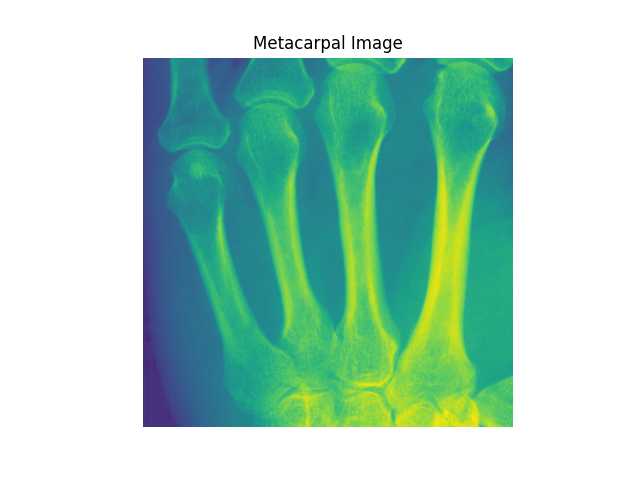

In [4]:
# Exercise 3
%matplotlib widget 
plt.imshow(im_org)
plt.title("Metacarpal Image")
plt.axis("off")
io.show()

### Color Maps

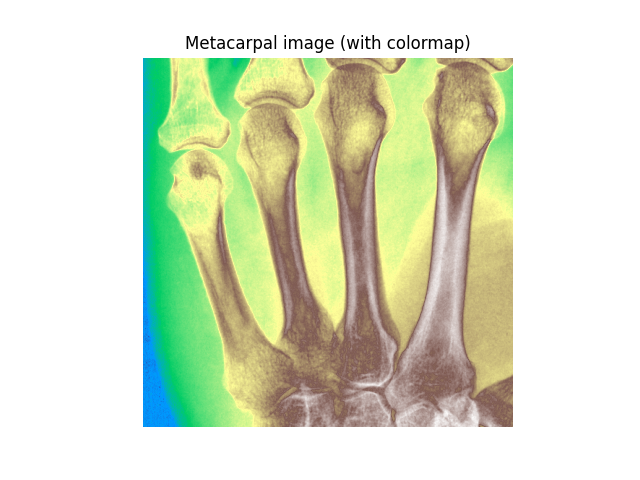

In [5]:
# Exercise 4 
plt.figure()
plt.imshow(im_org, cmap="terrain")
plt.title('Metacarpal image (with colormap)')
plt.axis("off")
plt.show()

#cmaps = [cool, hot, pink, copper, coolwarm, cubehelix, terrain , jet]

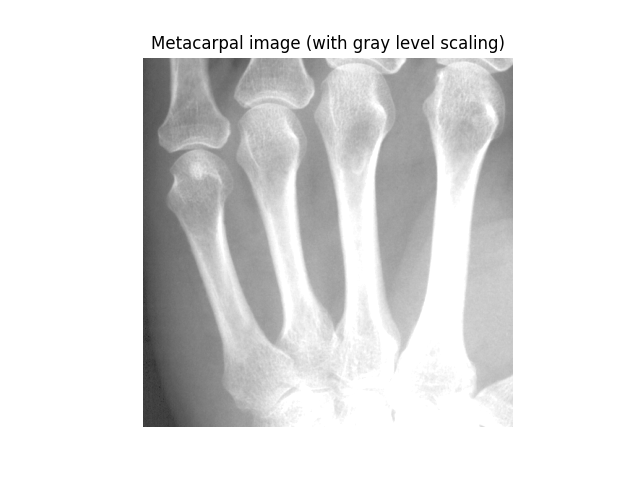

In [6]:
# Exercise 5
plt.figure()
plt.imshow(im_org, vmin=20, vmax=170, cmap = "gray")
plt.title('Metacarpal image (with gray level scaling)')
plt.axis("off")
plt.show()

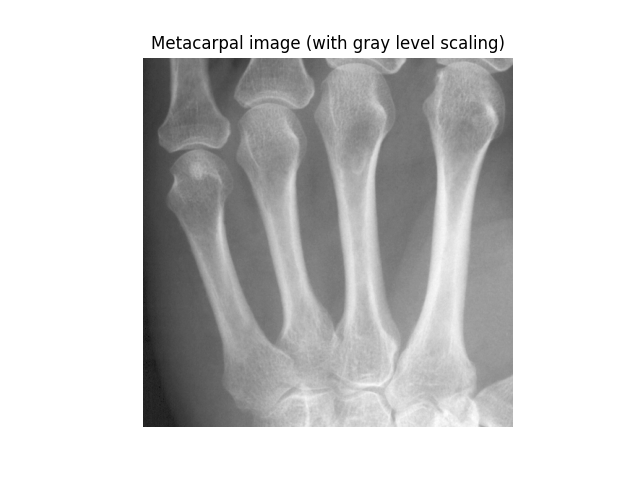

In [7]:
# Exercise 6
plt.figure()
plt.imshow(im_org, vmin=np.min(im_org), vmax=np.max(im_org), cmap = "gray")
plt.title('Metacarpal image (with gray level scaling)')
plt.axis("off")
plt.show()


### Histogram functions

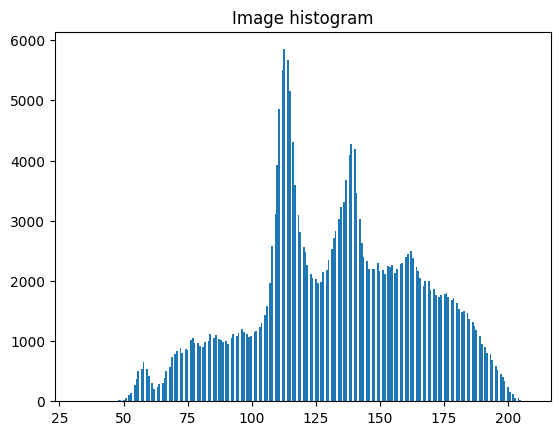

There are 1147.0 pixel values in bin 100
Bin edges: 100.75 to 101.4375


In [8]:
# Exercise 7 
%matplotlib inline 
h = plt.hist(im_org.ravel(), bins=256)
plt.title('Image histogram')
plt.show()

bin_no = 100
count = h[0][bin_no]
print(f"There are {count} pixel values in bin {bin_no}")

bin_left = h[1][bin_no]
bin_right = h[1][bin_no + 1]
print(f"Bin edges: {bin_left} to {bin_right}")

Max count: 5848.0 at: 117


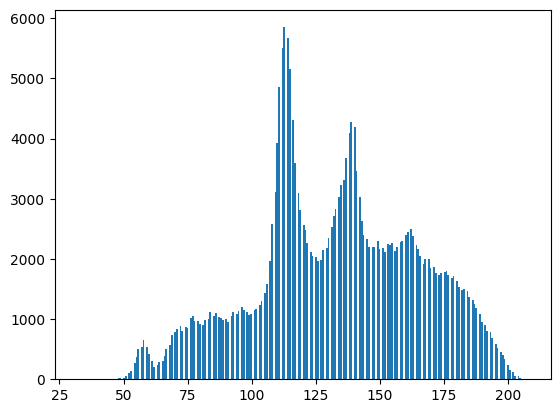

In [9]:
# Exercise 8 
y, x, _ = plt.hist(im_org.ravel(), bins=256)
max_count = y.max()
max_at = y.argmax()
print(f"Max count: {max_count} at: {max_at}")

### Pixel values and image coordinate systems

In [10]:
# Exercise 9 
r = 110
c = 90 
im_val = im_org[r, c]
print(f"The pixel value at (r,c) = ({r}, {c}) is: {im_val}")

The pixel value at (r,c) = (110, 90) is: 120


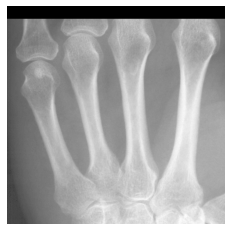

In [11]:
# Exercise 10 
im_org[:30] = 0 
plt.imshow(im_org, cmap = "gray")
plt.axis("off")
plt.show()

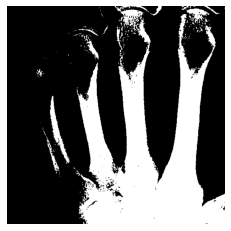

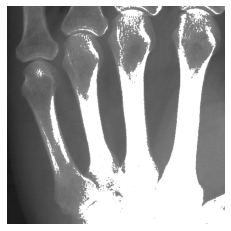

In [12]:
# Exercise 11
im_org = io.imread(in_dir + im_name)
mask = im_org > 150
plt.imshow(mask, cmap = "gray")
plt.axis("off")
plt.show()

im_org[mask] = 255
plt.imshow(im_org, cmap = "gray")
plt.axis("off")
plt.show()

### Color images

In [11]:
# Exercise 12
im_rgb = io.imread(in_dir + "ardeche.jpg")
print(f"image dimensions: {im_rgb.shape}")
print(f"image pixel type: {im_rgb.dtype}")

image dimensions: (600, 800, 3)
image pixel type: uint8


rgb code at row = 110 and column = 90: [119 178 238]


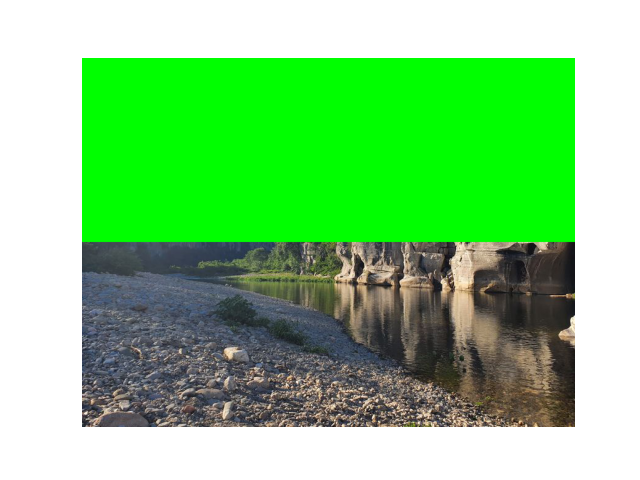

In [12]:
# Exercise 13
print(f"rgb code at row = 110 and column = 90: {im_rgb[110, 90]}")
im_rgb[:300] = [0, 255, 0]

plt.figure()
plt.imshow(im_rgb)
plt.axis("off")
plt.show()

### Working with your own image

original image dimensions: (600, 800, 3)
new image dimensions: (150, 200, 3)


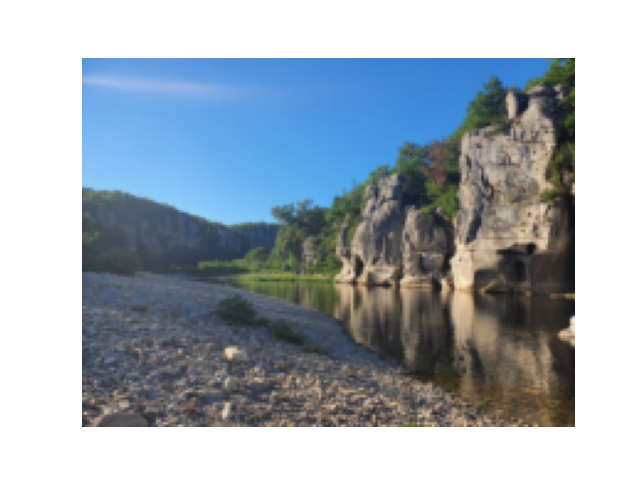

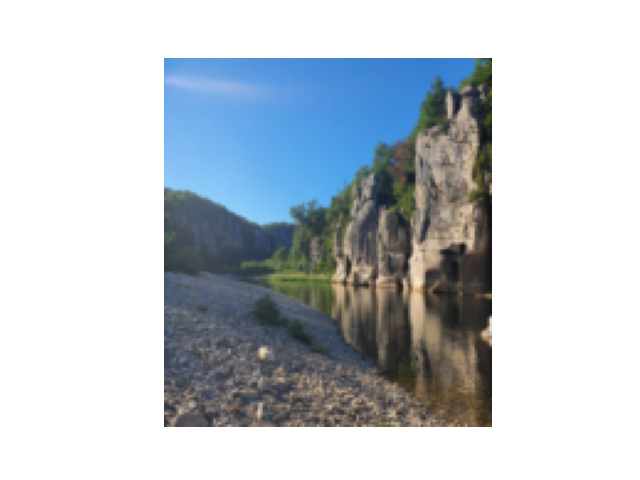

In [13]:
# Exercise 14
%matplotlib widget 
im_org = io.imread(in_dir + "ardeche.jpg")
print(f"original image dimensions: {im_rgb.shape}")

im_rescaled = rescale(im_org, 0.25, anti_aliasing=True, channel_axis=2)
print(f"new image dimensions: {im_rescaled.shape}")

plt.figure()
plt.imshow(im_rescaled)
plt.axis("off")
plt.show()

# now values are in range [0, 1]

im_resized = resize(im_org, (im_org.shape[0] // 4, im_org.shape[1] // 6), anti_aliasing=True)

plt.figure()
plt.imshow(im_resized)
plt.axis("off")
plt.show()


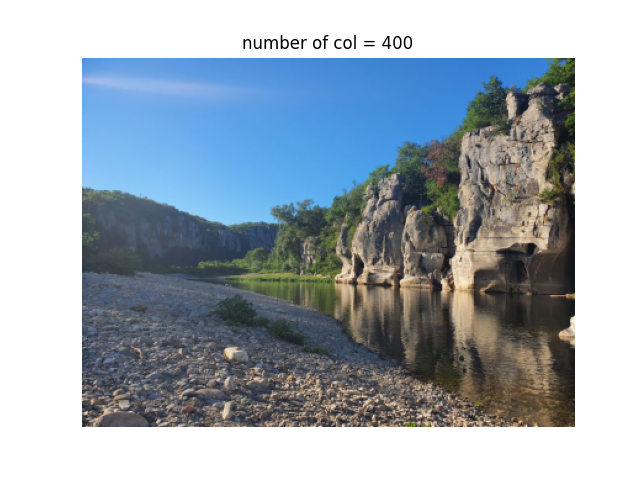

In [14]:
# Exercise 15 
nr_col = im_org.shape[1]
scale_factor = 400 / nr_col

im_400 = rescale(im_org, scale_factor, anti_aliasing=True, channel_axis=2)
plt.figure()
plt.imshow(im_400)
plt.title(f"number of col = {im_400.shape[1]}")
plt.axis("off")
plt.show()

In [15]:
# Exercise 16 
im_gray = color.rgb2gray(im_org)
im_byte = img_as_ubyte(im_gray)


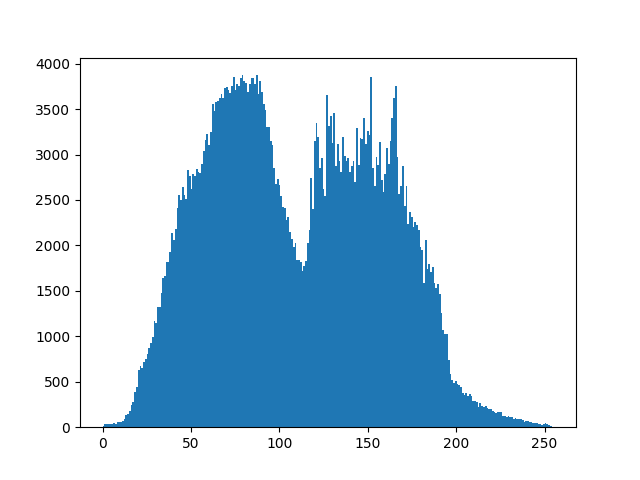

data type im_byte: uint8
data type im_gray: float64


In [16]:
# Exercise 17 
plt.figure()
plt.hist(im_byte.ravel(), bins = 256)
plt.show()

print(f"data type im_byte: {im_byte.dtype}")
print(f"data type im_gray: {im_gray.dtype}")

In [ ]:
# Exercise 18 


### Color channels

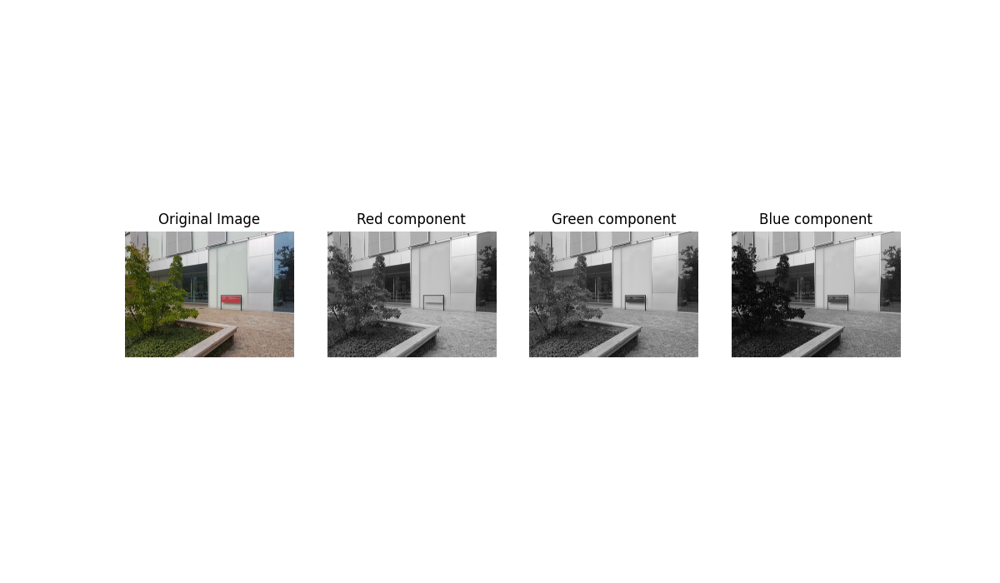

In [17]:
DTU_sign = io.imread(in_dir + "DTUSign1.jpg")
r_comp = DTU_sign[:, :, 0]
g_comp = DTU_sign[:, :, 1]
b_comp = DTU_sign[:, :, 2]


fig, ax = plt.subplots(1, 4, figsize = (12, 7))
ax[0].imshow(DTU_sign)
ax[0].axis("off")
ax[0].set_title("Original Image")
ax[1].imshow(r_comp, cmap = "gray")
ax[1].axis("off")
ax[1].set_title("Red component")
ax[2].imshow(g_comp, cmap = "gray")
ax[2].axis("off")
ax[2].set_title("Green component")
ax[3].imshow(b_comp, cmap = "gray")
ax[3].axis("off")
ax[3].set_title("Blue component")
plt.show()

### Simple Image manipulations

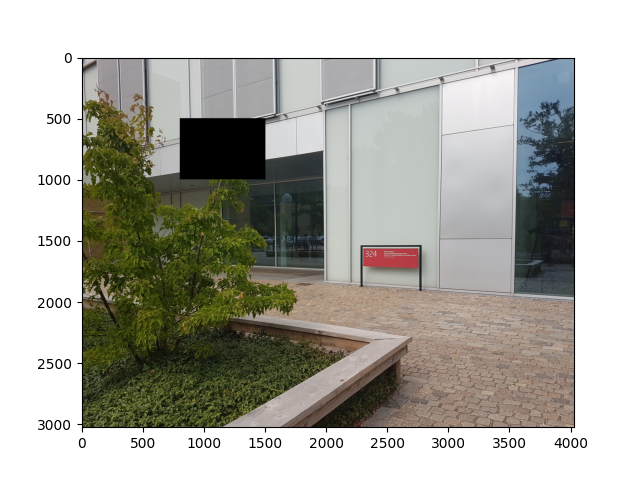

In [18]:
# Exercise 20 
%matplotlib widget 
DTU_sign[500:1000, 800:1500, :] = 0

plt.figure()
plt.imshow(DTU_sign)
plt.show()

# io.imsave("DTUSign1-marked.jpg", DTU_sign)

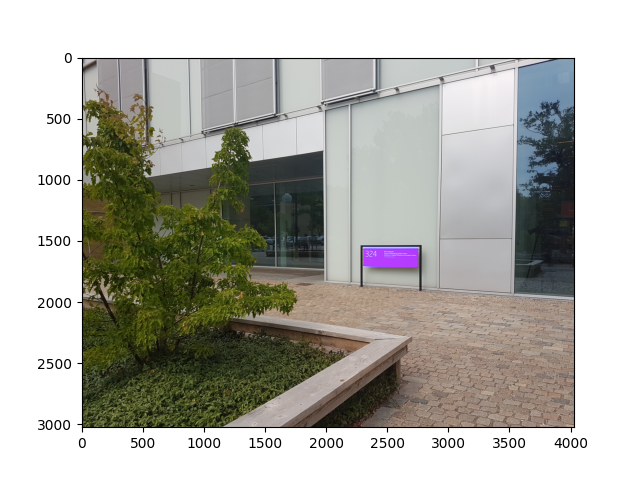

In [19]:
# Exercise 21
DTU_sign = io.imread(in_dir + "DTUSign1.jpg")

# [1550, 1700]
# [2300, 2700]
DTU_sign[1550:1720, 2300:2750, 2] = 255

plt.figure()
plt.imshow(DTU_sign)
plt.show()

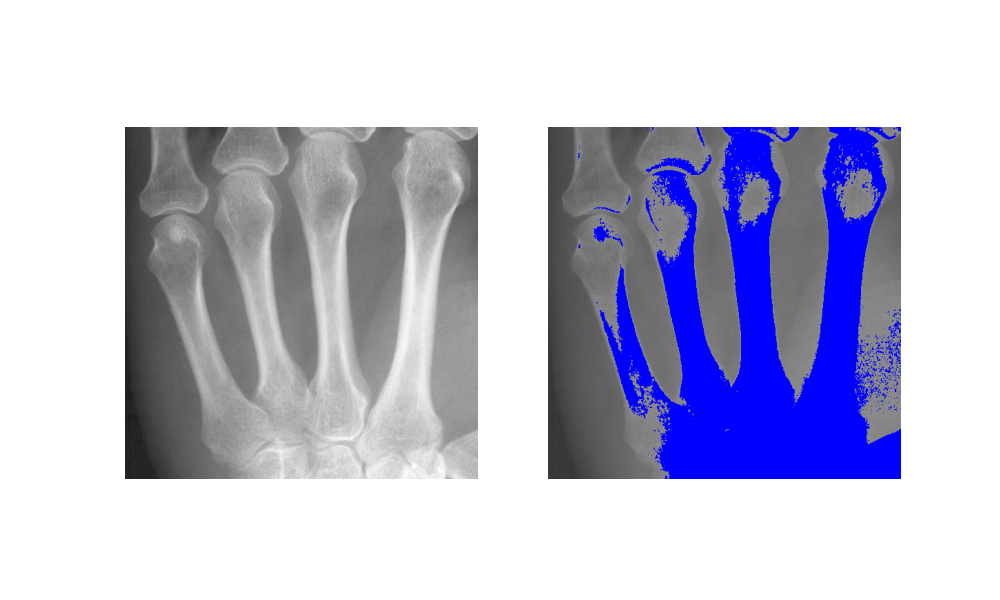

In [20]:
# Exercise 22
metacarpals_orig = io.imread(in_dir + "metacarpals.png")
metacarpals = color.gray2rgb(io.imread(in_dir + "metacarpals.png"))
metacarpals[metacarpals_orig > 140] = [0, 0, 255]
fig, ax = plt.subplots(1, 2, figsize = (10, 6))
ax[0].imshow(metacarpals_orig, cmap = "gray")
ax[0].axis("off")
ax[1].imshow(metacarpals)
ax[1].axis("off")
plt.show()

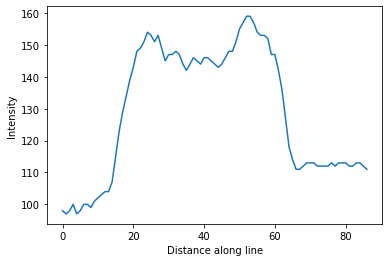

In [14]:
# Exercise 23 
%matplotlib inline 
im_org = io.imread("data_1/metacarpals.png")
p = profile_line(im_org, (342, 77), (320, 160))
plt.plot(p)
plt.ylabel('Intensity')
plt.xlabel('Distance along line')
plt.show()

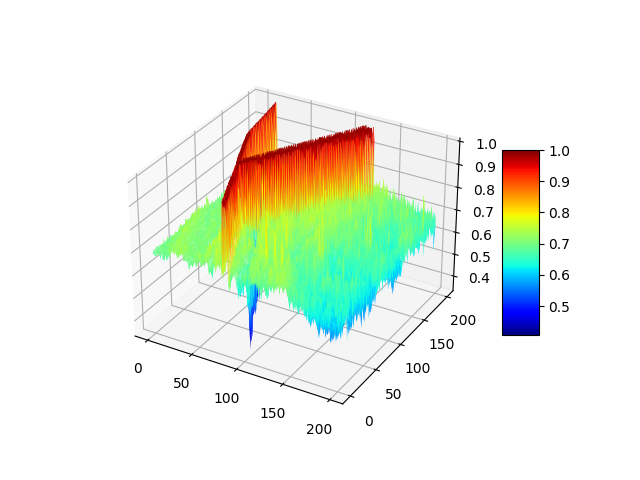

In [21]:
# Exercise 24
in_dir = "data_1/"
im_name = "road.png"
im_org = io.imread(in_dir + im_name)
im_gray = color.rgb2gray(im_org)
ll = 200
im_crop = im_gray[40:40 + ll, 150:150 + ll]
xx, yy = np.mgrid[0:im_crop.shape[0], 0:im_crop.shape[1]]
fig, ax = plt.subplots(subplot_kw={"projection": "3d"})
surf = ax.plot_surface(xx, yy, im_crop, rstride=1, cstride=1, cmap=plt.cm.jet,
linewidth=0)
fig.colorbar(surf, shrink=0.5, aspect=5)
plt.show()

### DICOM Images

In [28]:
# Exercise 25
in_dir = "data_1/"
im_name = "1-442.dcm"
ds = dicom.dcmread(in_dir + im_name)
print(ds.Rows)
print(ds.Columns)

512
512


In [29]:
# Exercise 26
im = ds.pixel_array
im.dtype 

dtype('int16')

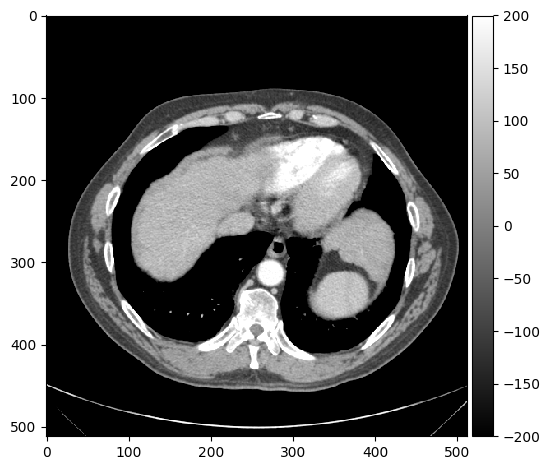

In [33]:
# Exercise 27
%matplotlib inline 
io.imshow(im, vmin=-200, vmax=200, cmap='gray')
io.show()


In [2]:
import numpy as np 
import seaborn as sns
import pandas as pd
from matplotlib import pyplot as plt 
from sklearn import decomposition

### Getting the Data 

In [3]:
# Exercise 1
iris_data = np.loadtxt("data_1b/irisdata.txt", comments="%")
x = iris_data[0:50, 0:4]

n_feat = x.shape[1]
n_obs = x.shape[0]
print(f"Number of features: {n_feat} and number of observations: {n_obs}")


Number of features: 4 and number of observations: 50


### Explorative Data Analysis

In [7]:
# Exercise 2
sep_l = x[:, 0]
sep_w = x[:, 1]
pet_l = x[:, 2]
pet_w = x[:, 3]

var_sep_l = sep_l.var(ddof = 1)
var_sep_w = sep_w.var(ddof = 1)
var_pet_l = pet_l.var(ddof = 1)
var_pet_w = pet_w.var(ddof = 1)


In [6]:
# Exercise 3
cov_sep_l_w = 1 / (n_obs - 1) * np.dot(sep_l - np.mean(sep_l), sep_w - np.mean(sep_w))
cov_pet_l_w = 1 / (n_obs - 1) * np.dot(pet_l - np.mean(pet_l), pet_w - np.mean(pet_w))

print(f"Covariance between width and length of sepals: {cov_sep_l_w}")
print(f"Covariance between width and length of petals: {cov_pet_l_w}")

Covariance between width and length of sepals: 0.09921632653061223
Covariance between width and length of petals: 0.0060693877551020415


<Figure size 640x480 with 0 Axes>

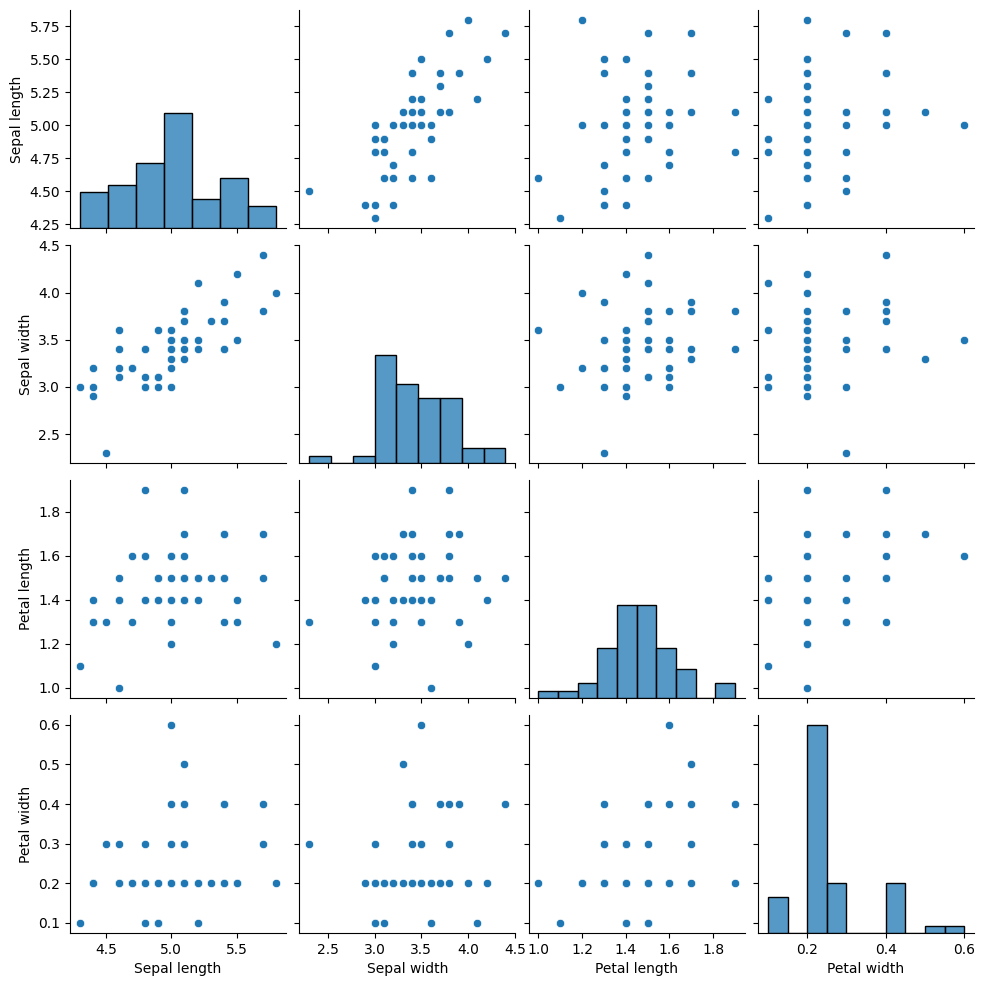

In [8]:
# Exericse 4
plt.figure() # Added this to make sure that the figure appear
# Transform the data into a Pandas dataframe
d = pd.DataFrame(x, columns=['Sepal length', 'Sepal width',
'Petal length', 'Petal width'])
sns.pairplot(d)
plt.show()

### PCA Analysis

In [10]:
# Exercise 5
mn = np.mean(x, axis=0)
data = x - mn
c_x = 1 / (50 - 1) * data.T @ data 
print(c_x)
print(np.cov(x.T))

[[0.12424898 0.09921633 0.0163551  0.01033061]
 [0.09921633 0.1436898  0.01169796 0.00929796]
 [0.0163551  0.01169796 0.03015918 0.00606939]
 [0.01033061 0.00929796 0.00606939 0.01110612]]
[[0.12424898 0.09921633 0.0163551  0.01033061]
 [0.09921633 0.1436898  0.01169796 0.00929796]
 [0.0163551  0.01169796 0.03015918 0.00606939]
 [0.01033061 0.00929796 0.00606939 0.01110612]]


In [11]:
# Exercise 6
values, vectors = np.linalg.eig(c_x)

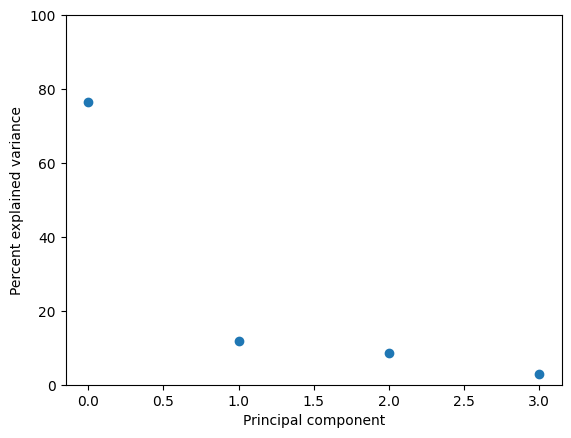

In [12]:
# Exercise 7 
v_norm = values / values.sum() * 100
plt.plot(v_norm, 'o')
plt.xlabel('Principal component')
plt.ylabel('Percent explained variance')
plt.ylim([0, 100])
plt.show()

<Figure size 640x480 with 0 Axes>

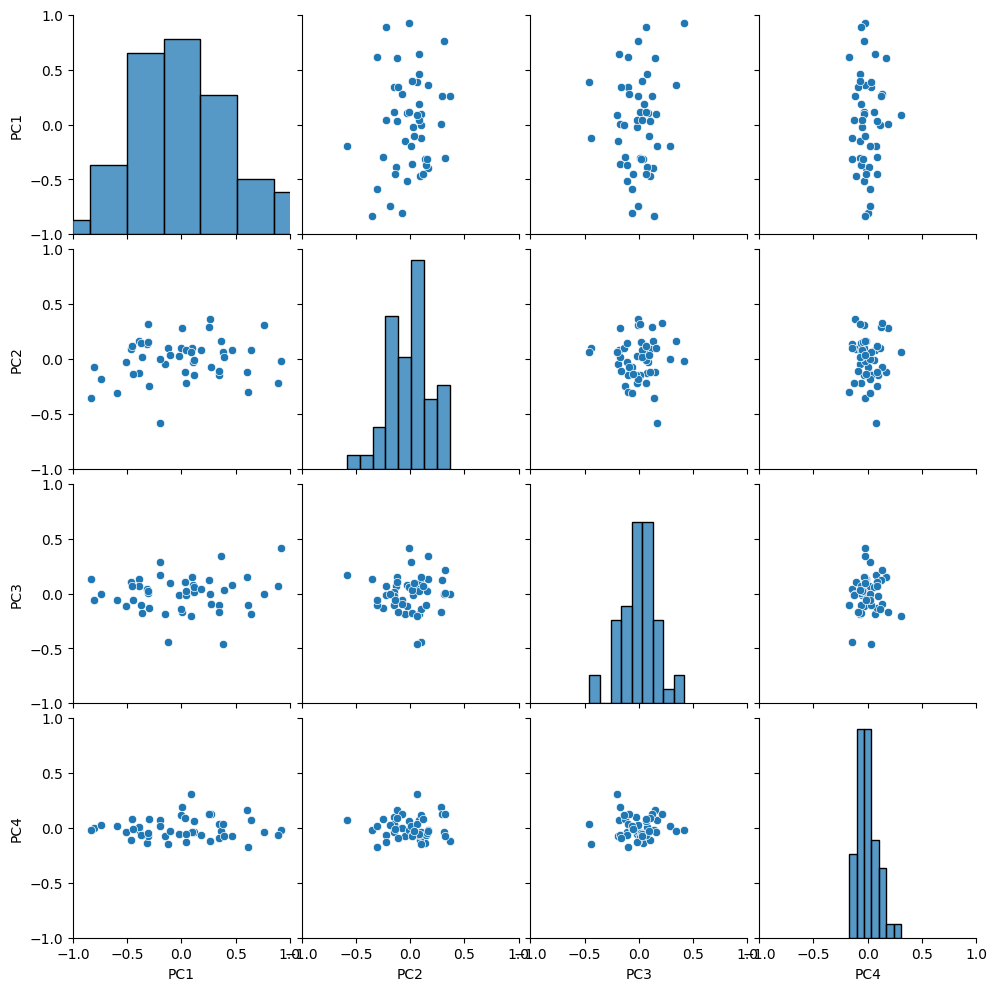

In [14]:
# Exercise 8 
pc_proj = vectors.T.dot(data.T)
plt.figure() 
d = pd.DataFrame(pc_proj.T, columns=['PC1', 'PC2','PC3', 'PC4'])
plot = sns.pairplot(d)
plot.set(xlim = (-1, 1), ylim = (-1, 1))
plt.show()

<Figure size 640x480 with 0 Axes>

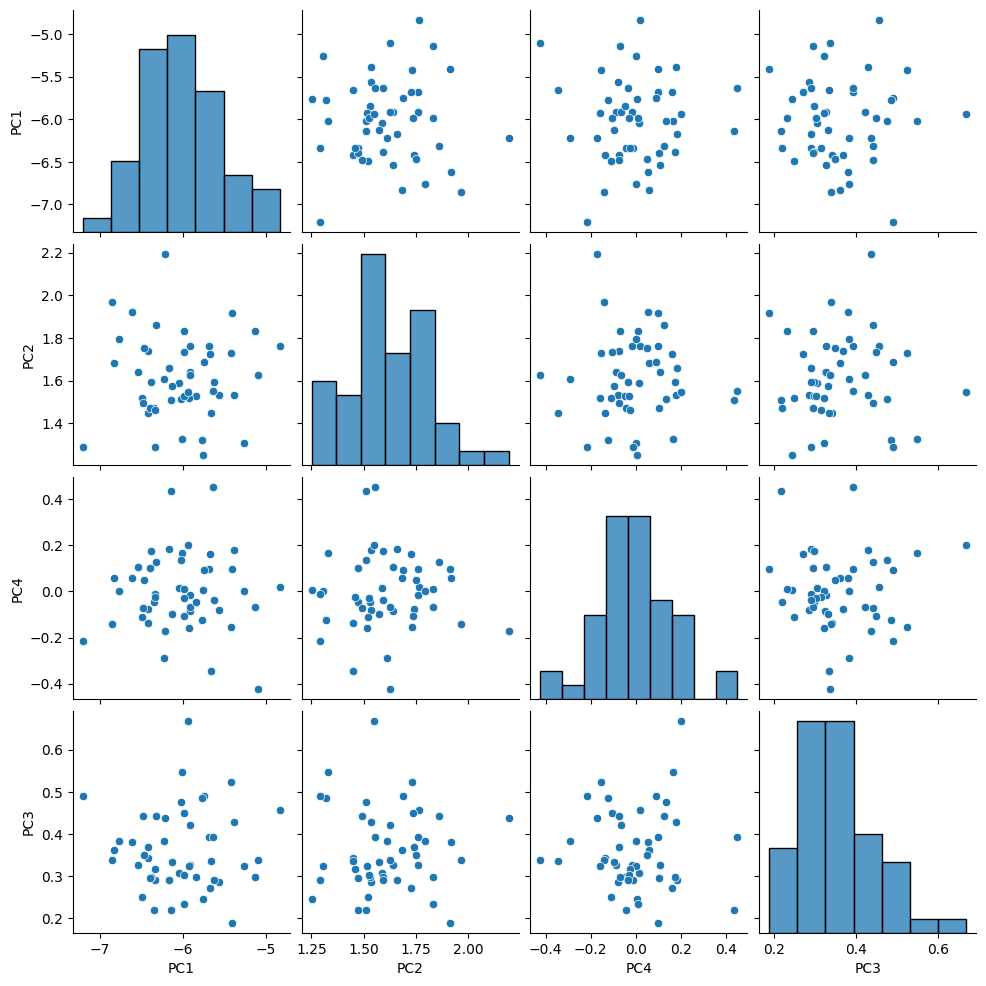

In [15]:
# Exercise 9 
pca = decomposition.PCA()
pca.fit(x)
values_pca = pca.explained_variance_
exp_var_ratio = pca.explained_variance_ratio_
vectors_pca = pca.components_
data_transform = pca.transform(data)

plt.figure() 
d = pd.DataFrame(data_transform, columns=['PC1', 'PC2',
'PC4', 'PC3'])
sns.pairplot(d)
plt.show()

In [16]:
print(vectors)
print(vectors_pca)

[[ 0.6690784   0.59788401  0.43996277 -0.03607712]
 [ 0.73414783 -0.62067342 -0.27460747 -0.01955027]
 [ 0.0965439   0.49005559 -0.8324495  -0.23990129]
 [ 0.06356359  0.13093791 -0.19506751  0.96992969]]
[[ 0.6690784   0.73414783  0.0965439   0.06356359]
 [-0.59788401  0.62067342 -0.49005559 -0.13093791]
 [-0.43996277  0.27460747  0.8324495   0.19506751]
 [-0.03607712 -0.01955027 -0.23990129  0.96992969]]


In [1]:
import math 
import numpy as np 

### Computing Camera Parameters

In [4]:
# Exercise 1
# tan(v) = modstående katete / hosliggende katete 

a = 10
b = 3
v_rad = math.atan2(b, a)
v_deg = v_rad * 180 / math.pi 
print(f"theta is {v_deg} degrees")

theta is 16.69924423399362 degrees


In [2]:
# Exercise 2
def camera_b_distance(f, g): 
    """
    camera_b_distance returns the distance (b) where the CCD should be placed
    when the object distance (g) and the focal length (f) are given
    inputs :
        f: Focal length
        g: Object distance
    output:
        b, the distance where the CCD should be placed
    """
    return 1/(1 / f - 1 / g)

f = 15 / 1000
g = np.array([0.1, 1, 5, 15]) 

b = camera_b_distance(f, g)
print(f"The distances are {b[0]}, {b[1]}, {b[2]}, {b[3]} m")

The distances are 0.01764705882352941, 0.015228426395939085, 0.015045135406218655, 0.015015015015015013 m


In [5]:
# Exercise 3
# 1 
g = 5
f = 5 / 1000 
b = camera_b_distance(f, g)
print(f"The image is formed at a distance {b} m from the lense")

#2
G = 1.8
B = b * G / g 
print(f"Thomas will be {B * 1000} mm tall on the CCD chip")

# 3
pix_size = 4.8 /480
print(f"The size of a single pixel is {pix_size} mm")

# 4
print(f"The heigh of Thomas in pixels will be {(B*1000)/pix_size}")

# 5
HOV_field = math.atan2(3.2e-3, f) * 2 * 180 / math.pi
print(f"Horisontal field of view is {HOV_field} degrees")

# 6
VER_field = math.atan2(2.4e-3, f) * 2 * 180 / math.pi 
print(f"Vertical field of view is {VER_field} degrees")



The image is formed at a distance 0.005005005005005005 m from the lense
Thomas will be 1.8018018018018018 mm tall on the CCD chip
The size of a single pixel is 0.01 mm
The heigh of Thomas in pixels will be 180.18018018018017
Horisontal field of view is 65.23848614238565 degrees
Vertical field of view is 51.28201164861056 degrees


# Exercise 3 - Pixel wise operations

**TA comment**: The visualization of the images can be done through different Python libraries, such as` matplotlib` or `skimage`. Although similar, they may have different default behaviour. In this solution, `matplotlib` is used.

Be aware that default behaviour of `matplotlib.pyplot.imshow()` is to use the dynamic range of the image values to plot the image. It is, if the image intensities range from [26, 173], the white color is assigned to 26 and the black to 173. Meanwhile, `skimage.io.imshow()` displays the dynamic range according to the image type, [0, 255] for integer images and [0., 1.] for float images.

In [1]:
from skimage import io
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline

## Explorative data analysis

### Exercise 1
Start by reading the image and inspect the histogram. Is it a bimodal histogram? Do you think it will be possible to segment it so only the bones are visible?

In [2]:
# Directory containing data and images
in_dir = "data/"
im_name = "vertebra.png"
im_org = io.imread(in_dir + im_name)

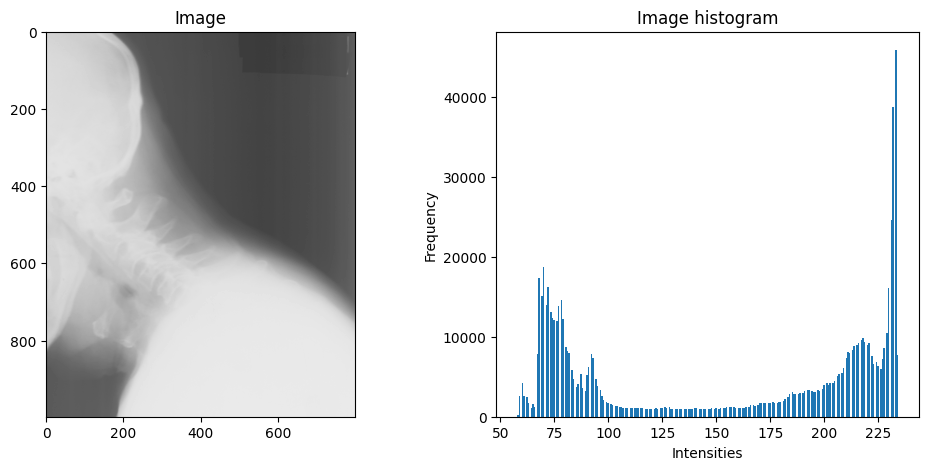

In [3]:
nbins = 256

fig, ax = plt.subplots(nrows=1, ncols = 2, figsize = (12, 5))
ax[0].imshow(im_org, cmap = 'gray', vmin = 0, vmax = 255)
ax[0].set_title('Image')

ax[1].hist(im_org.ravel(), bins=nbins)
ax[1].set_title('Image histogram')
ax[1].set_xlabel('Intensities')
ax[1].set_ylabel('Frequency')
plt.show()

### Exercise 2
Compute the minimum and maximum values of the image. Is the full scale of the gray-scale spectrum used or can we enhance the appearance of the image?

In [4]:
min, max = im_org.min(), im_org.max()
print(f"Min value: {min} \t Max value: {max}")

Min value: 57 	 Max value: 235


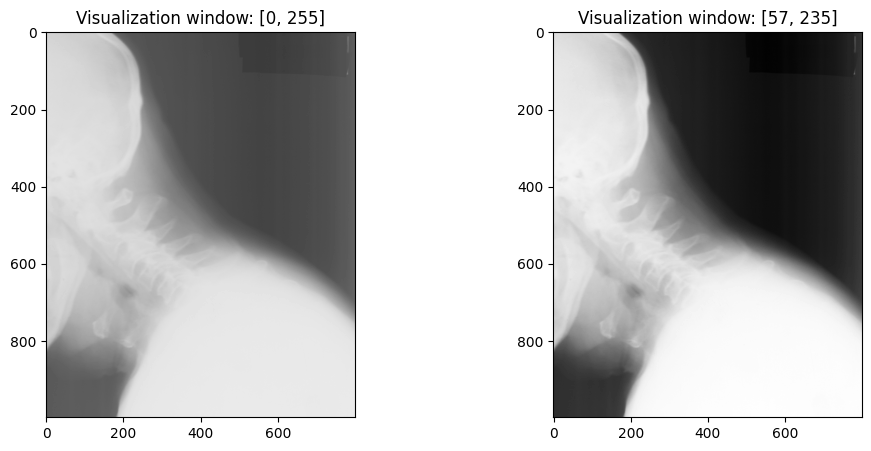

In [5]:
fig, ax = plt.subplots(nrows=1, ncols = 2, figsize = (12, 5))
ax[0].imshow(im_org, vmin = 0, vmax = 255, cmap = 'gray')
ax[0].set_title('Visualization window: [0, 255]')
ax[1].imshow(im_org, vmin = min, vmax = max, cmap = 'gray')
ax[1].set_title(f'Visualization window: [{min}, {max}]')
plt.show()

## Pixel type conversions

### Exercise 3 - Unsigned byte to float image

In [6]:
from skimage.util import img_as_float
from skimage.util import img_as_ubyte

In [7]:
im_float = img_as_float(im_org)
min, max = im_float.min(), im_float.max()
print(f"Min value: {min} \t Max value: {max}")

 # Can you verify that the float image is equal to the original image, where each pixel value is divided by 255?
all_equal = np.allclose(im_org, im_float*255)
print(f'The float and the original image are equivalent?: {all_equal}')

Min value: 0.22352941176470587 	 Max value: 0.9215686274509803
The float and the original image are equivalent?: True


### Exercise 4 - Float to unsigned byte

In [8]:
im_ubyte = img_as_ubyte(im_float)
min, max = im_ubyte.min(), im_ubyte.max()
print(f"Min value: {min} \t Max value: {max}")

Min value: 57 	 Max value: 235


## Histogram stretching

### Exercise 5

In [9]:
def histogram_stretch(img_in):
    """
    Stretches the histogram of an image 
    :param img_in: Input image
    :return: Image, where the histogram is stretched so the min values is 0 and the maximum value 255
    """
    # img_as_float will divide all pixel values with 255.0
    img_float = img_as_float(img_in)
    min_val = img_float.min()
    max_val = img_float.max()
    min_desired = 0.0
    max_desired = 1.0
	
    # Do something here
    img_out = ((img_float-min_val)*(max_desired-min_desired)/(max_val-min_val))+min_desired
    # img_as_ubyte will multiply all pixel values with 255.0 before converting to unsigned byte
    return img_as_ubyte(img_out)

### Exercise 6

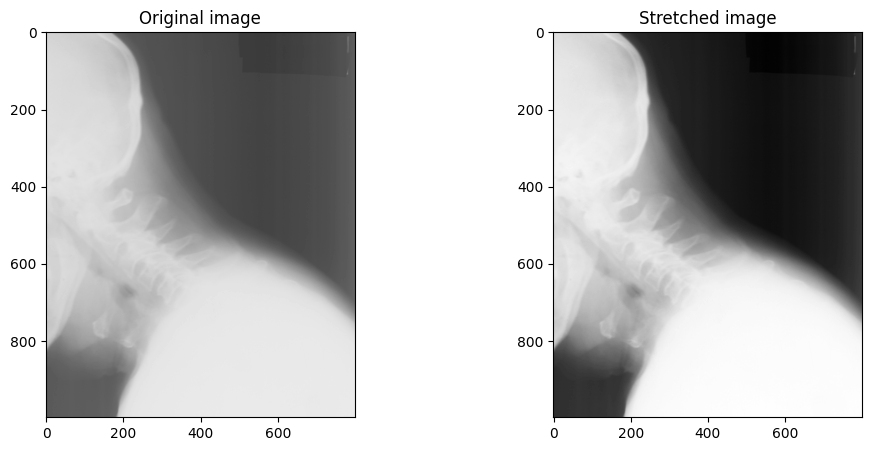

In [10]:
im_stretched = histogram_stretch(im_org)

fig, ax = plt.subplots(nrows=1, ncols = 2, figsize = (12, 5))
ax[0].imshow(im_org, cmap = 'gray', vmin = 0, vmax = 255)
ax[0].set_title('Original image')
ax[1].imshow(im_stretched, cmap = 'gray', vmin = 0, vmax = 255)
ax[1].set_title('Stretched image')
plt.show()

## Non-linear pixel value mapping

### Exercise 7

In [11]:
def gamma_map(img_in, gamma):
    """
    Stretches the histogram of an image 
    :param img_in: Input image
    :param gamma: Exponent
    :return: Gamma-mapped image
    """
    img_float = img_as_float(img_in)
    img_out = np.power(img_float, gamma)
    return img_as_ubyte(img_out)

### Exercise 8

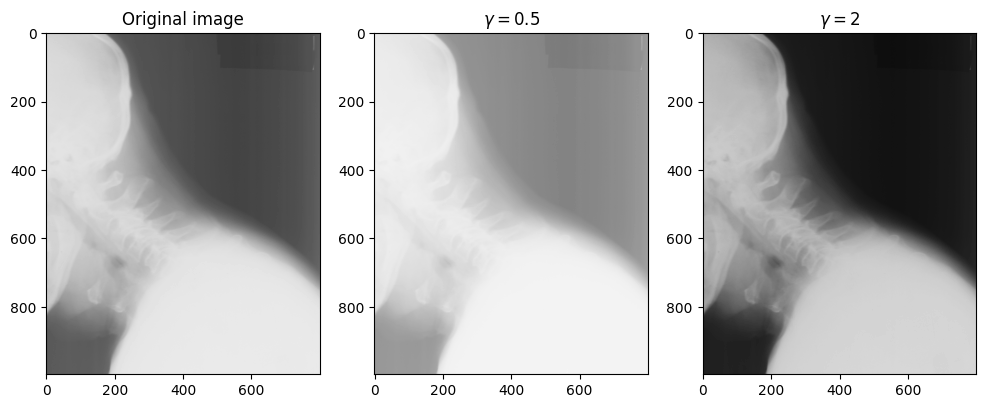

In [12]:
gamma_0_5 = gamma_map(im_org, 0.5)
gamma_2 = gamma_map(im_org, 2)

fig, ax = plt.subplots(nrows=1, ncols = 3, figsize = (12, 5))
ax[0].imshow(im_org, cmap = 'gray', vmin=0, vmax=255)
ax[0].set_title('Original image')
ax[1].imshow(gamma_0_5, cmap = 'gray', vmin=0, vmax=255)
ax[1].set_title(r'$\gamma = 0.5$')
ax[2].imshow(gamma_2, cmap = 'gray', vmin=0, vmax=255)
ax[2].set_title(r'$\gamma = 2$')
plt.show()

## Image segmentation by thresholding

### Exercise 9

In [13]:
def threshold_image(img_in, thres):
    """
    Apply a threshold in an image and return the resulting image
    :param img_in: Input image
    :param thres: The treshold value in the range [0, 255]
    :return: Resulting image (unsigned byte) where background is 0 and foreground is 255
    """
    mask = img_in > thres
    return img_as_ubyte(mask)

### Exercise 10

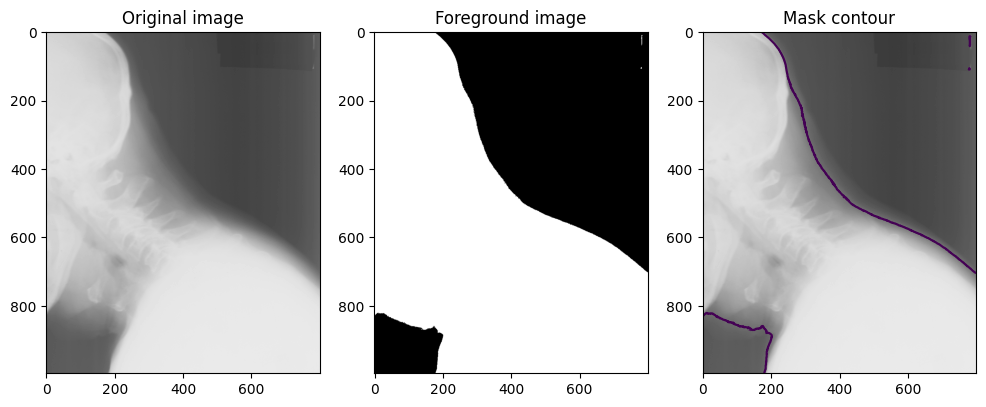

In [14]:
im_thres = threshold_image(im_org, thres = 110)

fig, ax = plt.subplots(nrows=1, ncols = 3, figsize = (12, 5))
ax[0].imshow(im_org, cmap = 'gray', vmin = 0, vmax = 255)
ax[0].set_title('Original image')
ax[1].imshow(im_thres, cmap = 'gray', vmin = 0, vmax = 255)
ax[1].set_title('Foreground image')
ax[2].imshow(im_org, cmap = 'gray', vmin = 0, vmax = 255)
ax[2].contour(im_thres, [254, 256])
ax[2].set_title('Mask contour')
plt.show()

### Exercise 11

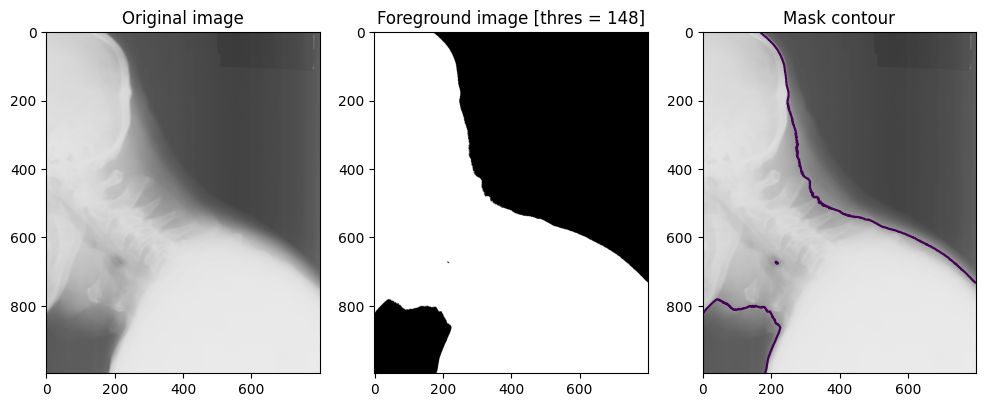

In [15]:
from skimage.filters import threshold_otsu

thres_new = threshold_otsu(im_org)
im_thres = threshold_image(im_org, thres = thres_new)

fig, ax = plt.subplots(nrows=1, ncols = 3, figsize = (12, 5))
ax[0].imshow(im_org, cmap = 'gray', vmin = 0, vmax = 255)
ax[0].set_title('Original image')
ax[1].imshow(im_thres, cmap = 'gray', vmin = 0, vmax = 255)
ax[1].set_title(f'Foreground image [thres = {thres_new}]')
ax[2].imshow(im_org, cmap = 'gray', vmin = 0, vmax = 255)
ax[2].contour(im_thres, [254, 256])
ax[2].set_title('Mask contour')
plt.show()

### Exercise 12

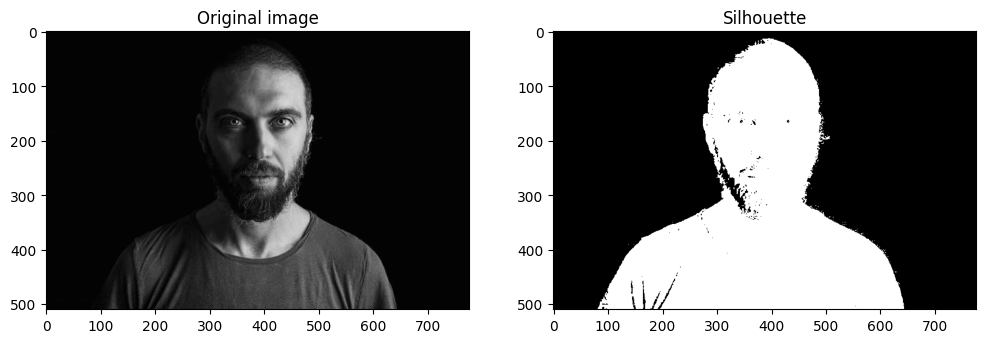

In [16]:
from skimage.color import rgb2gray

im_name = "dark_background.png"
im_org = io.imread(in_dir + im_name)

im_org = img_as_float(im_org)
im_gray = img_as_ubyte(rgb2gray(im_org))

thres = 5
im_thres = threshold_image(im_gray, thres = thres)

fig, ax = plt.subplots(nrows=1, ncols = 2, figsize = (12, 5))
ax[0].imshow(im_gray, cmap = 'gray', vmin = 0, vmax = 255)
ax[0].set_title('Original image')
ax[1].imshow(im_thres, cmap = 'gray', vmin = 0, vmax = 255)
ax[1].set_title(f'Silhouette')
plt.show()

## Color thresholding in the RGB color space

### Exercise 13

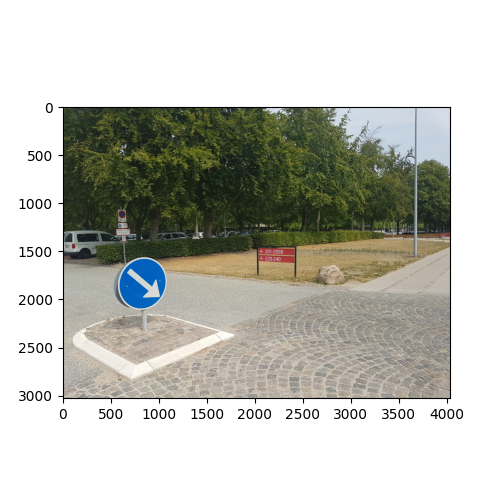

In [25]:
# Change the backend to be able to explore the pixel intensities
# For VSCode Notebooks and JupyterNotebook "%matplotlib widget"
# For Spyder "%matplotlib auto"

%matplotlib widget 

im_name = "DTUSigns2.jpg"
im_org = io.imread(in_dir + im_name)

fig, ax = plt.subplots(nrows = 1, ncols = 1, figsize = (5,5))
ax.imshow(im_org)
plt.show()

### Exercise 14

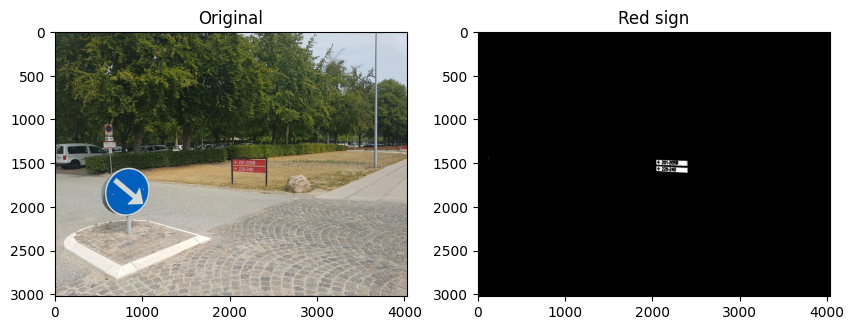

In [18]:
%matplotlib inline 

def detect_dtu_signs(img_in, sign):
    r_comp = img_in[:, :, 0]
    g_comp = img_in[:, :, 1]
    b_comp = img_in[:, :, 2]

    if sign == 'red':
        segm = (r_comp > 160) & (r_comp < 180) & (g_comp > 50) & (g_comp < 80) & \
                    (b_comp > 50) & (b_comp < 80)
    if sign == 'blue':
        segm = (r_comp < 10) & (g_comp > 85) & (g_comp < 105) & \
                    (b_comp > 180) & (b_comp < 200)

    return img_as_ubyte(segm)

img_red = detect_dtu_signs(im_org, 'red')
fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (10, 5))
ax[0].imshow(im_org)
ax[0].set_title('Original')
ax[1].imshow(img_red, vmin = 0, vmax = 255, cmap = 'gray')
ax[1].set_title('Red sign')
plt.show()

## Color thresholding in the HSV color space

### Exercise 15

In [19]:
from skimage import color

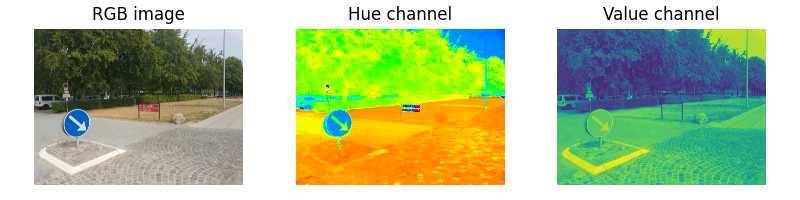

In [20]:
%matplotlib widget 

hsv_img = color.rgb2hsv(im_org)
hue_img = hsv_img[:, :, 0]
value_img = hsv_img[:, :, 2]
fig, (ax0, ax1, ax2) = plt.subplots(ncols=3, figsize=(8, 2))
ax0.imshow(im_org)
ax0.set_title("RGB image")
ax0.axis('off')
ax1.imshow(hue_img, cmap='hsv')
ax1.set_title("Hue channel")
ax1.axis('off')
ax2.imshow(value_img)
ax2.set_title("Value channel")
ax2.axis('off')

fig.tight_layout()
io.show()

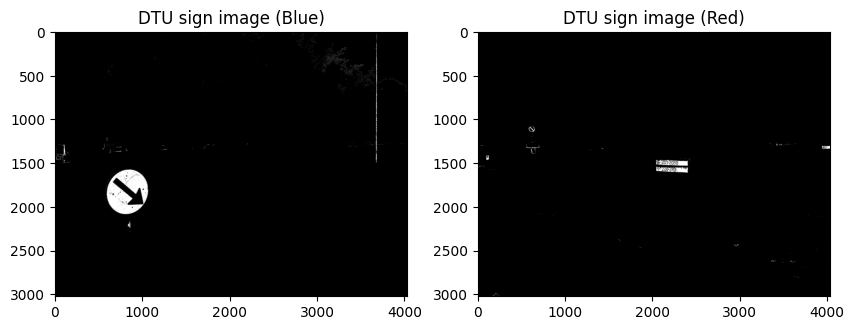

In [21]:
%matplotlib inline 

segm_blue = (hue_img < 0.6) & (hue_img  > 0.4) & (value_img < 0.77) & (value_img > 0.70)
segm_red = (hue_img < 1.0) & (hue_img  > 0.9)

fig, (ax1, ax2) = plt.subplots(1,2,figsize = (10,5))
ax1.imshow(segm_blue, cmap = 'gray')
ax1.set_title('DTU sign image (Blue)')

ax2.imshow(segm_red, cmap = 'gray')
ax2.set_title('DTU sign image (Red)')
plt.show()

## Real time pixel-wise operations on videos

### Exercise 16

In [22]:
!python Ex3-VideoPixelWiseOperations.py

Starting image capture
Opening connection to camera
Starting camera loop
Stopping image loop


### Exercise 17

In [23]:
!python Ex3-Ex17.py

Starting image capture
Opening connection to camera
Starting camera loop
Stopping image loop


### Exercise 18

In [24]:
!python Ex3-Ex18.py

Starting image capture
Opening connection to camera
Starting camera loop
Stopping image loop


# Exercise 4a - Image Filtering

In [1]:
from skimage import io
import matplotlib.pyplot as plt
import numpy as np

### Filtering using correlation

In [2]:
from scipy.ndimage import correlate
input_img = np.arange(25).reshape(5, 5)
print(input_img)

[[ 0  1  2  3  4]
 [ 5  6  7  8  9]
 [10 11 12 13 14]
 [15 16 17 18 19]
 [20 21 22 23 24]]


In [3]:
weights = [[0, 1, 0],
		   [1, 2, 1],
		   [0, 1, 0]]
           
res_img = correlate(input_img, weights)

#### Exercise 1

In [4]:
print(f"Full matrix: \n {res_img}")
print(f"Value (3, 3): \n {res_img[3, 3]}")

Full matrix: 
 [[  6  11  17  23  28]
 [ 31  36  42  48  53]
 [ 61  66  72  78  83]
 [ 91  96 102 108 113]
 [116 121 127 133 138]]
Value (3, 3): 
 108


### Border handling

#### Exercise 2

In [5]:
reflection_img = correlate(input_img, weights, mode='reflect')
constant_img = correlate(input_img, weights, mode='constant', cval = 10)

In [6]:
print(reflection_img)

[[  6  11  17  23  28]
 [ 31  36  42  48  53]
 [ 61  66  72  78  83]
 [ 91  96 102 108 113]
 [116 121 127 133 138]]


In [7]:
print(constant_img)

[[ 26  20  25  30  40]
 [ 36  36  42  48  54]
 [ 61  66  72  78  79]
 [ 86  96 102 108 104]
 [ 96 110 115 120 110]]


### Mean filtering

#### Exercise 3

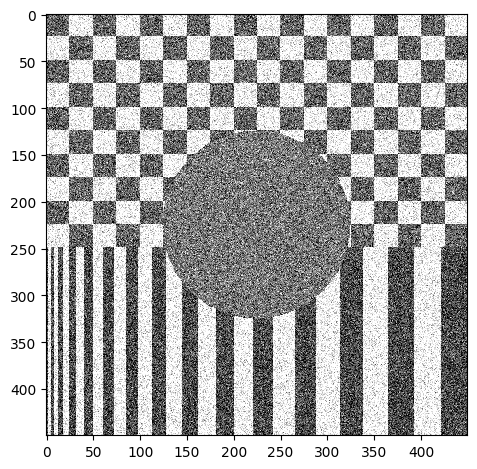

In [8]:
img_org = io.imread('data/Gaussian.png')

io.imshow(img_org)
io.show()

In [9]:
def apply_mean_filter(img, size):
    weights = np.ones([size, size])
    weights = weights / np.sum(weights)

    out_img = correlate(img, weights, mode='reflect')
    return out_img

In [10]:
gauss5 = apply_mean_filter(img_org, size = 5)
gauss10 = apply_mean_filter(img_org, size = 10)
gauss20 = apply_mean_filter(img_org, size = 20)
gauss40 = apply_mean_filter(img_org, size = 30)

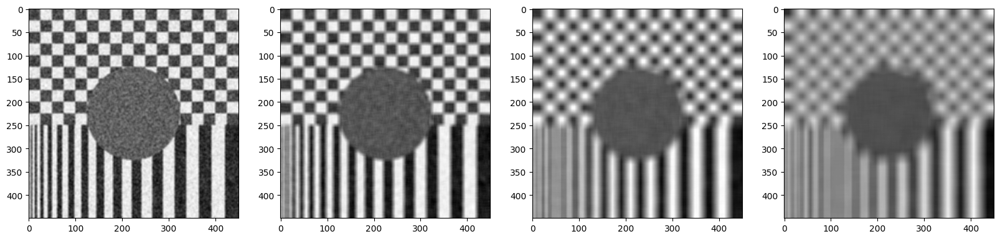

In [11]:
fig, ax = plt.subplots(nrows = 1, ncols = 4, figsize = (20, 5))
ax[0].imshow(gauss5, cmap = 'gray')
ax[1].imshow(gauss10, cmap = 'gray')
ax[2].imshow(gauss20, cmap = 'gray')
ax[3].imshow(gauss40, cmap = 'gray')
plt.show()

### Median filtering

#### Exercise 4

In [12]:
from skimage.filters import median

In [13]:
def apply_median_filter(img, size):
    footprint = np.ones([size, size])
    med_img = median(img, footprint)
    return med_img

In [14]:
median5 = apply_median_filter(img_org, size = 5)
median10 = apply_median_filter(img_org, size = 10)
median20 = apply_median_filter(img_org, size = 20)
median40 = apply_median_filter(img_org, size = 30)

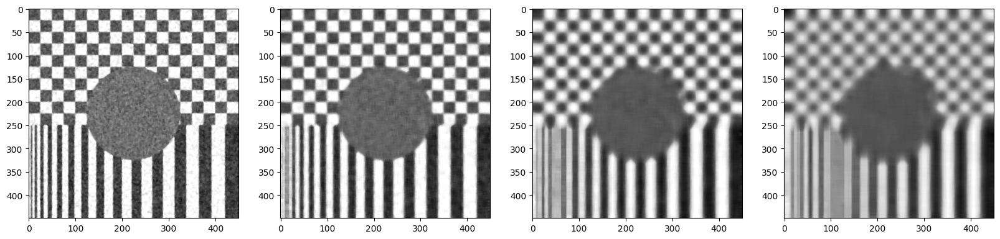

In [15]:
fig, ax = plt.subplots(nrows = 1, ncols = 4, figsize = (20, 5))
ax[0].imshow(median5, cmap = 'gray')
ax[1].imshow(median10, cmap = 'gray')
ax[2].imshow(median20, cmap = 'gray')
ax[3].imshow(median40, cmap = 'gray')
plt.show()

### Compare mean and median filtering

#### Exercise 5

In [16]:
img_org = io.imread('data/SaltPepper.png')
mean5 = apply_mean_filter(img_org, size = 5)
median5 = apply_median_filter(img_org, size = 5)
mean20 = apply_mean_filter(img_org, size =20)
median20 = apply_median_filter(img_org, size = 20)

In [ ]:
median20

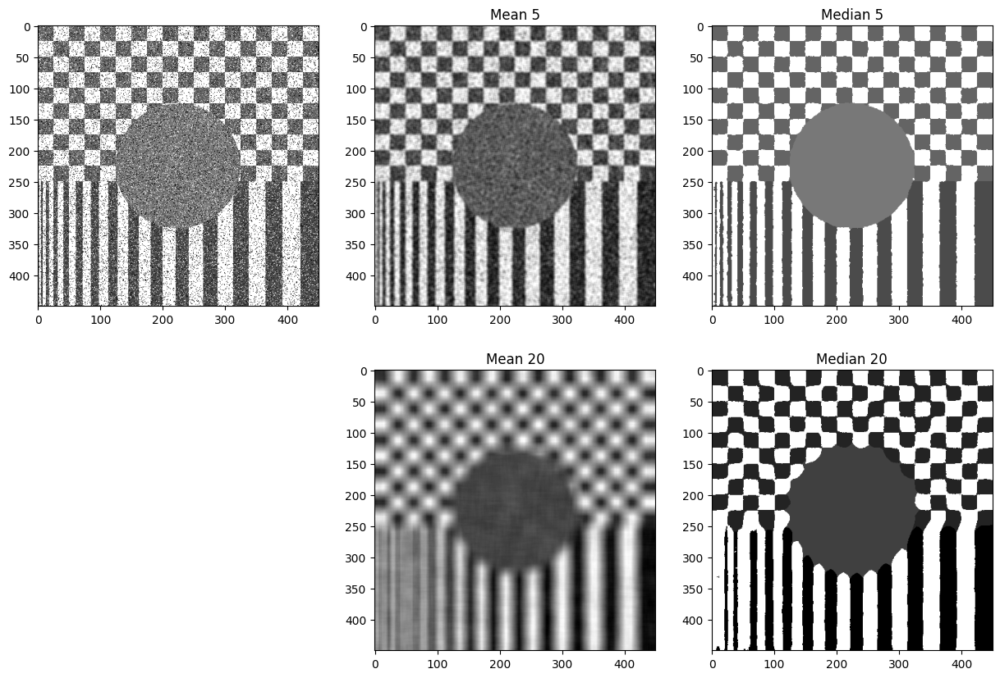

In [17]:
fig, ax = plt.subplots(nrows = 2, ncols = 3, figsize = (15, 10))
ax[0,0].imshow(img_org, cmap = 'gray')
ax[0,1].imshow(mean5, cmap = 'gray')
ax[0,1].set_title('Mean 5')
ax[0,2].imshow(median5, cmap = 'gray')
ax[0,2].set_title('Median 5')
ax[1,0].set_axis_off()
ax[1,1].imshow(mean20, cmap = 'gray')
ax[1,1].set_title('Mean 20')
ax[1,2].imshow(median20, cmap = 'gray')
ax[1, 2].set_title('Median 20')
plt.show()

### Gaussian filter

#### Exercise 6

In [18]:
from skimage.filters import gaussian

In [19]:
img_gauss = io.imread('data/Gaussian.png')

In [20]:
gauss1 = gaussian(img_gauss, 1)
gauss5 = gaussian(img_gauss, 5)
gauss10 = gaussian(img_gauss, 10)

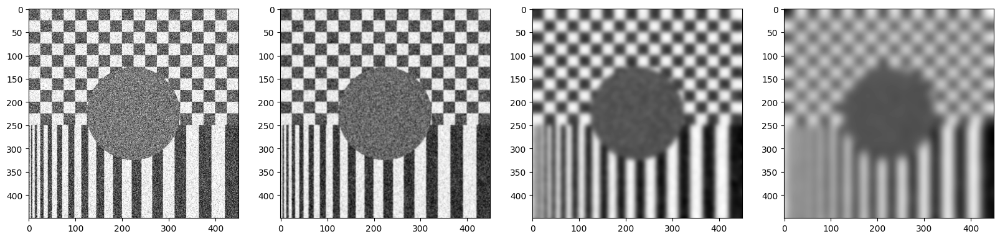

In [21]:
fig, ax = plt.subplots(nrows = 1, ncols = 4, figsize = (20, 5))
ax[0].imshow(img_gauss, cmap = 'gray')
ax[1].imshow(gauss1, cmap = 'gray')
ax[2].imshow(gauss5, cmap = 'gray')
ax[3].imshow(gauss10, cmap = 'gray')
plt.show()

#### Exercise 7

In [22]:
from skimage import color

In [23]:
car_img = io.imread('data/car.png')
car_gray = color.rgb2gray(car_img)

size = 10
car_mean = apply_mean_filter(car_gray, size)
car_median = apply_median_filter(car_gray, size)
car_gauss = gaussian(car_gray, size)

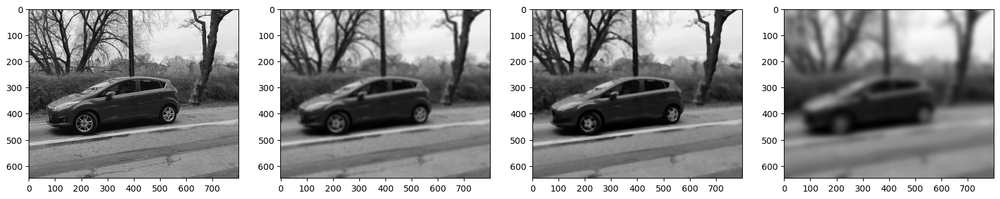

In [24]:
fig, ax = plt.subplots(nrows = 1, ncols = 4, figsize = (20, 5))
ax[0].imshow(car_gray, cmap = 'gray')
ax[1].imshow(car_mean, cmap = 'gray')
ax[2].imshow(car_median, cmap = 'gray')
ax[3].imshow(car_gauss, cmap = 'gray')
plt.show()

### Edge filters

In [25]:
from skimage.filters import prewitt_h
from skimage.filters import prewitt_v
from skimage.filters import prewitt

from skimage.util import img_as_ubyte, img_as_float

#### Exercise 8

In [26]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

In [27]:
img_org = io.imread('data/donald_1.png')
img_gray = color.rgb2gray(img_org)
img_h = prewitt_h(img_gray)
img_v = prewitt_v(img_gray)

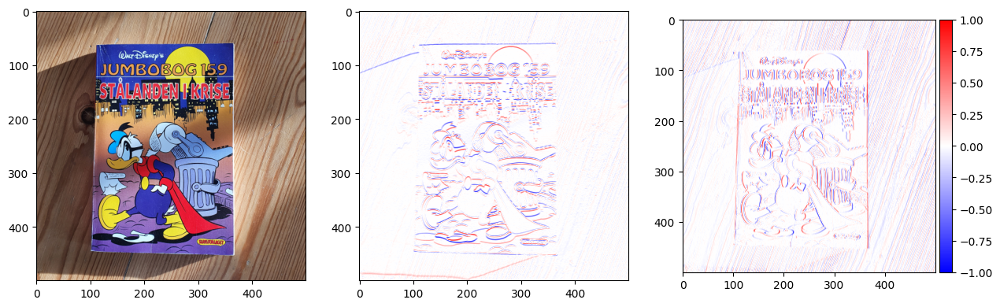

In [28]:
fig, ax = plt.subplots(nrows = 1, ncols = 3, figsize = (15, 5))
ax[0].imshow(img_org)
ax[1].imshow(img_h, cmap = 'bwr', vmin = -1, vmax = 1)

im = ax[2].imshow(img_v, cmap = 'bwr', vmin = -1, vmax = 1)
divider = make_axes_locatable(ax[2])
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(im, cax=cax)

plt.show()

#### Exercise 9

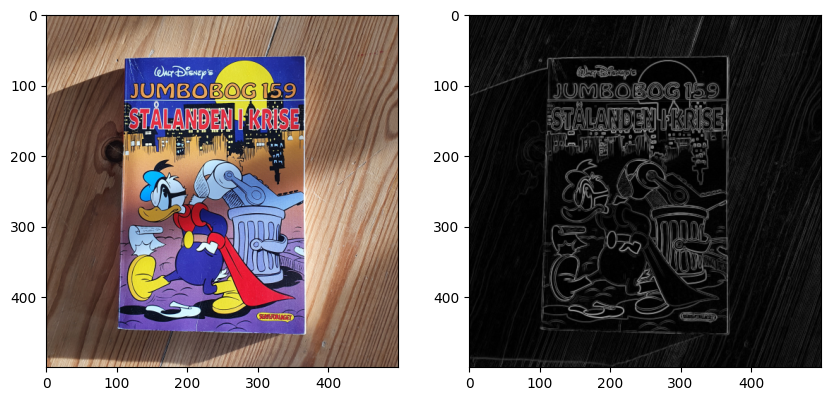

In [29]:
img_prewitt = prewitt(img_gray)
fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (10, 5))
ax[0].imshow(img_org)
ax[1].imshow(img_prewitt, cmap = 'gray', vmin = 0, vmax = 1)
plt.show()

### Edge detection in medical images

#### Exercise 10

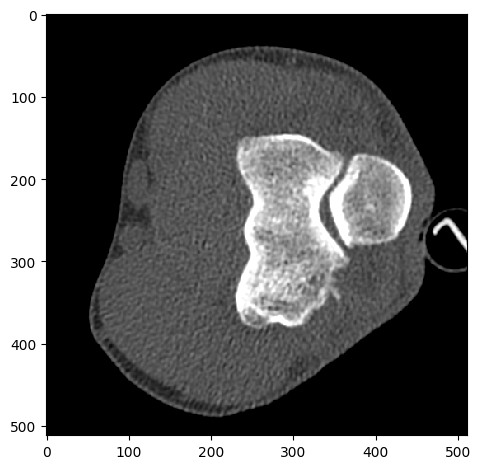

In [30]:
img_org = io.imread('data/ElbowCTSlice.png')
io.imshow(img_org)
io.show()

In [31]:
def edge_detection(img, filter_type, kernel_size, thres, plot = False):
    '''
    img: (2D ndarray)
    filter_type: (str) 'gaussian' or 'median'
    kernel_size: (int) size of the smoothing filter
    thres: (float) threshold for the binarization
    plot: (bool) whether plot the images. Default False.
    '''

    if filter_type == 'gaussian':
        img_filt = gaussian(img, kernel_size)
    elif filter_type == 'median':
        img_filt = apply_median_filter(img, kernel_size)

    gradients = prewitt(img_filt)
    edges = gradients > thres

    if plot:
        fig, ax = plt.subplots(nrows = 1, ncols = 3, figsize = (10,5))
        ax[0].imshow(img_filt, cmap = 'gray')
        ax[1].imshow(gradients, cmap = 'gray')
        ax[2].imshow(edges, cmap = 'gray')
        [ax_.set_axis_off() for ax_ in ax]
        plt.show()

    return edges

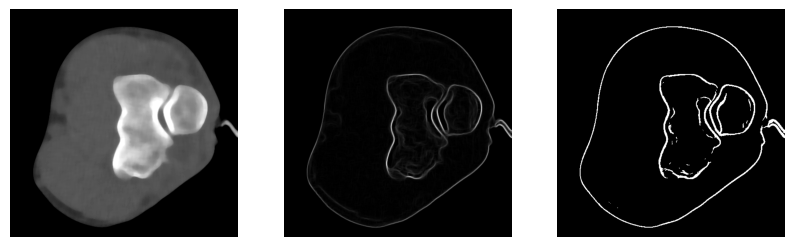

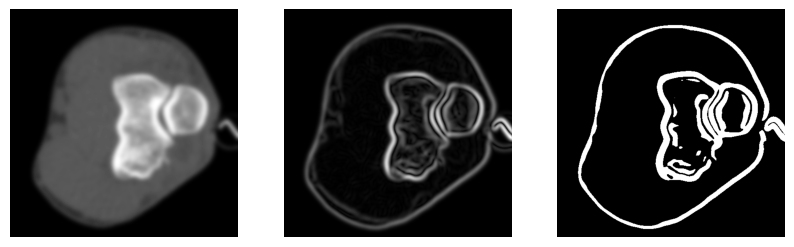

In [32]:
edges = edge_detection(img_org, 'median', 15, 0.05, True)
edges = edge_detection(img_org, 'gaussian', 5, 0.02, True)

### Video filtering

Check the function video_filtering.py, in particular the last lines inside "if __name__ == '__main__'" to understand what the arguments mean

#### Exercise 11

In [33]:
# Only prewitt
!python video_filtering.py 1 0 0

Starting image capture
Opening connection to camera
Starting camera loop
Stopping image loop


In [34]:
# Only prewitt, otsu
!python video_filtering.py 1 1 0

Starting image capture
Opening connection to camera
Starting camera loop
Stopping image loop


#### Exercise 12

In [35]:
# Only prewitt, otsu, median
!python video_filtering.py 1 1 1

Starting image capture
Opening connection to camera
Starting camera loop
Stopping image loop


# Exercise 4b - Image Morphology

In [1]:
import numpy as np
import skimage.io as io
from skimage.color import rgb2gray
from skimage.filters import threshold_otsu
from skimage.morphology import erosion, dilation, opening, closing
from skimage.morphology import disk 
import matplotlib.pyplot as plt

In [2]:
# From https://scikit-image.org/docs/stable/auto_examples/applications/plot_morphology.html
def plot_comparison(original, filtered, filter_name):
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(8, 4), sharex=True,
                                   sharey=True)
    ax1.imshow(original, cmap=plt.cm.gray)
    ax1.set_title('original')
    ax1.axis('off')
    ax2.imshow(filtered, cmap=plt.cm.gray)
    ax2.set_title(filter_name)
    ax2.axis('off')
    io.show()

In [3]:
in_dir = 'data/'

## Image morphology on a single object

Morphological operations are applied to the region with "True" (for boolean images). In other words, morphological operations are applied to the white areas in the binary image.

### Exercise 1

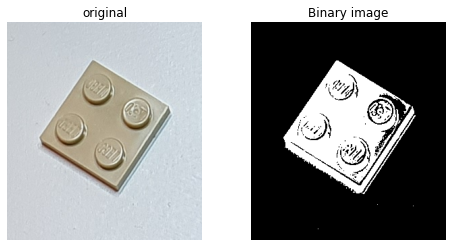

In [4]:
in_file = 'lego_5.png'
im_org = io.imread(f'{in_dir}{in_file}')
im_gray = rgb2gray(im_org)

thres = threshold_otsu(im_gray)
bin_img = im_gray < thres # The ROI is usually with 
plot_comparison(im_org, bin_img, 'Binary image')

### Exercise 2


In [5]:
footprint = disk(2)
# Check the size and shape of the structuring element
print(footprint)

[[0 0 1 0 0]
 [0 1 1 1 0]
 [1 1 1 1 1]
 [0 1 1 1 0]
 [0 0 1 0 0]]


In [6]:
def apply_erosion(binary, disk_sz):
    footprint = disk(disk_sz)
    eroded = erosion(binary, footprint)
    return eroded

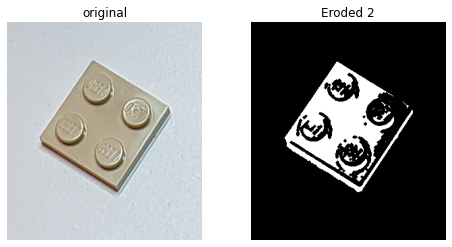

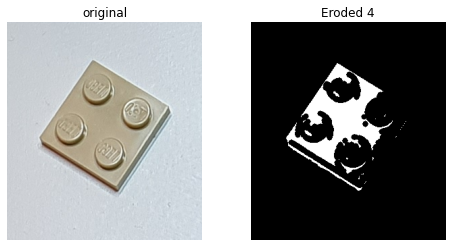

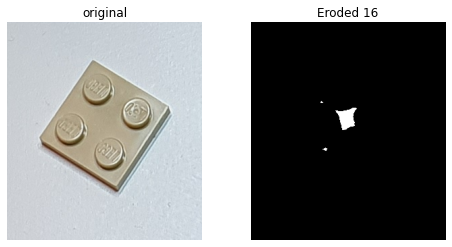

In [7]:
for sz in [2, 4, 16]:
    eroded = apply_erosion(bin_img, sz)
    plot_comparison(im_org, eroded, f'Eroded {sz}')

### Exercise 3

In [8]:
def apply_dilation(binary, disk_sz):
    footprint = disk(disk_sz)
    dilated = dilation(binary, footprint)
    return dilated

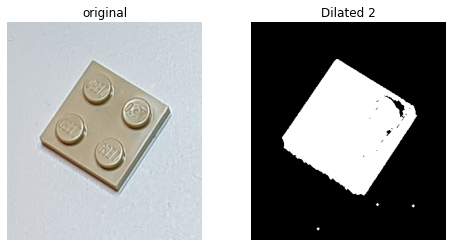

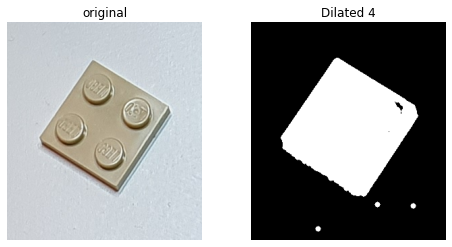

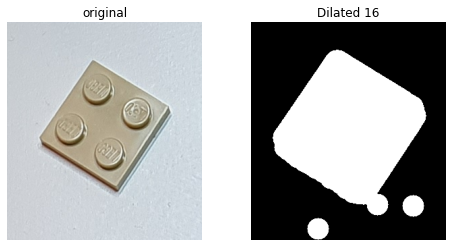

In [9]:
for sz in [2, 4, 16]:
    dilated = apply_dilation(bin_img, sz)
    plot_comparison(im_org, dilated, f'Dilated {sz}')

### Exercise 4


In [10]:
def apply_opening(binary, disk_sz):
    footprint = disk(disk_sz)
    opened = opening(binary, footprint)
    return opened

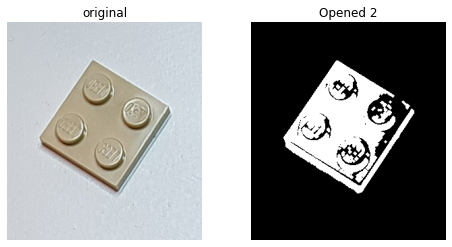

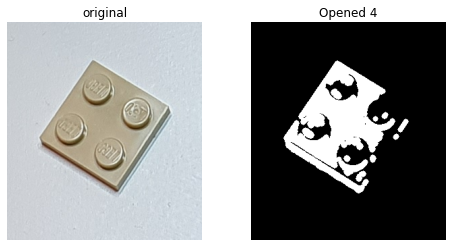

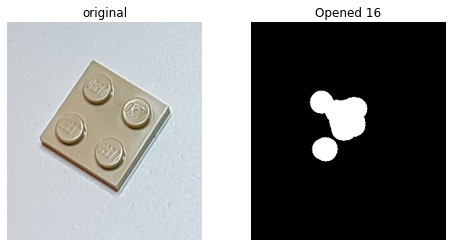

In [11]:
for sz in [2, 4, 16]:
    opened = apply_opening(bin_img, sz)
    plot_comparison(im_org, opened, f'Opened {sz}')

### Exercise 5

In [12]:
def apply_closing(binary, disk_sz):
    footprint = disk(disk_sz)
    closed = closing(binary, footprint)
    return closed

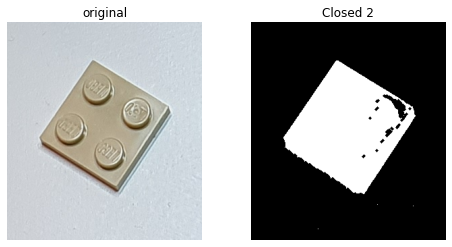

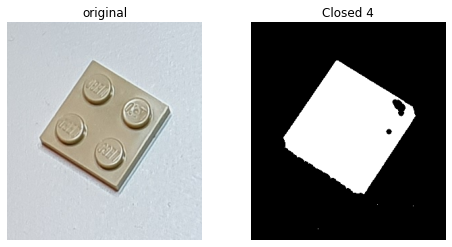

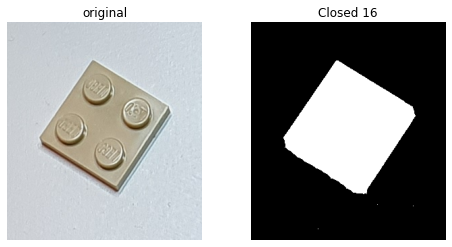

In [13]:
for sz in [2, 4, 16]:
    closed = apply_closing(bin_img, sz)
    plot_comparison(im_org, closed, f'Closed {sz}')

## Object outline

In [14]:
def compute_outline(bin_img):
    """
    Computes the outline of a binary image
    """
    footprint = disk(1)
    dilated = dilation(bin_img, footprint)
    outline = np.logical_xor(dilated, bin_img)
    return outline

### Exercise 6


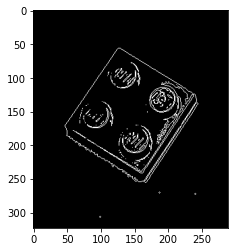

In [15]:
outline_img = compute_outline(bin_img)
plt.imshow(outline_img, cmap = 'gray') # Some people had problems with io.imshow() in boolean images
plt.show()

### Exercise 7


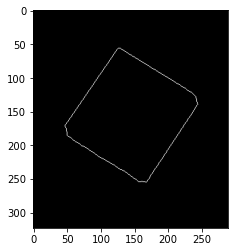

In [16]:
step1 = apply_opening(bin_img, 1)
step2 = apply_closing(step1, 15)
outline_img = compute_outline(step2)
plt.imshow(outline_img, cmap = 'gray')
plt.show()

## Morphology on multiple objects


### Exercise 8


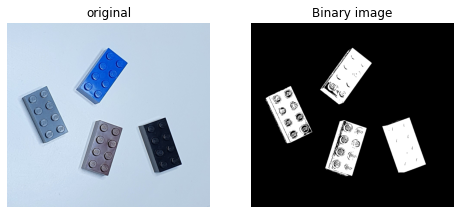

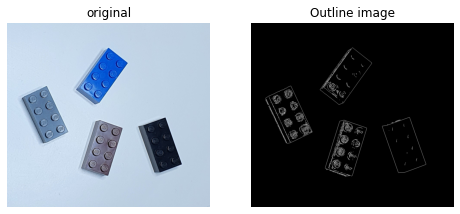

In [17]:
in_file = 'lego_7.png'
im_org = io.imread(f'{in_dir}{in_file}')
im_gray = rgb2gray(im_org)

thres = threshold_otsu(im_gray)
bin_img = im_gray < thres
plot_comparison(im_org, bin_img, 'Binary image')

outline_img = compute_outline(bin_img)
plot_comparison(im_org, outline_img, 'Outline image')

### Exercise 9

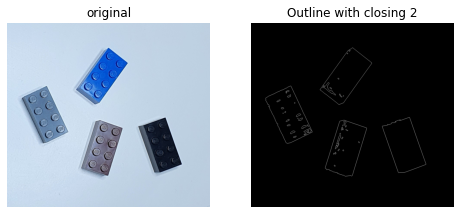

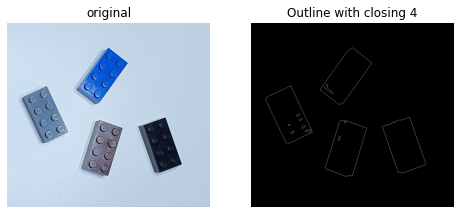

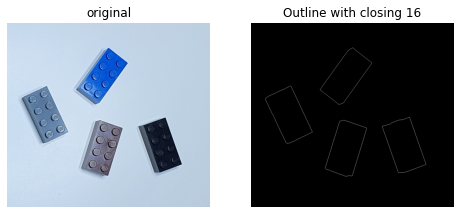

In [18]:
for sz in [2, 4, 16]:
    closed = apply_closing(bin_img, sz)
    outline_img = compute_outline(closed)
    plot_comparison(im_org, outline_img, f'Outline with closing {sz}')

### Exercise 10


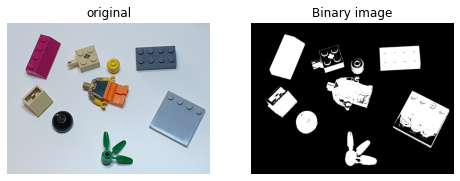

In [19]:
in_file = 'lego_3.png'
im_org = io.imread(f'{in_dir}{in_file}')
im_gray = rgb2gray(im_org)

thres = threshold_otsu(im_gray)
bin_img = im_gray < thres
plot_comparison(im_org, bin_img, 'Binary image')

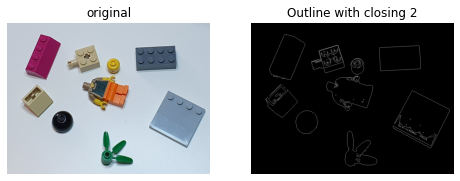

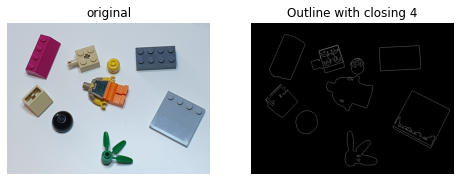

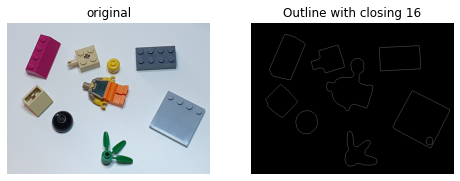

In [20]:
for sz in [2, 4, 16]:
    closed = apply_closing(bin_img, sz)
    outline_img = compute_outline(closed)
    plot_comparison(im_org, outline_img, f'Outline with closing {sz}')

## Morphology on multiple connected objects


### Exercise 11

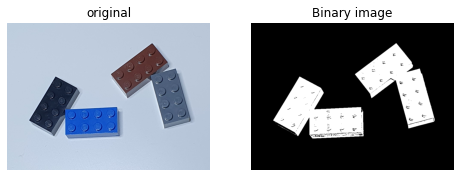

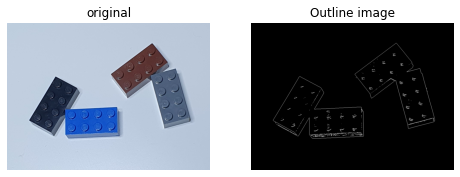

In [21]:
in_file = 'lego_9.png'
im_org = io.imread(f'{in_dir}{in_file}')
im_gray = rgb2gray(im_org)

thres = threshold_otsu(im_gray)
bin_img = im_gray < thres
plot_comparison(im_org, bin_img, 'Binary image')

outline_img = compute_outline(bin_img)
plot_comparison(im_org, outline_img, 'Outline image')

### Exercise 12

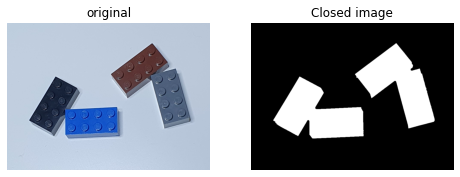

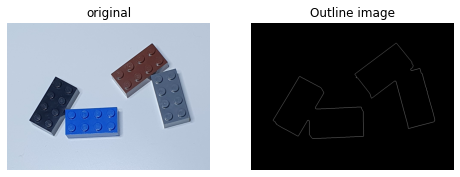

In [22]:
closed = apply_closing(bin_img, 5)
plot_comparison(im_org, closed, 'Closed image')
outline_img = compute_outline(closed)
plot_comparison(im_org, outline_img, 'Outline image')

### Exercise 13

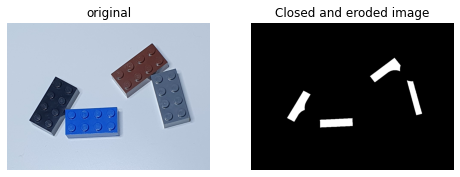

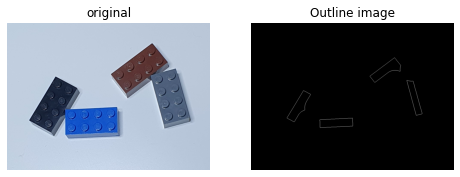

In [23]:
closed = apply_closing(bin_img, 5)
eroded = apply_erosion(closed, 50)
plot_comparison(im_org, eroded, 'Closed and eroded image')
outline_img = compute_outline(eroded)
plot_comparison(im_org, outline_img, 'Outline image')

### Exercise 14

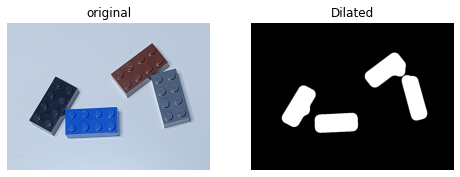

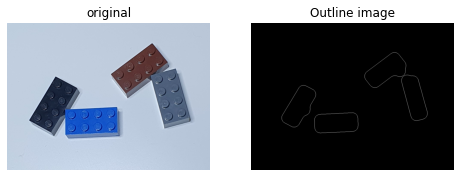

In [24]:
dilated = apply_dilation(eroded, 25)
plot_comparison(im_org, dilated, 'Dilated')
outline_img = compute_outline(dilated)
plot_comparison(im_org, outline_img, 'Outline image')

## Puzzle piece analysis

### Exercise 15

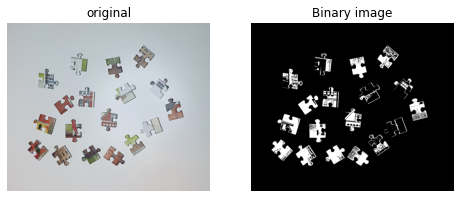

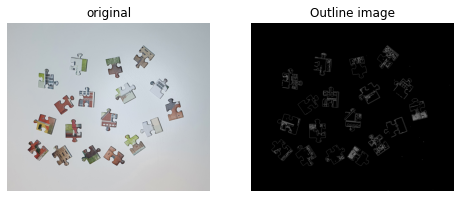

In [25]:
in_file = 'puzzle_pieces.png'
im_org = io.imread(f'{in_dir}{in_file}')
im_gray = rgb2gray(im_org)

thres = threshold_otsu(im_gray)
bin_img = im_gray < thres
plot_comparison(im_org, bin_img, 'Binary image')

outline_img = compute_outline(bin_img)
plot_comparison(im_org, outline_img, 'Outline image')

### Exercise 16

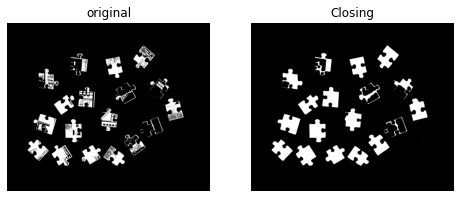

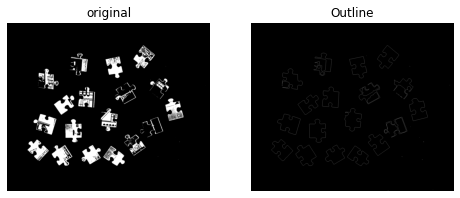

In [26]:
closed = apply_closing(bin_img, 15)
plot_comparison(bin_img, closed, 'Closing')

outline = compute_outline(closed)
plot_comparison(bin_img, outline, 'Outline')

# Exercise 5 - BLOB Analysis (connected component analysis and object classification)

## Blob analysis in Python

In [1]:
# Import relevant packages
from skimage import io, color, morphology
from skimage.util import img_as_float, img_as_ubyte
import matplotlib.pyplot as plt
import numpy as np
import math
from skimage.filters import threshold_otsu
from skimage import segmentation, measure
from skimage.color import label2rgb

In [2]:
# helper function
def show_comparison(original, modified, modified_name):
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 5), sharex=True,
                                   sharey=True)
    ax1.imshow(original)
    ax1.set_title('Original')
    ax1.axis('off')
    ax2.imshow(modified, cmap = "gray")
    ax2.set_title(modified_name)
    ax2.axis('off')
    io.show()

### Lego classification

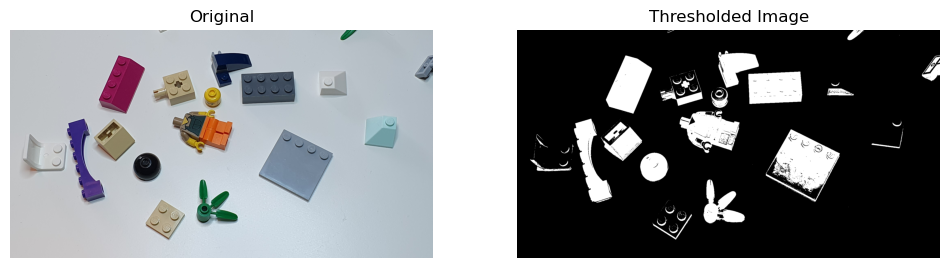

In [3]:
# Exercise 1
im_org = io.imread("data_ex5/lego_4_small.png")
im_gray = color.rgb2gray(im_org)
thres = threshold_otsu(im_gray)
im_bin = img_as_ubyte(im_gray < thres)

show_comparison(im_org, im_bin, "Thresholded Image")

In [4]:
# Exercise 2
im_clear_border = segmentation.clear_border(im_bin)

In [5]:
# Exercise 3
se = morphology.disk(5)
im_open = morphology.closing(im_clear_border, se)
im_close = morphology.opening(im_open, se)

In [6]:
# Exercise 4
label_img = measure.label(im_close)
n_labels = label_img.max()
print(f"Number of labels: {n_labels}")

Number of labels: 29


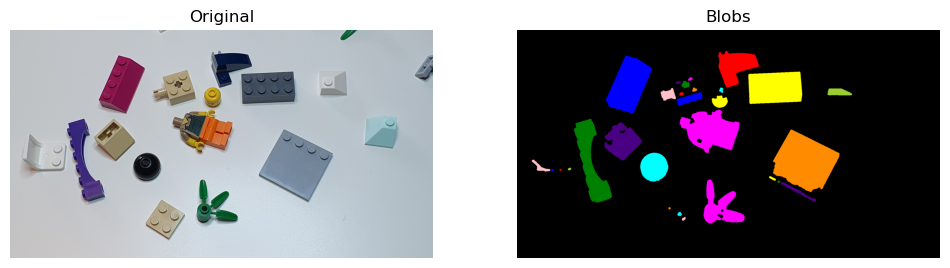

In [7]:
# Exercise 5
im_label = label2rgb(label_img)
show_comparison(im_org, im_label, "Blobs")

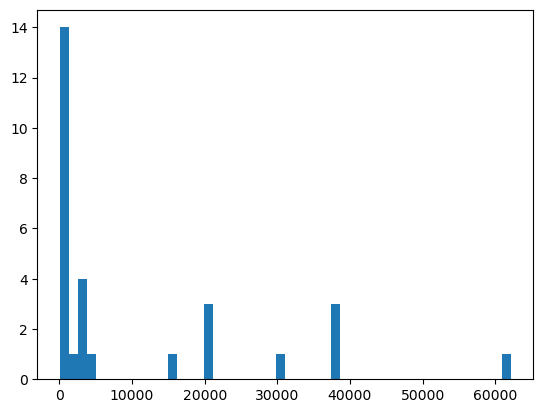

In [8]:
# Exercise 6
region_props = measure.regionprops(label_img)
areas = np.array([prop.area for prop in region_props])
plt.hist(areas, bins=50)
plt.show()

In [2]:
# Exercise 7
!python Ex5-BlobAnalysisInteractive.py 

### Cell counting 

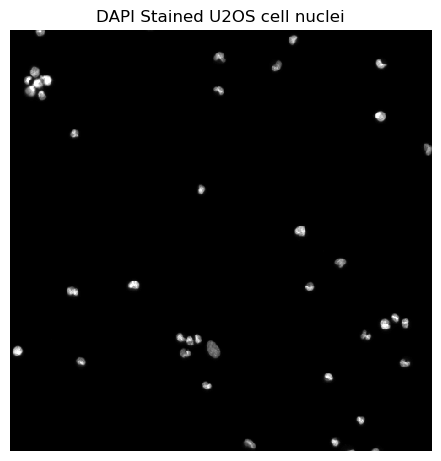

In [12]:
in_dir = "data_ex5/"
img_org = io.imread(in_dir + 'Sample E2 - U2OS DAPI channel.tiff')
# slice to extract smaller image
img_small = img_org[700:1200, 900:1400]
img_gray = img_as_ubyte(img_small) 
io.imshow(img_gray, vmin=0, vmax=100)
plt.title('DAPI Stained U2OS cell nuclei')
plt.axis('off')
io.show()

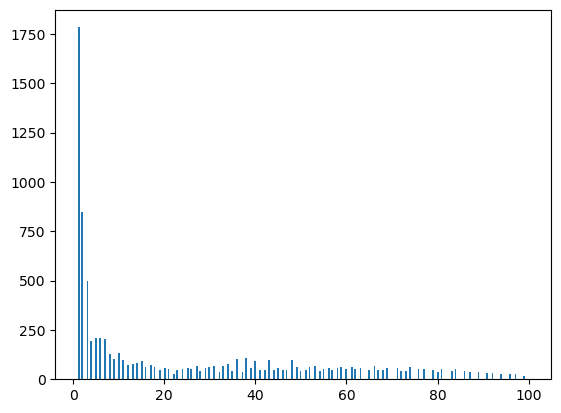

In [13]:
# Exercise 8 
plt.hist(img_gray.ravel(), bins=256, range=(1, 100))
io.show()

thres = threshold_otsu(img_gray)
img_bin = img_as_ubyte(img_gray > thres)

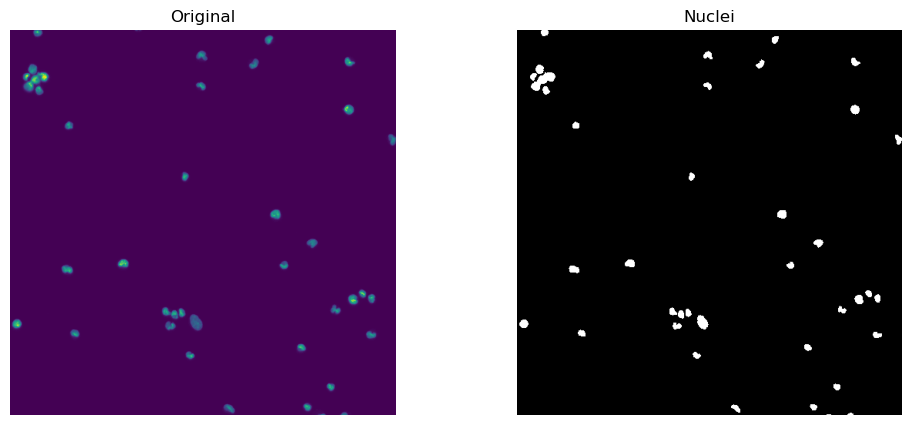

In [14]:
show_comparison(img_gray, img_bin, "Nuclei")

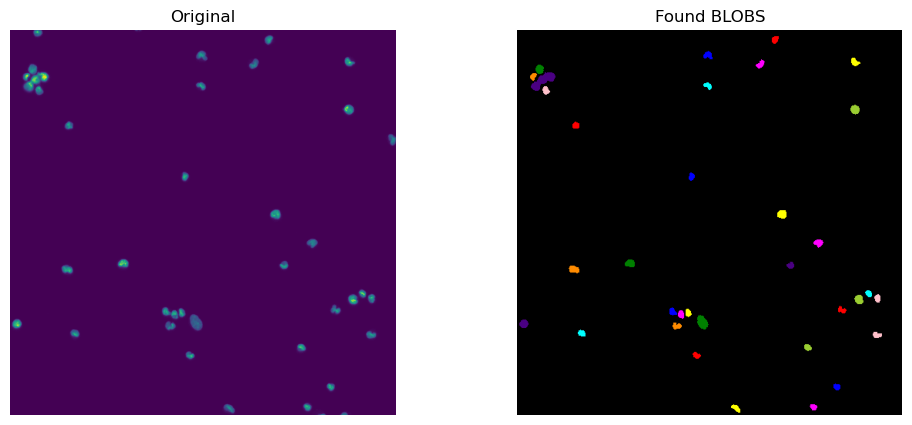

In [15]:
# Exercise 9 
img_clear_border = segmentation.clear_border(img_bin)
label_img = measure.label(img_clear_border)
image_label_overlay = label2rgb(label_img)
show_comparison(img_gray, image_label_overlay, 'Found BLOBS')

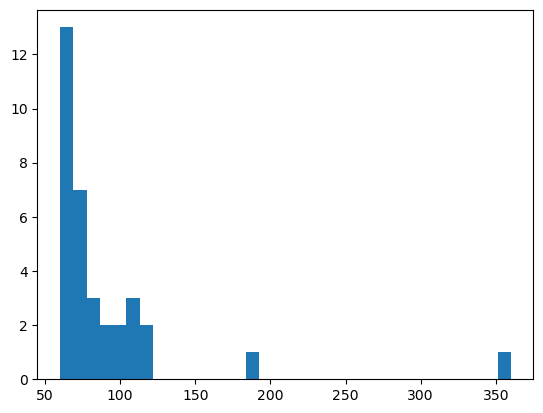

In [16]:
# Exercise 10 
region_props = measure.regionprops(label_img)
areas = np.array([prop.area for prop in region_props])

plt.hist(areas, bins = len(areas))
plt.show()

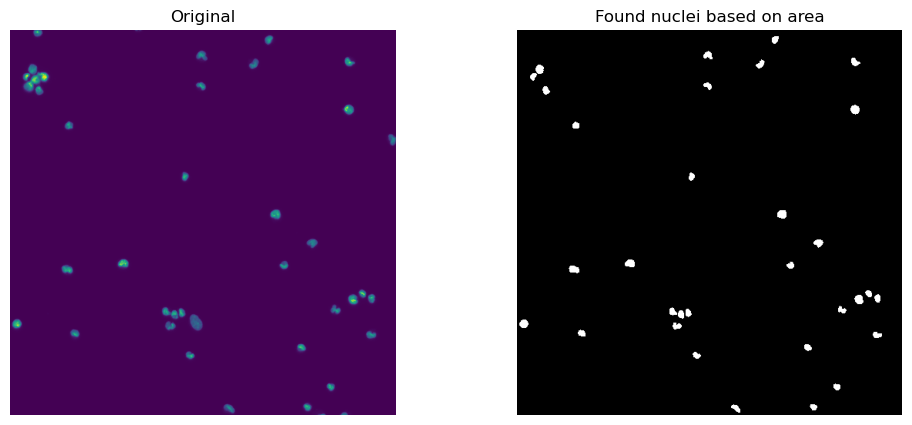

In [17]:
# Exercise 11
min_area = 10
max_area = 130 

# Create a copy of the label_img
label_img_filter = label_img
for region in region_props:
	# Find the areas that do not fit our criteria
	if region.area > max_area or region.area < min_area:
		# set the pixels in the invalid areas to background
		for cords in region.coords:
			label_img_filter[cords[0], cords[1]] = 0
# Create binary image from the filtered label image
i_area = label_img_filter > 0
show_comparison(img_small, i_area, 'Found nuclei based on area')

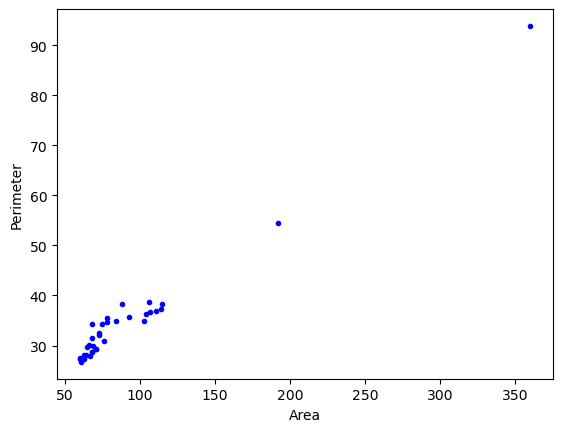

In [18]:
# Exerscise 12
perimeters = np.array([prop.perimeter for prop in region_props])

plt.plot(areas, perimeters, '.b')
plt.xlabel("Area")
plt.ylabel('Perimeter')
plt.show()


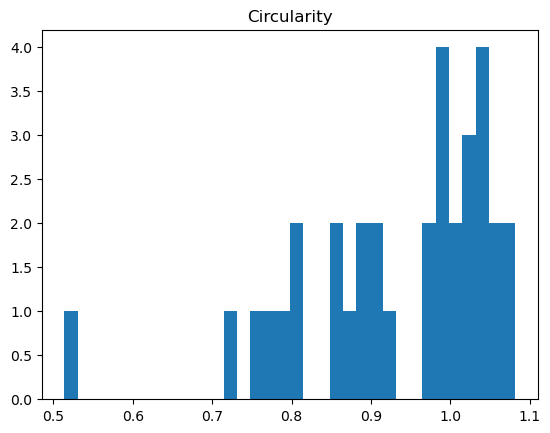

In [19]:
# Exercise 13
circ = 4 * math.pi * areas /(perimeters**2)
plt.hist(circ, bins = len(circ))
plt.title("Circularity")
plt.show()


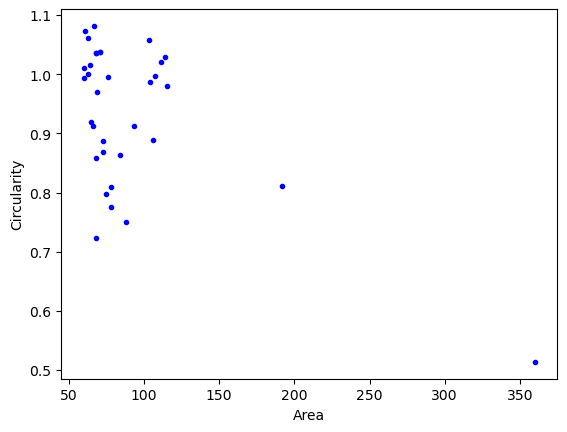

In [20]:
# Exercise 14 
plt.plot(areas, circ, '.b')
plt.xlabel("Area")
plt.ylabel("Circularity")
plt.show()

Objects:  28


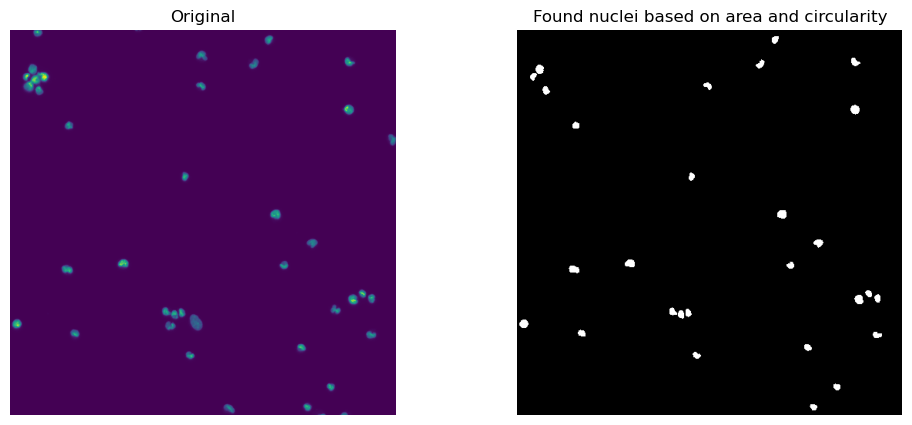

In [21]:
min_area = 10
max_area = 150
label_img_filter = label_img
num_objects = 0
for region in region_props:
    p = region.perimeter
    a = region.area
    circularity = 4 * math.pi * a / (p * p)
    if circularity < 0.8 or a < min_area or a > max_area:
        for cords in region.coords:
            label_img_filter[cords[0], cords[1]] = 0
    else:
        num_objects += 1

print("Objects: ", num_objects)
i_circ = label_img_filter > 0
show_comparison(img_small, i_circ, 'Found nuclei based on area and circularity')

Objects:  91


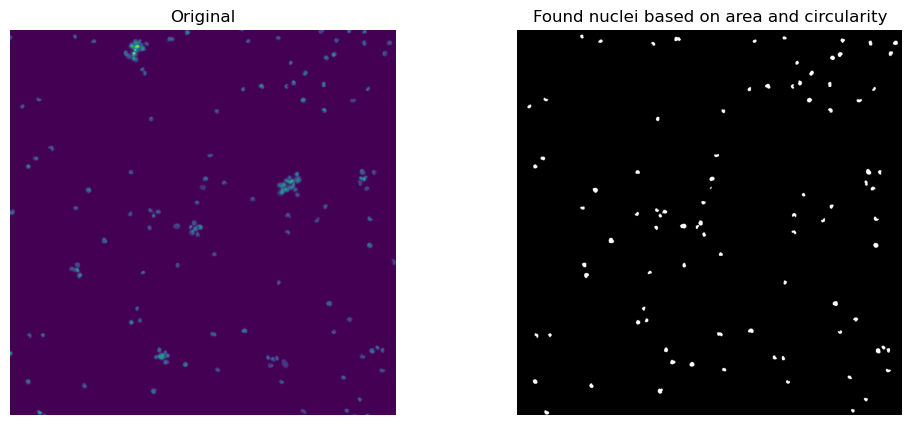

In [25]:
# Exercise 15
img_slice = img_org[300:1200, 500:1400]
im_gray = img_as_ubyte(img_slice)
thres = threshold_otsu(im_gray)
img_bin = img_as_ubyte(im_gray > thres)
img_clear_border = segmentation.clear_border(img_bin)
label_img = measure.label(img_clear_border)
region_props = measure.regionprops(label_img)

min_area = 10
max_area = 150
label_img_filter = label_img
num_objects = 0
for region in region_props:
    p = region.perimeter
    a = region.area
    circularity = 4 * math.pi * a / (p * p)
    if circularity < 0.8 or a < min_area or a > max_area:
        for cords in region.coords:
            label_img_filter[cords[0], cords[1]] = 0
    else:
        num_objects += 1

print("Objects: ", num_objects)
i_circ = label_img_filter > 0
show_comparison(img_slice, i_circ, 'Found nuclei based on area and circularity')

C:\Users\There\AppData\Local\Temp\ipykernel_10152\579951757.py:17: RuntimeWarning: divide by zero encountered in double_scalars
  circularity = 4 * math.pi * a / (p * p)


Objects:  312


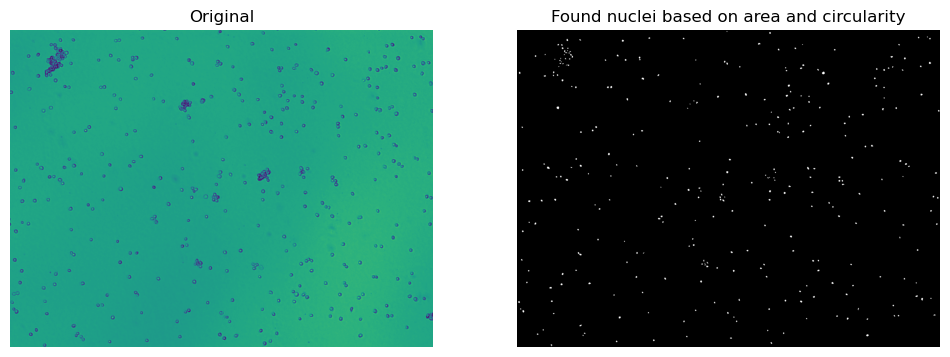

In [30]:
# Exercise 16 
im = io.imread("data_ex5/Sample E2 - U2OS AP channel.tiff")
im_gray = img_as_ubyte(im)
thres = threshold_otsu(im_gray)
img_bin = img_as_ubyte(im_gray > thres)
img_clear_border = segmentation.clear_border(img_bin)
label_img = measure.label(img_clear_border)
region_props = measure.regionprops(label_img)

min_area = 10
max_area = 150
label_img_filter = label_img
num_objects = 0
for region in region_props:
    p = region.perimeter
    a = region.area
    circularity = 4 * math.pi * a / (p * p)
    if circularity < 0.8 or a < min_area or a > max_area:
        for cords in region.coords:
            label_img_filter[cords[0], cords[1]] = 0
    else:
        num_objects += 1

print("Objects: ", num_objects)
i_circ = label_img_filter > 0
show_comparison(im, i_circ, 'Found nuclei based on area and circularity')

# Exercise 6 - Pixel classification and object segmentation

In [4]:
# import relevant packages 
from skimage import io, color
from skimage.morphology import binary_closing, binary_opening
from skimage.morphology import disk
import matplotlib.pyplot as plt
import numpy as np
from skimage import measure
from skimage.color import label2rgb
import pydicom as dicom
from scipy.stats import norm
from scipy.spatial import distance


def show_comparison(original, modified, modified_name):
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(8, 4), sharex=True,
                                   sharey=True)
    ax1.imshow(original, cmap="gray", vmin=-200, vmax=500)
    ax1.set_title('Original')
    ax1.axis('off')
    ax2.imshow(modified)
    ax2.set_title(modified_name)
    ax2.axis('off')
    io.show()

### Explorative Analysis of one CT scan 

In [5]:
in_dir = "data_ex6/"
ct = dicom.read_file(in_dir + 'Training.dcm')
img = ct.pixel_array
print(img.shape)
print(img.dtype)

(512, 512)
int16


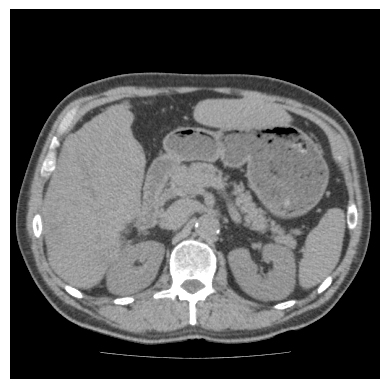

In [6]:
# Exercise 1
plt.figure()
plt.imshow(img, vmin=-200, vmax=200, cmap='gray')
plt.axis('off')
io.show()

In [7]:
# Exercise 2 
spleen_roi = io.imread(in_dir + 'SpleenROI.png')
# convert to boolean image
spleen_mask = spleen_roi > 0
spleen_values = img[spleen_mask]

mu_spleen = np.mean(spleen_values)
std_spleen = np.std(spleen_values)

print(f"The mean spleen HU is given by {mu_spleen:.2f} with corresponding standard deviation {std_spleen:.2f}")

The mean spleen HU is given by 49.48 with corresponding standard deviation 15.00


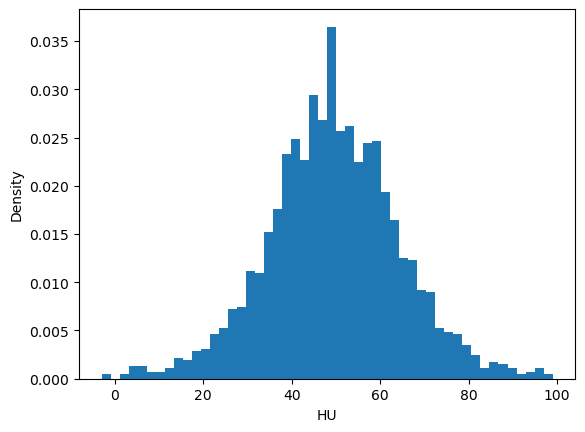

In [8]:
# Exercise 3
plt.figure()
plt.hist(spleen_values.ravel(), bins = 50, density = True)
plt.ylabel("Density")
plt.xlabel("HU")
plt.title("")
plt.show()

C:\Users\There\AppData\Local\Temp\ipykernel_2096\2221399962.py:21: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  values = np.array([spleen_values, kidney_values, fat_values, bone_values, background_values, liver_values])


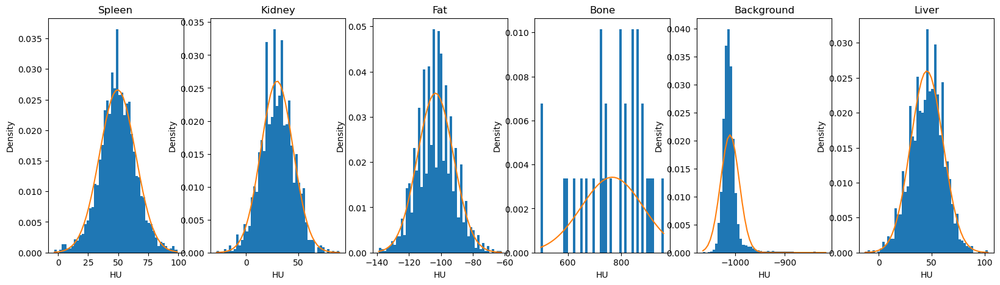

In [9]:
# Exercise 4 
# read ROIs 
kidney_roi = io.imread(in_dir + 'KidneyROI.png')
fat_roi = io.imread(in_dir + 'FatROI.png')
bone_roi = io.imread(in_dir + 'BoneROI.png')
background_roi = io.imread(in_dir + 'BackgroundROI.png')
liver_roi = io.imread(in_dir + "LiverROI.png")

# get values
kidney_mask, fat_mask, bone_mask, background_mask, liver_mask = kidney_roi > 0, fat_roi > 0, bone_roi > 0, background_roi > 0, liver_roi > 0 
kidney_values, fat_values, bone_values, background_values, liver_values = img[kidney_mask], img[fat_mask], img[bone_mask], img[background_mask], img[liver_mask]

# compute mean and std 
mu_kidney, mu_fat, mu_bone, mu_background, mu_liver = np.mean(kidney_values), np.mean(fat_values), np.mean(bone_values), np.mean(background_values), np.mean(liver_values)
std_kidney, std_fat, std_bone, std_background, std_liver = np.std(kidney_values), np.std(fat_values), np.std(bone_values), np.std(background_values), np.std(liver_values)

# gather in array for easy plotting 
means = np.array([mu_spleen, mu_kidney, mu_fat, mu_bone, mu_background, mu_liver])
stds = np.array([std_spleen, std_kidney, std_fat, std_bone, std_background, std_liver])
titles = np.array(["Spleen", "Kidney", "Fat", "Bone", "Background", "Liver"])
values = np.array([spleen_values, kidney_values, fat_values, bone_values, background_values, liver_values])
ns, bins, patches = [], [], []
fig, ax = plt.subplots(1, 6, figsize = (20, 5))
for i in range(6): 
    n, bin, patch = ax[i].hist(values[i].ravel(), bins = 50, density=True)
    ns.append(n), bins.append(bin), patches.append(patch)
    ax[i].plot(bin, norm.pdf(bin, means[i], stds[i]))
    ax[i].set_xlabel("HU")
    ax[i].set_ylabel("Density")
    ax[i].set_title(titles[i])
plt.show()



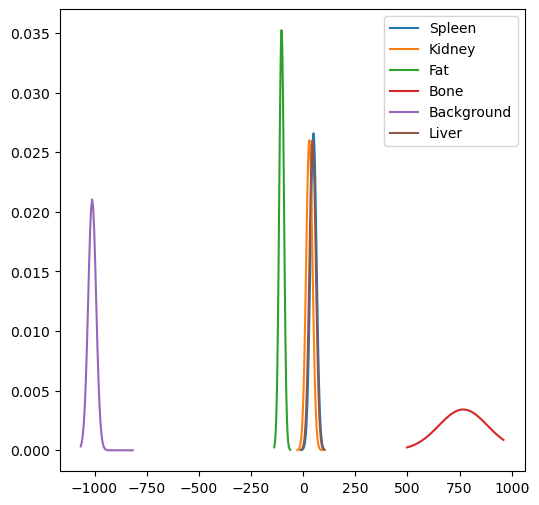

In [10]:
# Exercise 5
plt.figure(figsize = (6, 6))
for i in range(len(bins)): 
    plt.plot(bins[i], norm.pdf(bins[i], means[i], stds[i]), label = titles[i])
plt.legend()
plt.show()

# kidney and spleen are difficult to distinguish 

### Minimum distance pixel classification

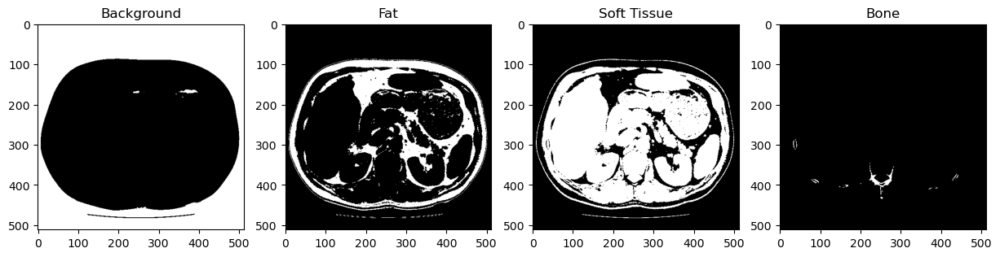

In [11]:
# Exercise 7
# compute mean ogf soft tissue class 
soft_tissue_values = np.append(kidney_values, spleen_values)
soft_tissue_values = np.append(soft_tissue_values, liver_values)
(mu_soft, std_soft) = norm.fit(soft_tissue_values)

# compute thresholds 
t_background = -200
t_fat_soft = (mu_fat + mu_soft) / 2.0
t_soft_bone = (mu_soft + mu_bone) / 2.0 

# compute bimary images 
background_img = img <= t_background 
fat_img = (img > t_background) & (img <= t_fat_soft)
soft_img = (img > t_fat_soft) & (img <= t_soft_bone)
bone_img = img > t_soft_bone 

fig, ax = plt.subplots(1, 4, figsize = (15, 5))
ax[0].imshow(background_img, cmap = "gray")
ax[0].set_title("Background")
ax[1].imshow(fat_img, cmap = "gray")
ax[1].set_title("Fat")
ax[2].imshow(soft_img, cmap = "gray")
ax[2].set_title("Soft Tissue")
ax[3].imshow(bone_img, cmap = "gray")
ax[3].set_title("Bone")
plt.show()


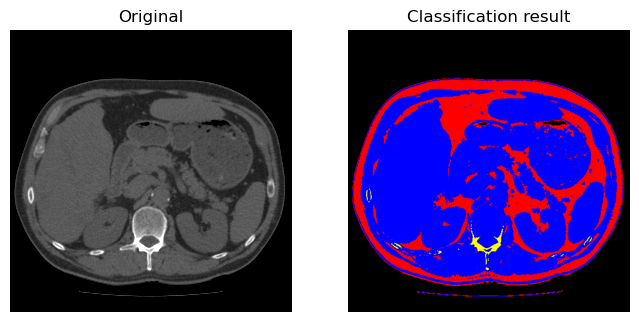

In [12]:
# Exercise 8 
label_img = fat_img + 2 * soft_img + 3 * bone_img
image_label_overlay = label2rgb(label_img)
show_comparison(img, image_label_overlay, 'Classification result')

### Parametric Pixel Classification

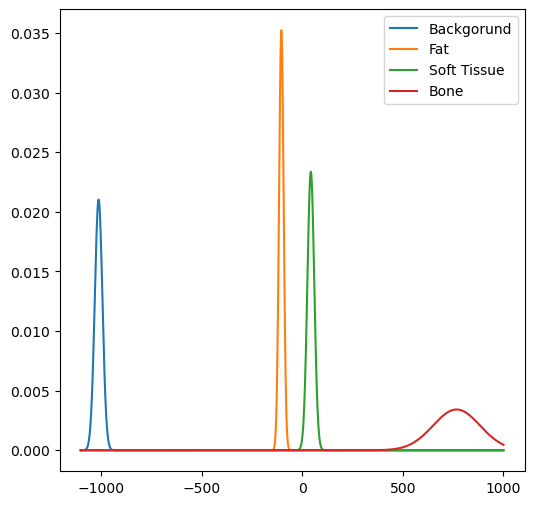

In [13]:
# Exercise 9 
means = np.array([mu_background, mu_fat, mu_soft, mu_bone])
stds = np.array([std_background, std_fat, std_soft, std_bone])
titles = np.array(["Backgorund", "Fat", "Soft Tissue", "Bone"])
x = np.linspace(-1100, 1000, 1000)
plt.figure(figsize = (6, 6))
for i in range(4): 
    plt.plot(x, norm.pdf(x, means[i], stds[i]), label = titles[i])
plt.legend()
plt.show()


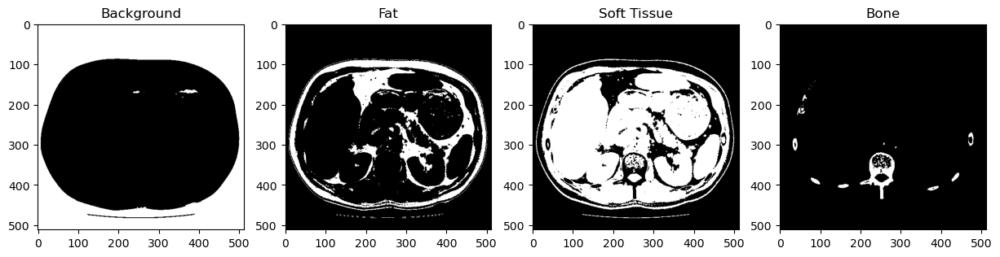

In [14]:
# Exercise 10
# Found by inspecting the plot and seeing where the Gaussian crosses
# for test_value in range(-50, -30):
#     if norm.pdf(test_value, mu_fat, std_fat) > norm.pdf(test_value, mu_soft, std_soft):
#         print(f"For value {test_value} the class is fat")
#     else:
#         print(f"For value {test_value} the class is soft tissue")

t_background = -200
t_fat_soft = -45 
t_soft_bone = 141

# compute bimary images 
background_img = img <= t_background 
fat_img = (img > t_background) & (img <= t_fat_soft)
soft_img = (img > t_fat_soft) & (img <= t_soft_bone)
bone_img = img > t_soft_bone 

fig, ax = plt.subplots(1, 4, figsize = (15, 5))
ax[0].imshow(background_img, cmap = "gray")
ax[0].set_title("Background")
ax[1].imshow(fat_img, cmap = "gray")
ax[1].set_title("Fat")
ax[2].imshow(soft_img, cmap = "gray")
ax[2].set_title("Soft Tissue")
ax[3].imshow(bone_img, cmap = "gray")
ax[3].set_title("Bone")
plt.show()

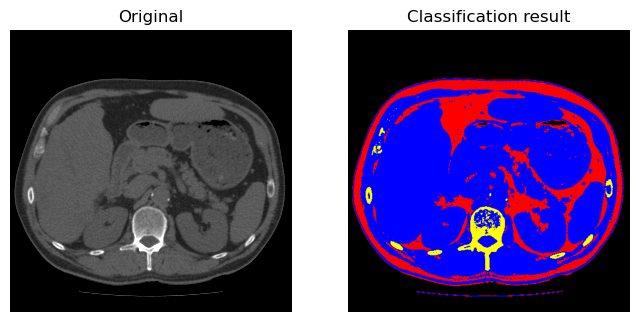

In [15]:
# exercise 11 
label_img = fat_img + 2 * soft_img + 3 * bone_img
image_label_overlay = label2rgb(label_img)
show_comparison(img, image_label_overlay, 'Classification result')

### Object segmentation 

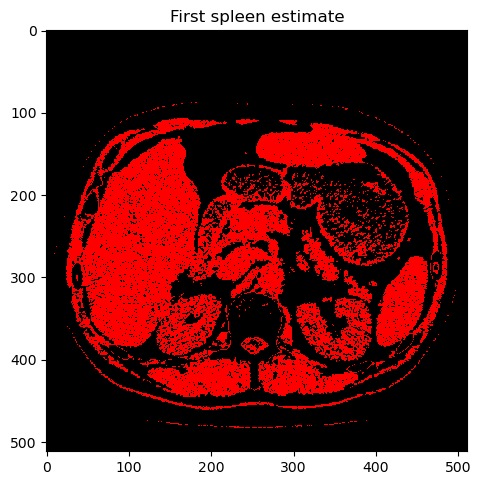

In [16]:
# Exercise 11 
t_1 = 20
t_2 = 80 
spleen_estimate = (img > t_1) & (img < t_2)
spleen_label_colour = color.label2rgb(spleen_estimate)
io.imshow(spleen_label_colour)
plt.title("First spleen estimate")
io.show()

In [17]:
# Exercise 12
footprint = disk(2)
closed = binary_closing(spleen_estimate, footprint)

footprint = disk(4)
opened = binary_opening(closed, footprint)

label_img = measure.label(opened)

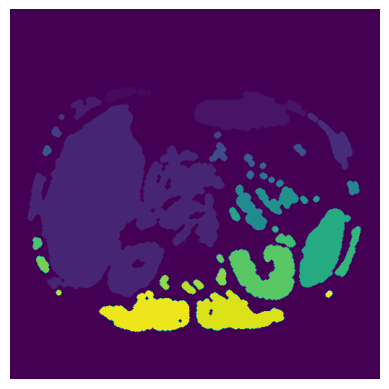

In [18]:
# Exercise 13
plt.imshow(label_img)
plt.axis("off")
plt.show()

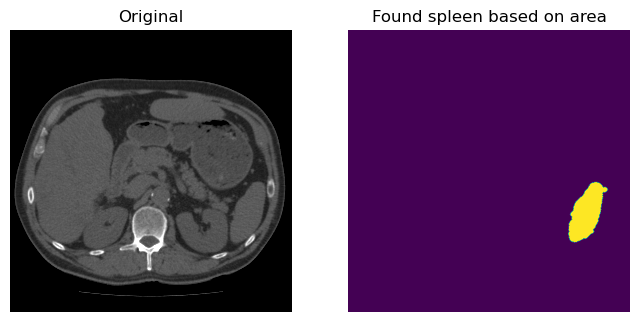

In [19]:
# Exercise 14
min_area = 2000
max_area = 10000 
min_ecc = 0.90
max_perimeter = 350 

# Create a copy of the label_img
label_img_filter = label_img.copy()
region_props = measure.regionprops(label_img)
for region in region_props:
	# Find the areas that do not fit our criteria
	if region.area > max_area or region.area < min_area or region.eccentricity < min_ecc or region.perimeter > max_perimeter:
		# set the pixels in the invalid areas to background
		for cords in region.coords:
			label_img_filter[cords[0], cords[1]] = 0
# Create binary image from the filtered label image
i_area = label_img_filter > 0
show_comparison(img, i_area, 'Found spleen based on area')

In [20]:
# Exercise 15 
def spleen_finder(ct_image, max_area = 10000, min_area = 1000, min_ecc = 0.9, max_perimeter = 350, min_perimeter = 250): 
    # thresholding 
    t_1, t_2 = 20, 80
    spleen_estimate = (ct_image > t_1) & (ct_image < t_2)
    
    #  morphological operations 
    fp1, fp2 = disk(2), disk(4)
    closed = binary_closing(spleen_estimate, fp1)
    opened = binary_opening(closed, fp2)

    # image to label
    label_img = measure.label(opened)
    label_img_filter = label_img.copy()

    region_props = measure.regionprops(label_img)
    for region in region_props:
        # Find the areas that do not fit our criteria
        if region.area > max_area or region.area < min_area or region.eccentricity < min_ecc or region.perimeter > max_perimeter or region.perimeter < min_perimeter:
            # set the pixels in the invalid areas to background
            for cords in region.coords:
                label_img_filter[cords[0], cords[1]] = 0
    # Create binary image from the filtered label image
    return label_img_filter > 0
    



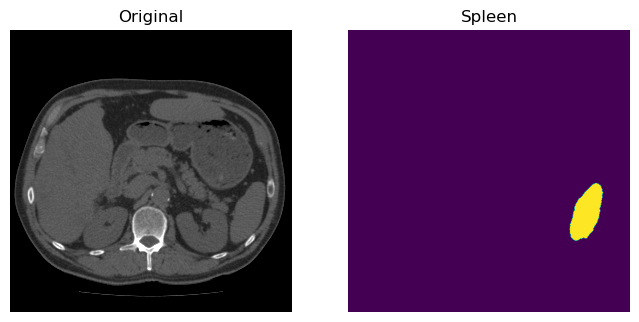

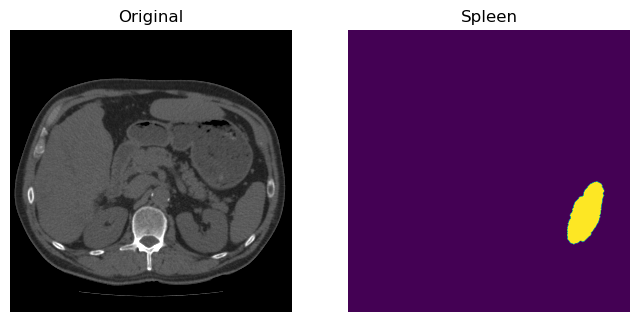

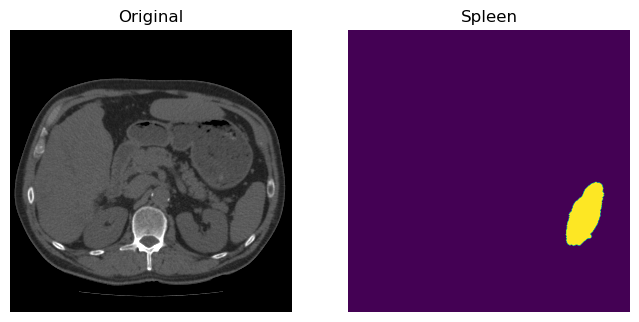

In [21]:
# Exercise 16 
val1, val2, val3 = io.imread("data_ex6/Validation1.dcm"), io.imread("data_ex6/Validation2.dcm"), io.imread("data_ex6/Validation3.dcm")
show_comparison(img, spleen_finder(val1), 'Spleen')
show_comparison(img, spleen_finder(val2), 'Spleen')
show_comparison(img, spleen_finder(val3), 'Spleen')


In [22]:
# Exercise 17
# Get predictions 
pred1 = spleen_finder(val1)
pred2 = spleen_finder(val2)
pred3 = spleen_finder(val3)

# get ground thruths 
gt_1 = (io.imread(in_dir + 'Validation1_spleen.png') > 0)
gt_2 = (io.imread(in_dir + 'Validation2_spleen.png') > 0)
gt_3 = (io.imread(in_dir + 'Validation3_spleen.png') > 0)

# get dice scores 
score1 = 1 - distance.dice(pred1.ravel(), gt_1.ravel())
score2 = 1 - distance.dice(pred2.ravel(), gt_3.ravel())
score3 = 1 - distance.dice(pred3.ravel(), gt_3.ravel())

print(f"Score 1 = {score1}, Score 2 = {score2}, Score 3 = {score3}")

Score 1 = 0.9558359621451105, Score 2 = 0.9471671530643051, Score 3 = 0.9715459078908771


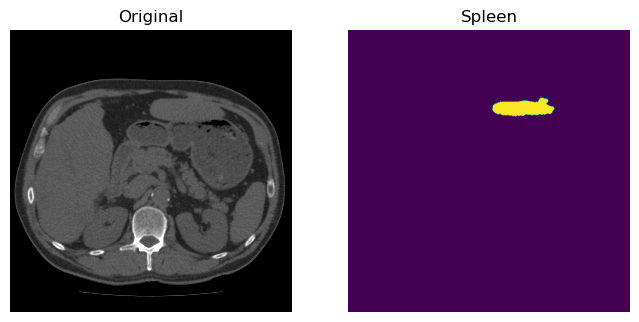

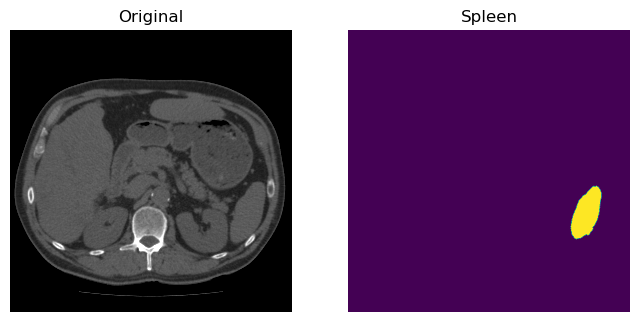

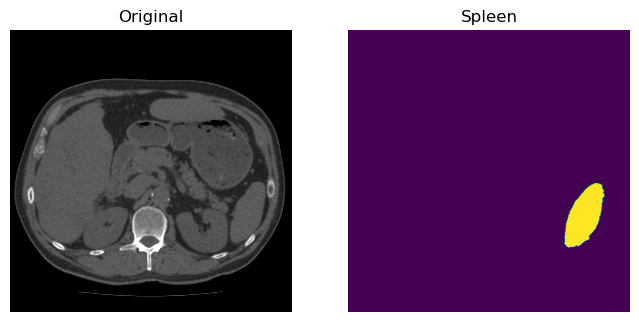

In [23]:
# Exercise 18 
test1, test2, test3 = io.imread("data_ex6/Test1.dcm"), io.imread("data_ex6/Test2.dcm"), io.imread("data_ex6/Test3.dcm")
show_comparison(img, spleen_finder(test1), 'Spleen')
show_comparison(img, spleen_finder(test2), 'Spleen')
show_comparison(img, spleen_finder(test3), 'Spleen')

In [24]:
# Exercise 17
# Get predictions 
pred1 = spleen_finder(test1)
pred2 = spleen_finder(test2)
pred3 = spleen_finder(test3)

# get ground thruths 
gt_1 = (io.imread(in_dir + 'Test1_spleen.png') > 0)
gt_2 = (io.imread(in_dir + 'Test2_spleen.png') > 0)
gt_3 = (io.imread(in_dir + 'Test3_spleen.png') > 0)

# get dice scores 
score1 = 1 - distance.dice(pred1.ravel(), gt_1.ravel())
score2 = 1 - distance.dice(pred2.ravel(), gt_3.ravel())
score3 = 1 - distance.dice(pred3.ravel(), gt_3.ravel())

print(f"Score 1 = {score1}, Score 2 = {score2}, Score 3 = {score3}")

Score 1 = 0.0, Score 2 = 0.779185520361991, Score 3 = 0.967035025285634


# Exercise 6b on Advanced segmentation: Fisherman's Linear discriminant analysis for segmentation

The exercise is to perform advanced segmentation of two brain tissue types.  To improve the segmentation result over the simpler intensity histogram thresholding methods we 
will use two input features compared to a single. The two input features are two different image modalities acquired on the same brain. 

The two tissue types to be segmented are: 
1. The White Matter (WM) is the tissue type that contain the brain network - like the cables in the internet. The  WM ensure the communication flow between functional brain regions. 
2. The Grey Matter (GM) is the tissue type that contain the cell bodies at the end of the brain network and are the functional units in the brain. The functional units are like CPUs in the computer. They are processing our sensorial input and are determining a reacting to these. It could be to start running.

Provided data:
ex6_ImgData2Load.mat contain all image and ROI data which are loaded into the variables:
- ImgT1 - One axial slice of brain using T1W MRI acquisition
- ImgT2 - One axial slice of brain using T2W MRI acquisition
- ROI_WM - Binary training data for class 1: Expert identification of voxels belonging to tissue type: White Matter
- ROI_GM - Binary training data for class 2: Expert identification of voxels belonging to tissue type: Grey Matter

LDA.py  Python function that realise the Fisher's linear discriminant analyse as described in the lecture notes

Exercise -  You simply go step-by-step and fill the command lines and answer/discuss the questions.

April 2023

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.io as sio
from skimage.morphology import opening, closing
from skimage.morphology import disk

from LDA import LDA # You should have LDA.py in the same folder as the current script, otherwise you can just copy the function in the current script. 

In [2]:
in_dir = 'data/'
in_file = 'ex6_ImagData2Load.mat'
data = sio.loadmat(in_dir + in_file)
ImgT1 = data['ImgT1']
ImgT2 = data['ImgT2']
ROI_GM = data['ROI_GM'].astype(bool)
ROI_WM = data['ROI_WM'].astype(bool)

### Exercise 1

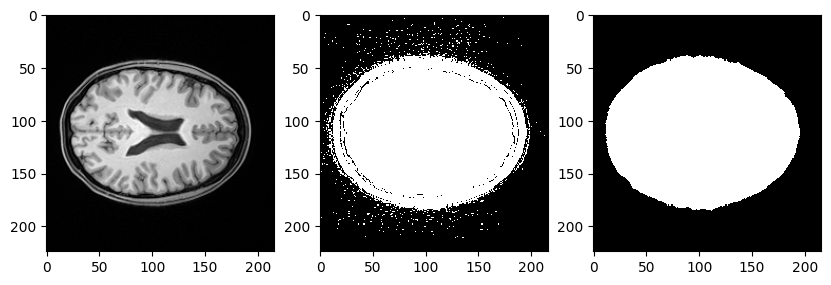

In [3]:
mask_init = ImgT1 > 10
mask = opening(mask_init, disk(2))
mask = closing(mask, disk(3))

fig, axs = plt.subplots(nrows = 1, ncols = 3, figsize = (10, 10))
axs[0].imshow(ImgT1, cmap = 'gray')
axs[1].imshow(mask_init, cmap = 'gray', interpolation = 'none')
axs[2].imshow(mask, cmap = 'gray', interpolation = 'none')
plt.show()

In [4]:
def my_show_1D_histogram(img, mask, img_name, axs):
    axs[0].imshow(img, cmap = 'gray')
    axs[0].set_title(img_name)
    axs[0].set_axis_off()

    intensities = img[mask]
    axs[1].hist(intensities, bins = 100)
    axs[1].set_title(f'1D Histogram {img_name}')
    axs[1].set_xlabel('Intensities')
    axs[1].set_ylabel('Frequency')

    return intensities

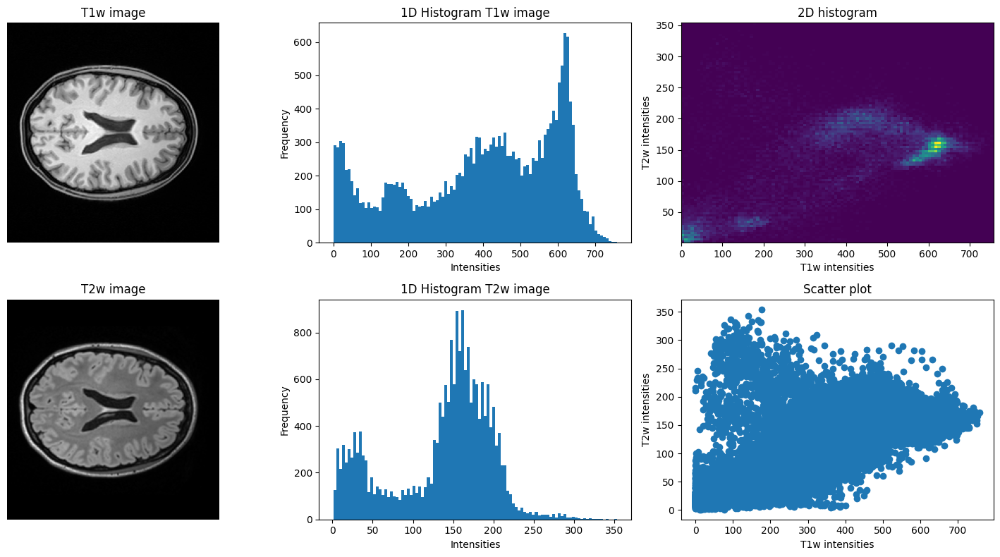

In [5]:
fig, axs = plt.subplots(nrows = 2, ncols = 3, figsize = (15, 8))
T1_intensities = my_show_1D_histogram(ImgT1, mask, 'T1w image', axs[0, 0:2])
T2_intensities = my_show_1D_histogram(ImgT2, mask, 'T2w image', axs[1, 0:2])
axs[0,2].hist2d(T1_intensities, T2_intensities, bins = 100)
axs[0,2].set_xlabel('T1w intensities')
axs[0,2].set_ylabel('T2w intensities')
axs[0,2].set_title('2D histogram')

axs[1,2].scatter(T1_intensities, T2_intensities)
axs[1,2].set_xlabel('T1w intensities')
axs[1,2].set_ylabel('T2w intensities')
axs[1,2].set_title('Scatter plot')
plt.tight_layout()
plt.show()

**Q1**: What is the intensity threshold that can separate the GM and WM classes (roughly) from the 1D histograms?

A1: For T1:about 500 and for T2: about 160

**Q2**: Can the GM and WM intensity classes be observed in the 2D histogram and scatter plot? 

A2: Yes there appear clear two clusters with maxium intensitised in the 2D histogram that represent the two classes distributions 


### Exercise 2

**Q3**: Does the ROI drawings look like what you expect from an expert? 

A3: No, its just some stribes here and there in the outline the intensities of the two classes


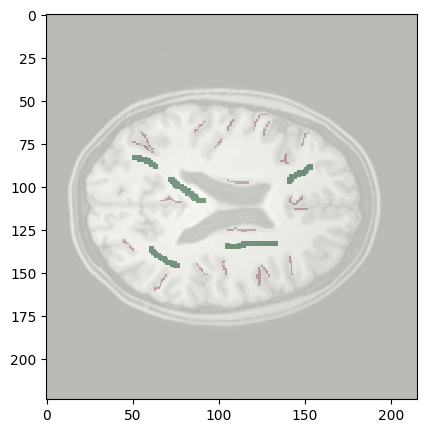

In [6]:
fig, axs = plt.subplots(nrows = 1, ncols = 1, figsize = (5, 5))
axs.imshow(ImgT1, cmap = 'gray')
axs.imshow(ROI_GM, cmap = 'Reds', alpha = 0.5, interpolation = 'none')
axs.imshow(ROI_WM, cmap = 'Greens', alpha = 0.5, interpolation = 'none')
plt.show()

### Exercise 3

**Q4**: What is the difference between the 1D histogram of the training examples and the 1D histogram of the whole image? Is the difference expected?  

A4: It looks very alike the full image histogram except for better class seperation and there is no background


In [7]:
# This is not necessary with the coding style followed in this solution.
qC1 = np.argwhere(ROI_WM) # Shape (399, 2) 
qC2 = np.argwhere(ROI_GM) # (280, 2)

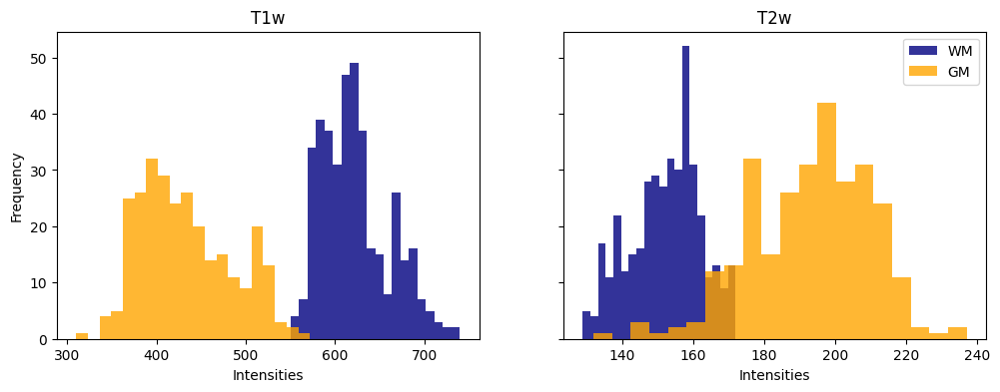

In [8]:
trainWM_T1 = ImgT1[ROI_WM] # trainWM_T1 = ImgT1[qC1[:,0], qC1[:,1]]
trainGM_T1 = ImgT1[ROI_GM] # trainGM_T1 = ImgT1[qC2[:,0], qC2[:,1]]

trainWM_T2 = ImgT2[ROI_WM] # trainWM_T2 = ImgT2[qC1[:,0], qC1[:,1]]
trainGM_T2 = ImgT2[ROI_GM] # trainGM_T2 = ImgT2[qC2[:,0], qC2[:,1]]

fig, axs = plt.subplots(1, 2, figsize = (12, 4), sharex = False, sharey = True)
axs[0].hist(trainWM_T1, bins=20, color = 'navy', label = 'WM', alpha = 0.8)
axs[0].hist(trainGM_T1, bins=20, color = 'orange', label = 'GM', alpha = 0.8)
axs[0].set_ylabel('Frequency')
axs[0].set_xlabel('Intensities')
axs[0].set_title('T1w')

axs[1].hist(trainWM_T2, bins=20, color = 'navy', label = 'WM', alpha = 0.8)
axs[1].hist(trainGM_T2, bins=20, color = 'orange', label = 'GM', alpha = 0.8)
axs[1].set_xlabel('Intensities')
axs[1].set_title('T2w')
plt.legend()
plt.show()


### Exercise 4

In [9]:
# Feature matrix, X -> Shape: (n_samples, n_features)
X1 = np.c_[ImgT1[ROI_WM], ImgT2[ROI_WM]] 
X2 = np.c_[ImgT1[ROI_GM], ImgT2[ROI_GM]]
X = np.r_[X1, X2]

# Label vector, T -> Shape: (n_samples)
n_pixels = X.shape[0]
n_wm_pixels = X1.shape[0]
T = np.zeros((n_pixels, 1))
T[n_wm_pixels:] = 1

In [10]:
X1.shape

(399, 2)

### Exercise 5

**Q5**: How does the class separation appear in the 2D scatter plot compared with 1D histogram. Is it better?

A5: The seperation between the two classes appear to be much better in 2D scatter plot


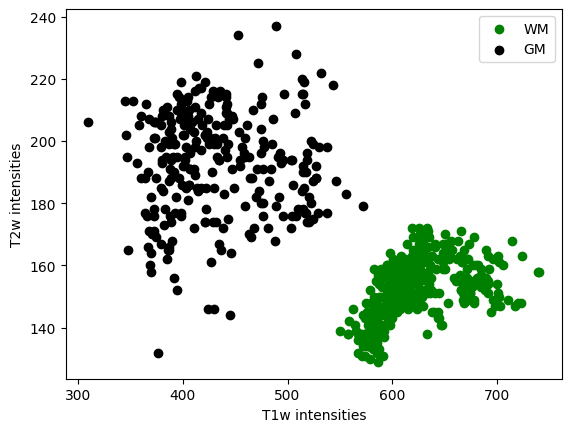

In [11]:
fig, ax = plt.subplots(1,1)
ax.scatter(X1[:,0], X1[:,1], c = 'g', label = 'WM')
ax.scatter(X2[:,0], X2[:,1], c = 'k', label = 'GM')
ax.set_xlabel('T1w intensities')
ax.set_ylabel('T2w intensities')
plt.legend()
plt.show()

### Exercise 6

In [12]:
W = LDA(X, T)

### Exercise 7

In [13]:
Xall= np.c_[ImgT1[mask].flatten(), ImgT2[mask].flatten()]
Y = np.c_[np.ones((len(Xall), 1)), Xall] @ W.T

### Exercise 8

In [14]:
PosteriorProb = np.clip(np.exp(Y) / np.sum(np.exp(Y),1)[:,np.newaxis], 0, 1)

### Exercise 9

In [15]:
posteriorC1 = np.zeros(ImgT1.shape)
posteriorC2 = np.zeros(ImgT1.shape)

posteriorC1[mask] = PosteriorProb[:,0]
posteriorC2[mask] = PosteriorProb[:,1]
mask_WM = posteriorC1 >= 0.5
mask_GM = posteriorC2 > 0.5

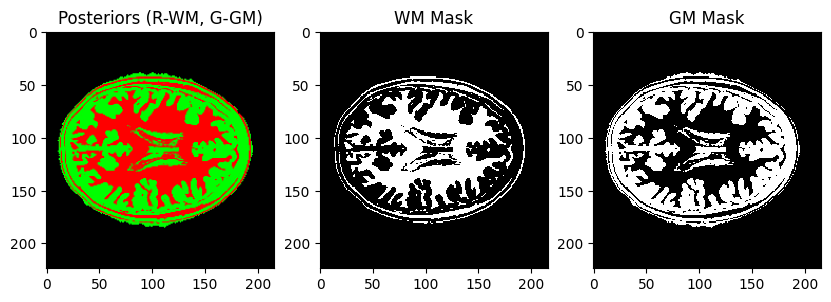

In [16]:
fig, axs = plt.subplots(nrows = 1, ncols = 3, figsize = (10, 5))
rgb = np.stack((posteriorC1, posteriorC2, np.zeros_like(posteriorC1)), axis = -1).astype(np.double)
axs[0].imshow(rgb)
axs[0].set_title('Posteriors (R-WM, G-GM)')
axs[1].imshow(mask_WM, cmap = 'gray', interpolation = 'none')
axs[1].set_title('WM Mask')
axs[2].imshow(mask_GM, cmap='gray', interpolation = 'none')
axs[2].set_title('GM Mask')
plt.show()

### Exercise 10

**Q6**: Can you identify where the hyper plan is placed i.e. y(x)=0? 

A6: Yes, all the segmented points show a clear line at their
       interface=Hyperplane

**Q7**: Is the linear hyper plane positioned as you expected or would a non-linear hyperplane perform better?

A7: Yes and no - I would expect all black and green training data
       points to be on each side of the hyperplane. Moreover the hyperplane seems
       to be too linear and there seem to be an extras class at the low image
       resolutions. 

**Q8**: Would segmentation be as good as using a single image modality using
    thresholding?

A8: If that should be the case the hyperplane would be orthogonal to one
       of the features. It is not. So no.

**Q9**: From the scatter plot does the segmentation results make sense? Are the two tissue types segmented correctly .

A9: Looks good, but hard to say from a scatter plot


In [17]:
Xall_WM = Xall[PosteriorProb[:,0] > 0.5, :]
Xall_GM = Xall[PosteriorProb[:,1] > 0.5, :]

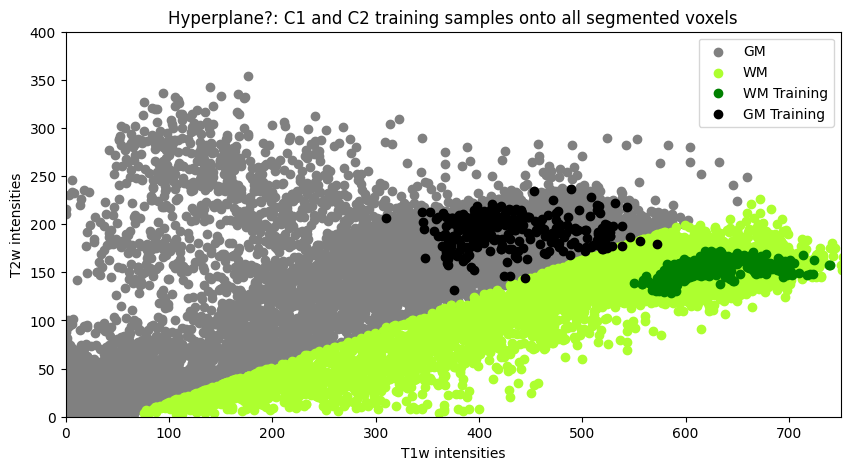

In [18]:
fig, ax = plt.subplots(1,1, figsize = (10,5))
ax.scatter(Xall_GM[:,0], Xall_GM[:,1], c = 'gray', label = 'GM')
ax.scatter(Xall_WM[:,0], Xall_WM[:,1], c = 'greenyellow', label = 'WM')
ax.scatter(X1[:,0], X1[:,1], c = 'g', label = 'WM Training')
ax.scatter(X2[:,0], X2[:,1], c = 'k', label = 'GM Training')
ax.set_xlabel('T1w intensities')
ax.set_ylabel('T2w intensities')
ax.set_title('Hyperplane?: C1 and C2 training samples onto all segmented voxels')

plt.axis([0, 750, 0, 400])
plt.legend()
plt.show()

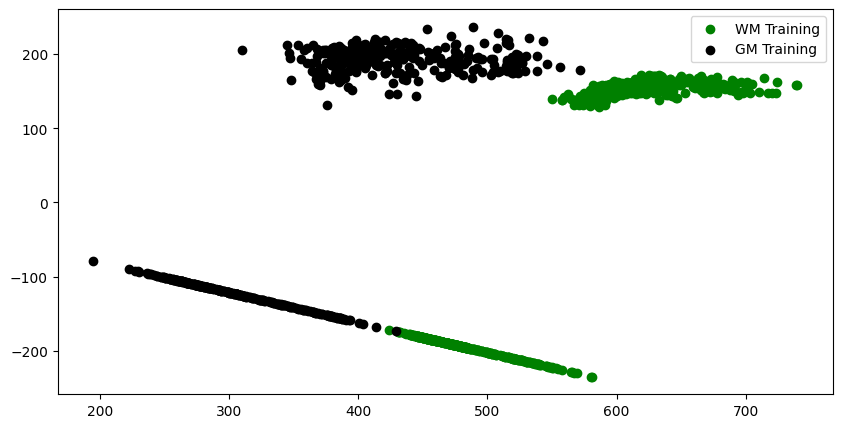

In [19]:
# Projection of the training data onto the hyperplane

fig, ax = plt.subplots(1,1, figsize = (10,5))
ax.scatter(X1[:,0], X1[:,1], c = 'g', label = 'WM Training')
ax.scatter(X2[:,0], X2[:,1], c = 'k', label = 'GM Training')
W_ = W[0,1:] # The weights indicate the normal to the hyperplane, for the projection we need the perpendicular
W_ = (W_/np.linalg.norm(W_))[::-1]
W_[0] = -W_[0]
for point in X1:
  proj = np.dot(point,W_)/np.dot(W_,W_) * W_
  ax.scatter(proj[0],proj[1],color='g')

for point in X2:
  proj = np.dot(point,W_)/np.dot(W_,W_) * W_
  ax.scatter(proj[0],proj[1],color='k')

plt.legend()
plt.show()

# W_ = W[1,1:] # The weights indicate the normal to the hyperplane, for the projection we need the perpendicular
# W_ = (W_/np.linalg.norm(W_))[::-1]
# W_[0] = -W_[0]
# for point in X1:
#   proj = np.dot(point,W_)/np.dot(W_,W_) * W_
#   ax.scatter(proj[0],proj[1],color='r')

# for point in X2:
#   proj = np.dot(point,W_)/np.dot(W_,W_) * W_
#   ax.scatter(proj[0],proj[1],color='b')

### Exercise 11

**Q10**: Are the training examples representative for the segmentation results? Are you surprised that so few training examples perform so well? Do you need to be an anatomical expert to draw these?

A10: Yes they are representative. Yes and no; one do not need to be an anatomical expert, but you need to understand what the method needs as input to perform well.

**Q11**: Compare the segmentation results with the original image. Is the segmentation results satisfactory? Why not?

A11: Yes, the WM and GM classes looks correct segmented when comparing to the anatomical structures in ImgT1 and ImgT2.

**Q12**: Is one class completely wrong segmented? What is the problem?

A12: Yes - If you have not masked out the backgroud voxels, all background and skull voxels also are classified as GM. Solution is to identify the background voxels and exclude these from the segmentation or to add an extra class for background/skull voxels. Also the CSF class is segmented as both GM and WM. The segmentation problem is that there are more classes in the image than the classifier has been trained to segment.


In [20]:
tmp = np.zeros(mask_WM.shape)
red_WM = np.stack((mask_WM, tmp, tmp), axis = -1)
green_GM = np.stack((tmp, mask_GM, tmp), axis = -1)

In [21]:
def overlay_segmentation(I, M):
    I = I/I.max()
    I_aux, I_red = I.copy(), I.copy()
    I_aux[M] = 0
    I_red[M] = 1
    tmp = np.stack((I_red, I_aux, I_aux), axis = -1)
    return tmp

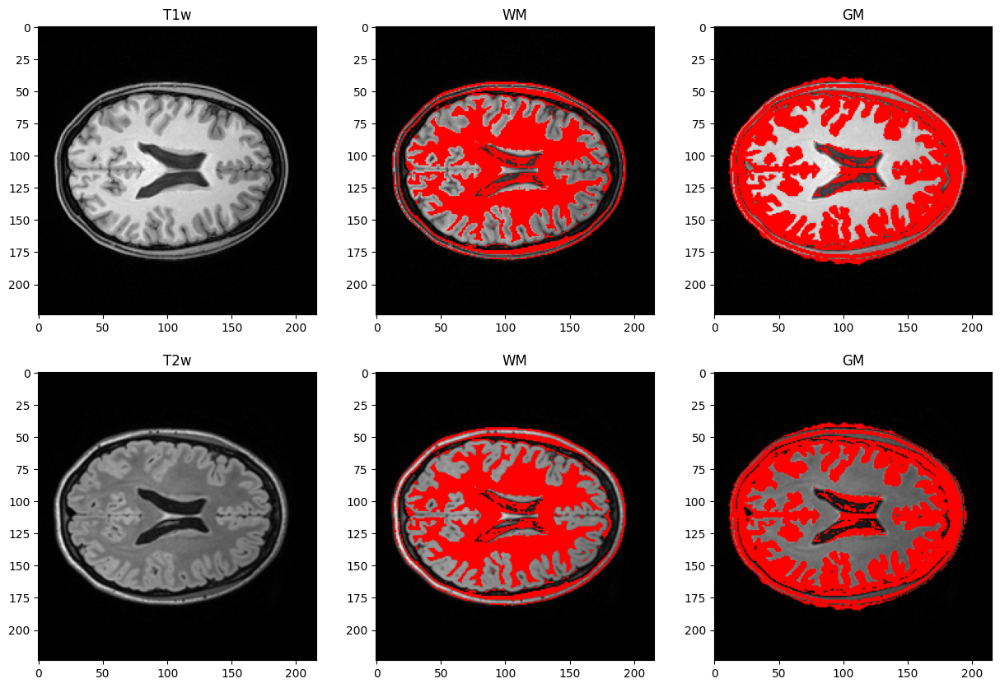

In [22]:
fig, axs = plt.subplots(2, 3, figsize = (15, 10))
axs[0,0].imshow(ImgT1, cmap = 'gray')
axs[0,0].set_title('T1w')
axs[0,1].imshow(overlay_segmentation(ImgT1, mask_WM))
axs[0,1].set_title('WM')
axs[0,2].imshow(overlay_segmentation(ImgT1, mask_GM))
axs[0,2].set_title('GM')

axs[1,0].imshow(ImgT2, cmap = 'gray')
axs[1,0].set_title('T2w')
axs[1,1].imshow(overlay_segmentation(ImgT2, mask_WM))
axs[1,1].set_title('WM')
axs[1,2].imshow(overlay_segmentation(ImgT2, mask_GM))
axs[1,2].set_title('GM')

plt.show()

# Exercise 7 - Geometric transformations and landmark based registration

In [1]:
import matplotlib.pyplot as plt
import math
import numpy as np
import skimage.io as io
from skimage.util import img_as_float, img_as_uint
from skimage.transform import rotate
from skimage.transform import EuclideanTransform
from skimage.transform import SimilarityTransform
from skimage.transform import warp
from skimage.transform import swirl
from skimage.transform import matrix_transform

## Geometric transformations on images

In [2]:
def show_comparison(original, transformed, transformed_name):
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(8, 4), sharex=True,
                                   sharey=True)
    ax1.imshow(original)
    ax1.set_title('Original')
    ax1.axis('off')
    ax2.imshow(transformed)
    ax2.set_title(transformed_name)
    ax2.axis('off')
    io.show()

## Image rotation

#### Exercise 1

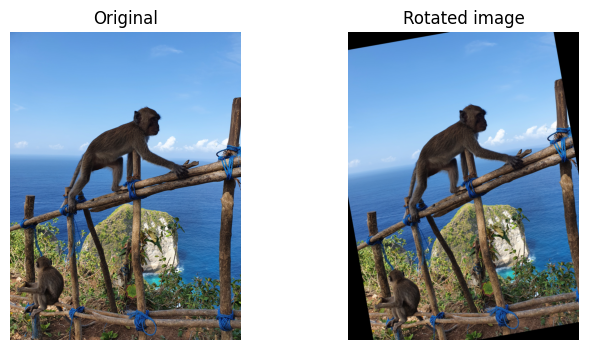

In [3]:
im_org = io.imread('data/NusaPenida.png')

rotation_angle = 10
rotated_img = rotate(im_org, rotation_angle)
show_comparison(im_org, rotated_img, "Rotated image")

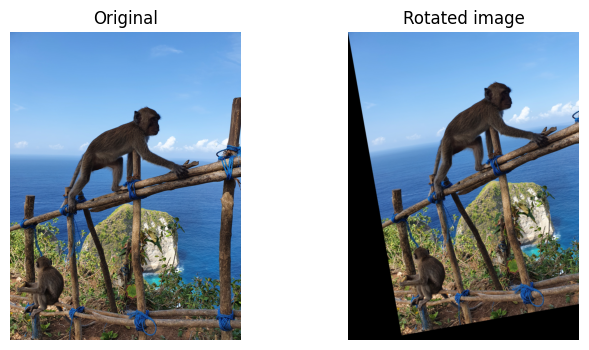

In [4]:
rot_center = [0, 0]
rotated_img = rotate(im_org, rotation_angle, center=rot_center)
show_comparison(im_org, rotated_img, "Rotated image")

#### Exercise 2

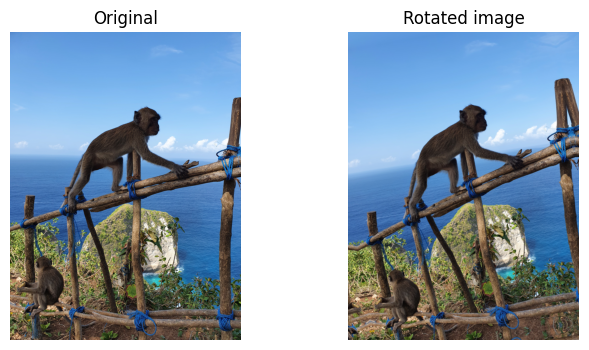

In [5]:
rotated_img = rotate(im_org, rotation_angle, mode="reflect")
show_comparison(im_org, rotated_img, "Rotated image")

#### Exercise 3

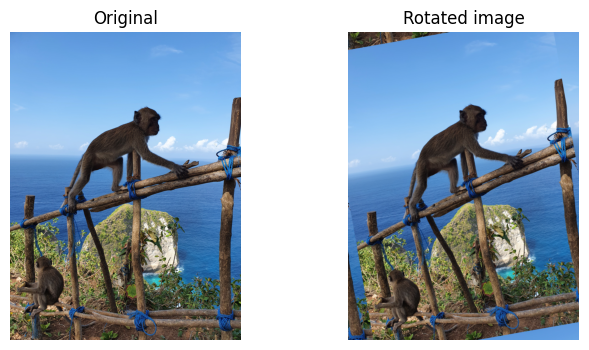

In [6]:
rotated_img = rotate(im_org, rotation_angle, mode="wrap")
show_comparison(im_org, rotated_img, "Rotated image")

#### Exercise 4

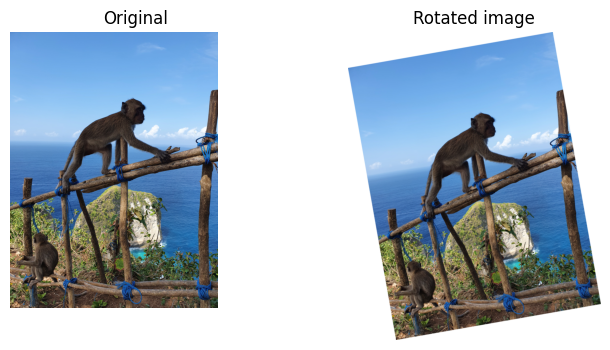

In [15]:
rotated_img = rotate(im_org, rotation_angle, resize=True, mode="constant", cval=1)
show_comparison(im_org, rotated_img, "Rotated image")

#### Exercise 5

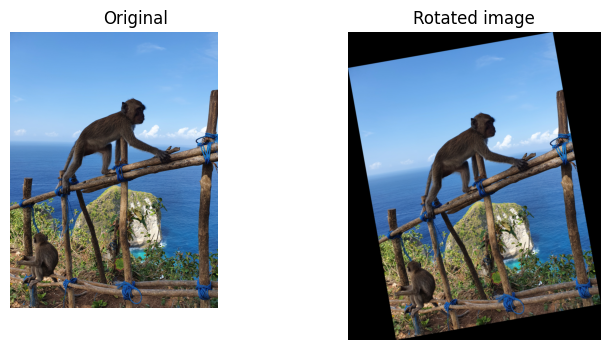

In [16]:
rotated_img = rotate(im_org, rotation_angle, resize=True)
show_comparison(im_org, rotated_img, "Rotated image")

### Euclidean image transformation

#### Exercise 6

In [17]:
# angle in radians - counter clockwise
rotation_angle = 10.0 * math.pi / 180.
trans = [10, 20]
tform = EuclideanTransform(rotation=rotation_angle, translation=trans)
print(tform.params)

[[ 0.98480775 -0.17364818 10.        ]
 [ 0.17364818  0.98480775 20.        ]
 [ 0.          0.          1.        ]]


#### Exercise 7

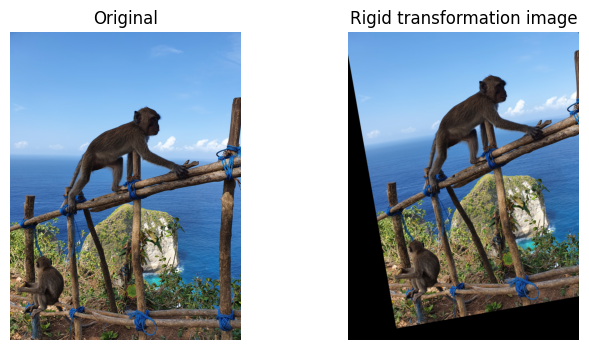

In [18]:
transformed_img = warp(im_org, tform)
show_comparison(im_org, transformed_img, "Rigid transformation image")

### Inverse transformation

#### Exercise 8

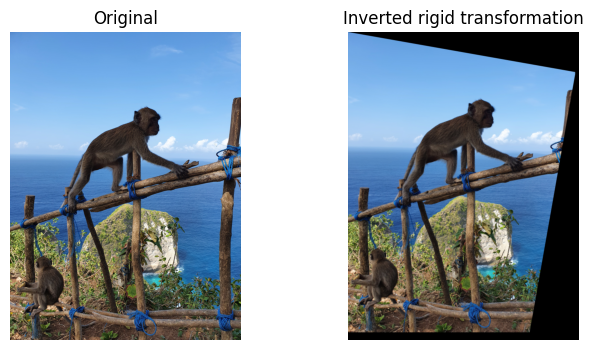

In [19]:
rotation_angle = 10.0 * math.pi / 180.
trans = [0, 0]
tform = EuclideanTransform(rotation=rotation_angle, translation=trans)
transformed_img = warp(transformed_img, tform.inverse)

show_comparison(im_org, transformed_img, "Inverted rigid transformation")

### Similarity transform of image

#### Exercise 9

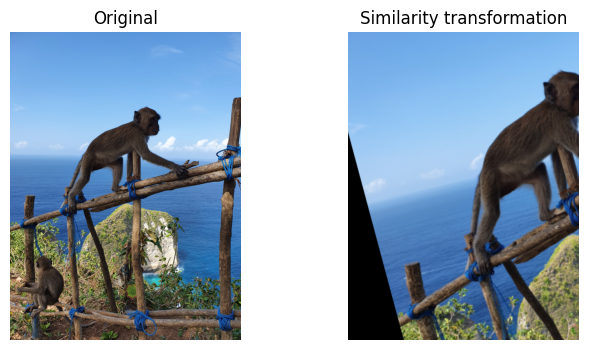

In [20]:
rotation_angle = 15.0 * math.pi / 180.
trans = [40, 30]
scale = 0.6
tform = SimilarityTransform(scale = scale, rotation = rotation_angle, translation = trans)

recovered_img = warp(transformed_img, tform)
show_comparison(im_org, recovered_img, "Similarity transformation")

### The swirl image transformation

#### Exercise 10

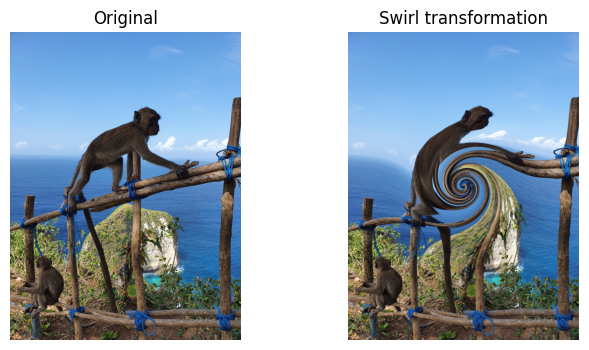

In [21]:
str = 10
rad = 300
swirl_img = swirl(im_org, strength=str, radius=rad)

show_comparison(im_org, swirl_img, 'Swirl transformation')

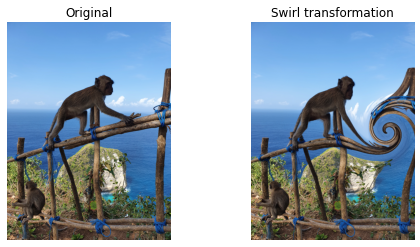

In [14]:
str = 10
rad = 300
c = [500, 400]
swirl_img = swirl(im_org, strength=str, radius=rad, center=c)
show_comparison(im_org, swirl_img, 'Swirl transformation')

## Landmark based registration

#### Exercise 11

In [22]:
src_img = io.imread('data/Hand1.jpg')
dst_img = io.imread('data/Hand2.jpg')

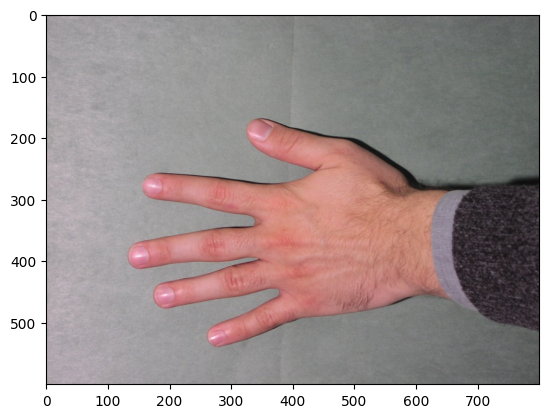

In [23]:
plt.imshow(src_img)

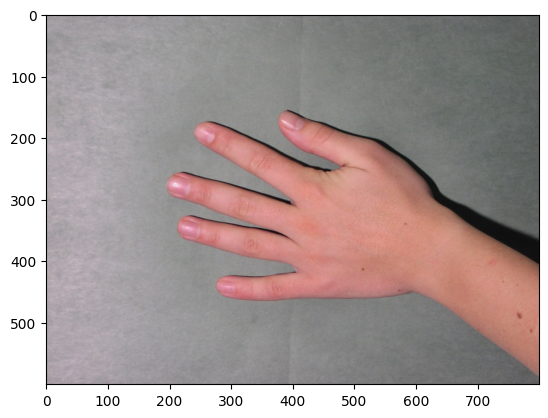

In [24]:
plt.imshow(dst_img)

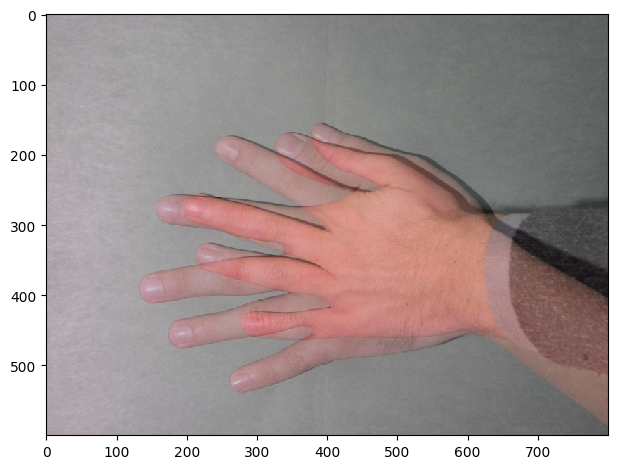

In [25]:
blend = 0.5 * img_as_float(src_img) + 0.5 * img_as_float(dst_img)
io.imshow(blend)
io.show()

### Manual landmark annotation

#### Exercise 12

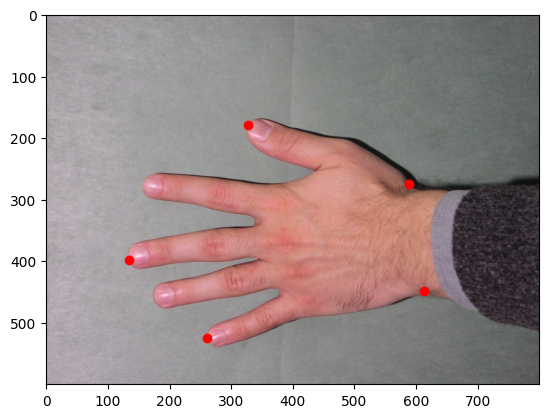

In [26]:
src = np.array([[588, 274], [328, 179], [134, 398], [260, 525], [613, 448]])

plt.imshow(src_img)
plt.plot(src[:, 0], src[:, 1], '.r', markersize=12)
plt.show()

#### Exercise 13

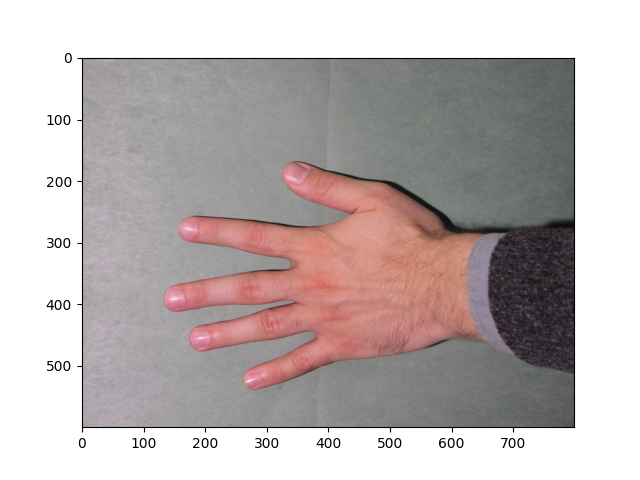

In [27]:
# Change the backend to be able to explore the pixel intensities
# For VSCode Notebooks and JupyterNotebook "%matplotlib widget"
# For Spyder "%matplotlib auto"

%matplotlib widget 
plt.imshow(src_img)
plt.show()

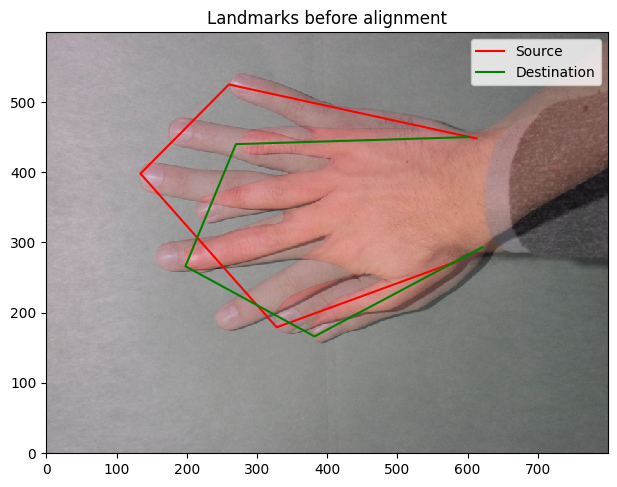

In [28]:
%matplotlib inline 

dst = np.array([[621, 293], [382, 166], [198, 266], [270, 440], [600, 450]])

fig, ax = plt.subplots()
io.imshow(blend)
ax.plot(src[:, 0], src[:, 1], '-r', markersize=12, label="Source")
ax.plot(dst[:, 0], dst[:, 1], '-g', markersize=12, label="Destination")
ax.invert_yaxis()
ax.legend()
ax.set_title("Landmarks before alignment")
plt.show()

#### Exercise 14

In [29]:
e_x = src[:, 0] - dst[:, 0]
error_x = np.dot(e_x, e_x)
e_y = src[:, 1] - dst[:, 1]
error_y = np.dot(e_y, e_y)
f = error_x + error_y
print(f"Landmark alignment error F: {f}")

Landmark alignment error F: 33553


In [30]:
tform = EuclideanTransform()
tform.estimate(src, dst)

src_transform = matrix_transform(src, tform.params)

#### Exercise 15

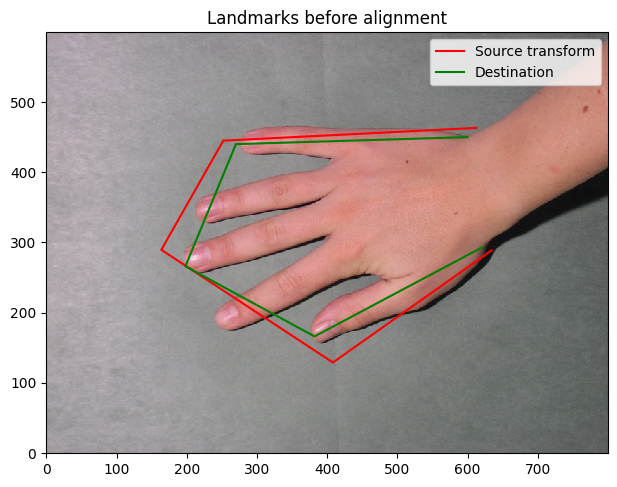

In [31]:
fig, ax = plt.subplots()
io.imshow(dst_img)
ax.plot(src_transform[:, 0], src_transform[:, 1], '-r', markersize=12, label="Source transform")
ax.plot(dst[:, 0], dst[:, 1], '-g', markersize=12, label="Destination")
ax.invert_yaxis()
ax.legend()
ax.set_title("Landmarks before alignment")
plt.show()

In [32]:
e_x = src_transform[:, 0] - dst[:, 0]
error_x = np.dot(e_x, e_x)
e_y = src_transform[:, 1] - dst[:, 1]
error_y = np.dot(e_y, e_y)
f = error_x + error_y
print(f"Landmark alignment error F: {f}")

Landmark alignment error F: 4676.551112578083


#### Exercise 16

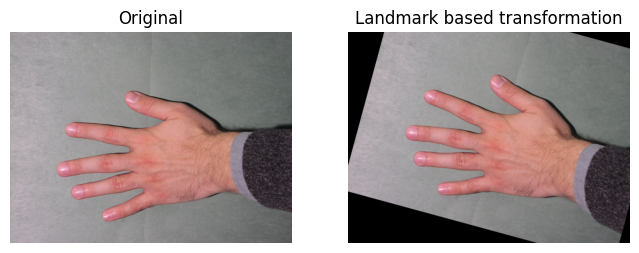

In [33]:
warped = warp(src_img, tform.inverse)
show_comparison(src_img, warped, 'Landmark based transformation')

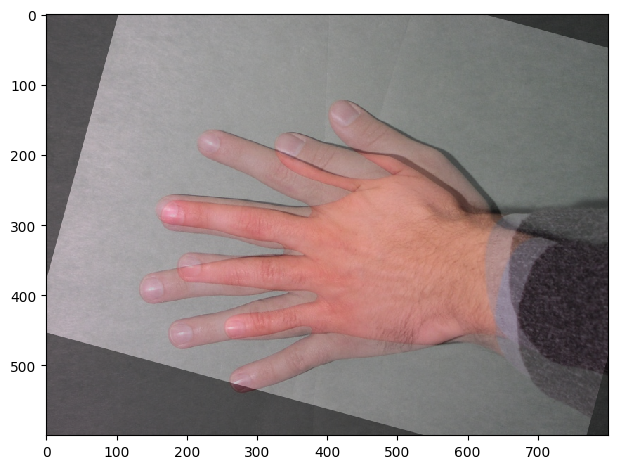

In [34]:
blend = 0.5 * img_as_float(src_img) + 0.5 * img_as_float(warped)
io.imshow(blend)
io.show()

## Video transformations

#### Exercise 16

In [35]:
!python Ex7-VideoImageTransformations.py

Starting image capture
Opening connection to camera
Starting camera loop
Stopping image loop


#### Exercise 17

In [36]:
!python Ex7-VideoImageTransformations_solution.py

Starting image capture
Opening connection to camera
Starting camera loop
Stopping image loop


# Exercise 8 - Cats, Cats, Cats

In [ ]:
from skimage import io
from skimage.util import img_as_ubyte
import matplotlib.pyplot as plt
import numpy as np
import glob
from sklearn.decomposition import PCA
from skimage.transform import SimilarityTransform
from skimage.transform import warp
import os
import pathlib

from auxiliaryFuns import *

**Exercise 1:** *Preprocess all image in the training set. To do the preprocessing, you can use the code snippets supplied*

In [ ]:
raw_dir = "data/training_data/"
preprocess_dir = "data/preprocessed_data/"

if not os.path.exists(preprocess_dir):
    os.makedirs(preprocess_dir)
    
preprocess_all_cats(raw_dir, preprocess_dir)

## Gathering data into a data matrix


**Exercise 2:** *Compute the data matrix.* 


In [ ]:
files = glob.glob(f"{preprocess_dir}/*.jpg")

height, width, channels = io.imread(files[0]).shape
data_matrix = np.zeros((len(files), height * width * channels))
for i, f in enumerate(files):
    data_matrix[i, :] = io.imread(f).flatten()


## Compute and visualize a mean cat



**Exercise 3:** *Compute the average cat.*

In [ ]:
average_cat = np.mean(data_matrix, axis=0)


**Exercise 4:** *Visualize the Mean Cat* 


In [ ]:
average_cat_img = create_u_byte_image_from_vector(average_cat, height, width, channels)
fig, ax = plt.subplots(1, 1, figsize=(6, 6))
plt.imshow(average_cat_img)
ax.set_title("Mean cat")
ax.set_axis_off()
plt.show()


## Find a missing cat or a cat that looks like it (using image comparison)

**Exercise 5:** *Decide that you quickly buy a new cat that looks very much like the missing cat - so nobody notices* 


In [ ]:
# :)

**Exercise 6:** Use the preprocess_one_cat function to preprocess the photo of the poor missing cat


In [ ]:
preprocess_one_cat()
# First image is the missing cat, second one the model cat 
# and the third one is the missing cat aligned and cropped
# Now there is a new file data/MissingCatProcessed.jpg

**Exercise 7:** *Flatten the pixel values of the missing cat so it becomes a vector of values.*


In [ ]:
im_miss = io.imread("data/MissingCatProcessed.jpg")
im_miss_flat = im_miss.flatten()

**Exercise 8:** *Subtract you missing cat data from all the rows in the data_matrix and for each row compute the sum of squared differences. This can for example be done by:*

In [ ]:
sub_data = data_matrix - im_miss_flat
sub_distances = np.linalg.norm(sub_data, axis=1)

**Exercise 9:** *Find the training cat that looks most like your missing cat by finding the cat, where the SSD is smallest. You can for example use `np.argmin`.*

In [ ]:
min_idx = np.argmin(sub_distances)


**Exercise 10:** *Extract the found cat from the data_matrix and use `create_u_byte_image_from_vector` to create an image that can be visualized. Did you find a good replacement cat?*


In [ ]:
similar_cat = create_u_byte_image_from_vector(data_matrix[min_idx, :], height, width, channels)

fig, ax = plt.subplots(1, 1, figsize=(6, 6))
plt.imshow(similar_cat)
ax.set_title("Similar cat")
ax.set_axis_off()
plt.show()


**Exercise 11:** *You can use `np.argmax` to find the cat that looks the least like the missing cat.*

In [ ]:
max_idx = np.argmax(sub_distances)
different_cat = create_u_byte_image_from_vector(data_matrix[max_idx, :], height, width, channels)
fig, ax = plt.subplots(1, 1, figsize=(6, 6))
plt.imshow(different_cat)
ax.set_title("Different cat")
ax.set_axis_off()
plt.show()

## Principal component analysis on the cats 

**Exercise 12:** *Start by computing the first 50 principal components:*

In [ ]:
print("Computing PCA")
cats_pca = PCA(n_components=50)
cats_pca.fit(data_matrix)

**Exercise 13:** *Plot the amount of the total variation explained by each component as function of the component number.*

In [ ]:
explained_variance = cats_pca.explained_variance_ratio_
fig, ax = plt.subplots(1,2, figsize=(10,4))
ax[0].plot(explained_variance)
ax[0].set_ylabel("Ratio of explained variance")
ax[0].set_xlabel("Component number")
ax[1].plot(explained_variance.cumsum())
ax[1].set_ylabel("Accumulative explained variance")
ax[1].set_xlabel("Number of components")
plt.show()

**Exercise 14:** *How much of the total variation is explained by the first component?*

In [ ]:
print("The first component explains {:.2f}% of the variance".format(explained_variance[0] * 100))

**Exercise 15:** *Project the cat images into PCA space*:

In [ ]:
components = cats_pca.transform(data_matrix)

**Exercise 16:** *Plot the PCA space by plotting all the cats first and second PCA coordinates in a (x, y) plot*

In [ ]:
pc_1 = components[:, 0] 
pc_2 = components[:, 1]
fig, ax = plt.subplots(1, 1, figsize=(6, 6))
ax.plot(pc_1, pc_2, "o")
ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
plt.show()

## Cats in space


### Extreme cats

**Exercise 17:** *Use `np.argmin` and `np.argmax` to find the ids of the cats that have extreme values in the first and second PCA coordinates. Extract the cats data from the data matrix and use `create_u_byte_image_from_vector` to visualize these cats. Also plot the PCA space where you plot the extreme cats with another marker and color.*

In [ ]:
def nargmax(arr, n):
    # Like np.argmax but returns the n largest values
    idx = np.argpartition(arr, -n)[-n:]
    return idx[np.argsort(arr[idx])][::-1]

def nargmin(arr, n):
    # Like np.argmin but returns the n smallest values
    idx = np.argpartition(arr, n)[:n]
    return idx[np.argsort(arr[idx])]

def plot_pca_space_and_img(pc_idx):
    _, ax = plt.subplots(1, 2, figsize=(6, 3))
    ax[0].plot(pc_1, pc_2, "o")
    ax[0].plot(pc_1[pc_idx], pc_2[pc_idx], "ro", markersize=10)
    ax[0].set_xlabel("PC1")
    ax[0].set_ylabel("PC2")
    
    img = create_u_byte_image_from_vector(data_matrix[pc_idx, :], height, width, channels)
    ax[1].imshow(img)
    ax[1].set_title("Cat")
    ax[1].set_axis_off()
    plt.show()

In [ ]:
# Check the 4 largest values of PC1
max_pc1s = nargmax(pc_1, 4)
for i in max_pc1s:
    plot_pca_space_and_img(i)

In [ ]:
# Check the 4 smallest values of PC1
min_pc1s = nargmin(pc_1, 4)
for i in min_pc1s:
    plot_pca_space_and_img(i)

In [ ]:
# Check the 4 largest values of PC2
max_pc2s = nargmax(pc_2, 4)
for i in max_pc2s:
    plot_pca_space_and_img(i)

In [ ]:
# Check the 4 smallest values of PC2
min_pc2s = nargmin(pc_2, 4)
for i in min_pc2s:
    plot_pca_space_and_img(i)


**Exercise 18:** *How do these extreme cat photo look like? Are some actually of such bad quality that they should be removed from the training set? If you remove images from the training set, then you should run the PCA again. Do this until you are satisfied with the quality of the training data.*


In [ ]:
filtered_matrix = data_matrix.copy()

# Remove the 8 largest values of PC1, 5 smallest values of PC1,
# 5 largest values of PC2 and 5 smallest values of PC2
max_pc1s = nargmax(pc_1, 8)
min_pc1s = nargmin(pc_1, 5)
max_pc2s = nargmax(pc_2, 5)
min_pc2s = nargmin(pc_2, 5)

remove_idx = np.concatenate((max_pc1s, min_pc1s, max_pc2s, min_pc2s))
filtered_matrix = np.delete(filtered_matrix, remove_idx, axis=0)

# Recompute PCA
cats_pca = PCA(n_components=50)
cats_pca.fit(filtered_matrix)
components = cats_pca.transform(filtered_matrix)

In [ ]:
pc_1 = components[:, 0] 
pc_2 = components[:, 1]
fig, ax = plt.subplots(1, 1, figsize=(6, 6))
ax.plot(pc_1, pc_2, "o")
ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
plt.show()

### The first synthesized cat
**Exercise 19:** *Create your first fake cat using the average image and the first principal component. You should choose experiment with different weight values (w)* :

In [ ]:
print("Maximal value of PC1: {:.8f}".format(np.max(cats_pca.components_[0, :])))
print("Minimal value of PC1: {:.8f}".format(np.min(cats_pca.components_[0, :])))

In [ ]:
w = 60000
synth_cat = average_cat + w * cats_pca.components_[0, :]

**Exercise 20:** *Use `create_u_byte_image_from_vector` visualize your fake cat.*

In [ ]:
synth_cat_img = create_u_byte_image_from_vector(synth_cat, height, width, channels)
plt.imshow(synth_cat_img)
plt.show()

**Exercise 21:** *Synthesize some cats, where you use both the first and second principal components and select their individual weights based on the PCA plot.*

In [ ]:
print("Maximal value of PC2: {:.8f}".format(np.max(cats_pca.components_[1, :])))
print("Minimal value of PC2: {:.8f}".format(np.min(cats_pca.components_[1, :])))

In [ ]:
w0, w1 = 60000, 60000
synth_cat = average_cat + w0 * cats_pca.components_[0, :] + w1 * cats_pca.components_[1, :]
synth_cat_img = create_u_byte_image_from_vector(synth_cat, height, width, channels)
plt.imshow(synth_cat_img)
plt.show()

### The major cat variation in the data set


**Exercise 22:** *Synthesize and visualize cats that demonstrate the first three major modes of variation. Try show the average cat in the middle of a plot, with the negative sample to the left and the positive to the right. Can you recognise some visual patterns in these modes of variation?*

In [ ]:
def visualize_mode_of_variation(m):
    synth_cat_plus = average_cat + 3 * np.sqrt(cats_pca.explained_variance_[m]) * cats_pca.components_[m, :]
    synth_cat_minus = average_cat - 3 * np.sqrt(cats_pca.explained_variance_[m]) * cats_pca.components_[m, :]
    
    fig, ax = plt.subplots(1, 3, figsize=(12, 4))
    ax[0].imshow(create_u_byte_image_from_vector(synth_cat_minus, height, width, channels))
    ax[0].set_title("Cat - 3$\sigma$")
    ax[1].imshow(create_u_byte_image_from_vector(average_cat, height, width, channels))
    ax[1].set_title("Average cat")
    ax[2].imshow(create_u_byte_image_from_vector(synth_cat_plus, height, width, channels))
    ax[2].set_title("Cat + 3$\sigma$")
    fig.suptitle("Mode of variation PC{}".format(m + 1))

In [ ]:
visualize_mode_of_variation(m = 0)
visualize_mode_of_variation(m = 1)
visualize_mode_of_variation(m = 2)
visualize_mode_of_variation(m = 3)

### The Cat Synthesizer (EigenCats)
**Exercise 23:** *Generate as many cat photos as your heart desires.*.


In [ ]:
def random_cat_generator():
    w = np.random.randn(50)*50000
    w = w*np.exp(-np.arange(50)) # Decrease the influence of the higher PCs
    synth_cat = average_cat + np.dot(w, cats_pca.components_)
    return create_u_byte_image_from_vector(synth_cat, height, width, channels)

In [ ]:
fig, ax = plt.subplots(1, 3, figsize=(12, 4))
ax[0].imshow(random_cat_generator())
ax[1].imshow(random_cat_generator())
ax[2].imshow(random_cat_generator())
plt.show()

## Cat identification in PCA space


**Exercise 24:** *Start by finding the PCA space coordinates of your missing cat:*


In [ ]:
im_miss = io.imread("data/MissingCatProcessed.jpg")
im_miss_flat = im_miss.flatten()
im_miss_flat = im_miss_flat.reshape(1, -1)
pca_coords = cats_pca.transform(im_miss_flat)
pca_coords = pca_coords.flatten()

**Exercise 25:** *Plot all the cats in PCA space using the first two dimensions. Plot your missing cat in the same plot, with another color and marker. Is it placed somewhere sensible and does it have close neighbours?*

In [ ]:
components = cats_pca.transform(filtered_matrix)
pc_1 = components[:, 0] 
pc_2 = components[:, 1]
fig, ax = plt.subplots(1, 1, figsize=(6, 6))
ax.plot(pc_1, pc_2, "o")
ax.plot(pca_coords[0], pca_coords[1], "ro", label="Missing cat")
ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
plt.legend()
plt.show()

**Exercise 26:** *Generate synthetic versions of your cat, where you change the n_components_to_use from 1 to for example 50.*

In [ ]:
n_components_to_use = 10
synth_cat = average_cat
for idx in range(n_components_to_use):
	synth_cat = synth_cat + pca_coords[idx] * cats_pca.components_[idx, :]

fig, ax = plt.subplots(ncols=2, figsize=(16, 6))
ax[0].imshow(im_miss)
ax[0].set_title('The Real Missing Cat')
ax[1].imshow(create_u_byte_image_from_vector(synth_cat, height, width, channels))
ax[1].set_title('The Synthetic Missing cat')
for a in ax:
	a.axis('off')
plt.tight_layout()
plt.show()

**Exercise 27:** *Find the id of the cat that has the smallest and largest distance in PCA space to your missing cat. Visualize these cats. Are they as you expected? Do you think your friends and family will notice a difference?*

In [ ]:
comp_sub = components - pca_coords
pca_distances = np.linalg.norm(comp_sub, axis=1)

best_match = np.argmin(pca_distances)
best_twin_cat = data_matrix[best_match, :]
worst_match = np.argmax(pca_distances)
worst_twin_cat = data_matrix[worst_match, :]
fig, ax = plt.subplots(ncols=3, figsize=(16, 6))
ax[0].imshow(im_miss)
ax[0].set_title('The Real Missing Cat')
ax[1].imshow(create_u_byte_image_from_vector(best_twin_cat, height, width, channels))
ax[1].set_title('The Best Matching Twin Cat')
ax[2].imshow(create_u_byte_image_from_vector(worst_twin_cat, height, width, channels))
ax[2].set_title('The Worst Matching Twin Cat')
for a in ax:
    a.axis('off')
plt.tight_layout()
plt.show()


**Exercise 28:** *Find the ids of and visualize the 5 closest cats in PCA space. Do they look like your cat?*



In [ ]:
n_best = 5
best = np.argpartition(pca_distances, n_best)
fig, ax = plt.subplots(ncols=n_best, figsize=(16, 4))
for i in range(n_best):
    candidate_twin_cat = data_matrix[best[i], :]
    ax[i].imshow(create_u_byte_image_from_vector(candidate_twin_cat, height, width, channels))
    ax[i].axis('off')

fig.suptitle(f"The {n_best} most similar cats")
plt.tight_layout()
plt.show()


# Advanced registration

In this exercise, we will use the SimpleITK library to perform 3D image registration. You will familiarize yourself with the registration process, their challenges and the different elements you can tune to improve the registration results.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import SimpleITK as sitk
from skimage.util import img_as_ubyte
from IPython.display import clear_output

## Some useful functions

In [2]:
def imshow_orthogonal_view(sitkImage, origin = None, title=None):
    """
    Display the orthogonal views of a 3D volume from the middle of the volume.

    Parameters
    ----------
    sitkImage : SimpleITK image
        Image to display.
    origin : array_like, optional
        Origin of the orthogonal views, represented by a point [x,y,z]. 
        If None, the middle of the volume is used.
    title : str, optional
        Super title of the figure.

    Note:
    On the axial and coronal views, patient's left is on the right
    On the sagittal view, patient's anterior is on the left
    """
    data = sitk.GetArrayFromImage(sitkImage)

    if origin is None:
        origin = np.array(data.shape) // 2

    fig, axes = plt.subplots(1, 3, figsize=(12, 4))

    data = img_as_ubyte(data/np.max(data))
    axes[0].imshow(data[origin[0], ::-1, ::-1], cmap='gray')
    axes[0].set_title('Axial')

    axes[1].imshow(data[::-1, origin[1], ::-1], cmap='gray')
    axes[1].set_title('Coronal')

    axes[2].imshow(data[::-1, ::-1, origin[2]], cmap='gray')
    axes[2].set_title('Sagittal')

    [ax.set_axis_off() for ax in axes]

    if title is not None:
        fig.suptitle(title, fontsize=16)

def overlay_slices(sitkImage0, sitkImage1, origin = None, title=None):
    """
    Overlay the orthogonal views of a two 3D volume from the middle of the volume.
    The two volumes must have the same shape. The first volume is displayed in red,
    the second in green.

    Parameters
    ----------
    sitkImage0 : SimpleITK image
        Image to display in red.
    sitkImage1 : SimpleITK image
        Image to display in green.
    origin : array_like, optional
        Origin of the orthogonal views, represented by a point [x,y,z]. 
        If None, the middle of the volume is used.
    title : str, optional
        Super title of the figure.

    Note:
    On the axial and coronal views, patient's left is on the right
    On the sagittal view, patient's anterior is on the left    """
    vol0 = sitk.GetArrayFromImage(sitkImage0)
    vol1 = sitk.GetArrayFromImage(sitkImage1)

    if vol0.shape != vol1.shape:
        raise ValueError('The two volumes must have the same shape.')
    if np.min(vol0) < 0 or np.min(vol1) < 0: # Remove negative values - Relevant for the noisy images
        vol0[vol0 < 0] = 0
        vol1[vol1 < 0] = 0
    if origin is None:
        origin = np.array(vol0.shape) // 2

    sh = vol0.shape
    # min_val = np.min([np.min(vol0), np.min(vol1)])
    # max_val = np.max([np.max(vol0), np.max(vol1)])
    R = img_as_ubyte(vol0/np.max(vol0))
    G = img_as_ubyte(vol1/np.max(vol1))

    vol_rgb = np.zeros(shape=(sh[0], sh[1], sh[2], 3), dtype=np.uint8)
    vol_rgb[:, :, :, 0] = R
    vol_rgb[:, :, :, 1] = G

    fig, axes = plt.subplots(1, 3, figsize=(12, 4))

    axes[0].imshow(vol_rgb[origin[0], ::-1, ::-1, :])
    axes[0].set_title('Axial')

    axes[1].imshow(vol_rgb[::-1, origin[1], ::-1, :])
    axes[1].set_title('Coronal')

    axes[2].imshow(vol_rgb[::-1, ::-1, origin[2], :])
    axes[2].set_title('Sagittal')

    [ax.set_axis_off() for ax in axes]

    if title is not None:
        fig.suptitle(title, fontsize=16)

In [3]:
def composite2affine(composite_transform, result_center=None):
    """
    Combine all of the composite transformation's contents to form an equivalent affine transformation.
    Args:
        composite_transform (SimpleITK.CompositeTransform): Input composite transform which contains only
                                                            global transformations, possibly nested.
        result_center (tuple,list): The desired center parameter for the resulting affine transformation.
                                    If None, then set to [0,...]. This can be any arbitrary value, as it is
                                    possible to change the transform center without changing the transformation
                                    effect.
    Returns:
        SimpleITK.AffineTransform: Affine transformation that has the same effect as the input composite_transform.
    
    Source:
        https://github.com/InsightSoftwareConsortium/SimpleITK-Notebooks/blob/master/Python/22_Transforms.ipynb
    """
    # Flatten the copy of the composite transform, so no nested composites.
    flattened_composite_transform = sitk.CompositeTransform(composite_transform)
    flattened_composite_transform.FlattenTransform()
    tx_dim = flattened_composite_transform.GetDimension()
    A = np.eye(tx_dim)
    c = np.zeros(tx_dim) if result_center is None else result_center
    t = np.zeros(tx_dim)
    for i in range(flattened_composite_transform.GetNumberOfTransforms() - 1, -1, -1):
        curr_tx = flattened_composite_transform.GetNthTransform(i).Downcast()
        # The TranslationTransform interface is different from other
        # global transformations.
        if curr_tx.GetTransformEnum() == sitk.sitkTranslation:
            A_curr = np.eye(tx_dim)
            t_curr = np.asarray(curr_tx.GetOffset())
            c_curr = np.zeros(tx_dim)
        else:
            A_curr = np.asarray(curr_tx.GetMatrix()).reshape(tx_dim, tx_dim)
            c_curr = np.asarray(curr_tx.GetCenter())
            # Some global transformations do not have a translation
            # (e.g. ScaleTransform, VersorTransform)
            get_translation = getattr(curr_tx, "GetTranslation", None)
            if get_translation is not None:
                t_curr = np.asarray(get_translation())
            else:
                t_curr = np.zeros(tx_dim)
        A = np.dot(A_curr, A)
        t = np.dot(A_curr, t + c - c_curr) + t_curr + c_curr - c

    return sitk.AffineTransform(A.flatten(), t, c)

### Loading and 3D image and ortho view visualization
**Exercise 1**: Load the ImgT1.nii image and visualize its three ortho-views in one plot being the axial, sagittal, and coronal views

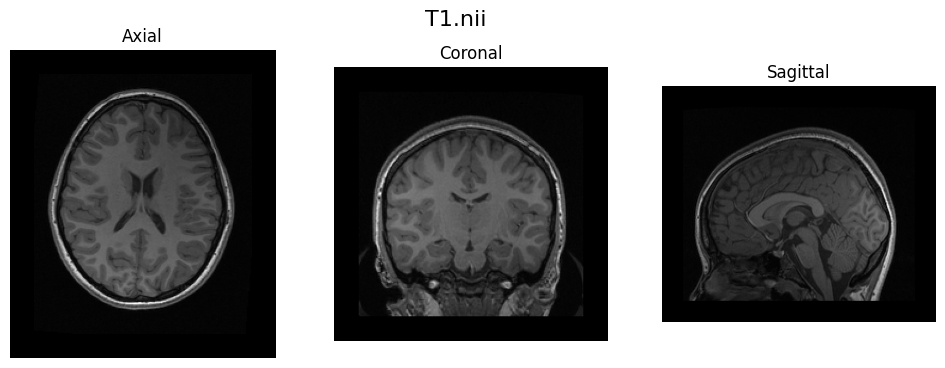

In [4]:
dir_in = 'data/'
vol_sitk = sitk.ReadImage(dir_in + 'ImgT1.nii')

# Display the volume
imshow_orthogonal_view(vol_sitk, title='T1.nii')

## Apply an affine transformation

**Exercise 2**: Write a function ```rotation_matrix(pitch, roll, yaw)``` which returns the rotation matrix for a given a roll, pitch, yaw. Make a 4x4 affine matrix with a pitch of 25 degrees.

In [5]:
def rotation_matrix(pitch, roll, yaw, deg = False):
    """
    Return the rotation matrix associated with the Euler angles roll, pitch, yaw.
    
    Parameters
    ----------
    pitch : float
        The rotation angle around the x-axis.
    roll : float
        The rotation angle around the y-axis.
    yaw : float
        The rotation angle around the z-axis.
    deg : bool, optional
        If True, the angles are given in degrees. If False, the angles are given
        in radians. Default: False.
    """
    if deg:
        roll = np.deg2rad(roll)
        pitch = np.deg2rad(pitch)
        yaw = np.deg2rad(yaw)

    R_x = np.array([[1, 0,             0,             0],
                    [0, np.cos(pitch),  -np.sin(pitch),  0],
                    [0, np.sin(pitch), np.cos(pitch),  0],
                    [0, 0,             0,             1]])

    R_y = np.array([[np.cos(roll), 0, np.sin(roll), 0],
                    [0, 1, 0, 0],
                    [-np.sin(roll), 0, np.cos(roll), 0],
                    [0, 0, 0, 1]])

    R_z = np.array([[np.cos(yaw),  -np.sin(yaw), 0, 0],
                    [np.sin(yaw), np.cos(yaw),  0, 0],
                    [0, 0, 1, 0],
                    [0, 0, 0, 1]])

    R = np.dot(np.dot(R_x, R_y), R_z)

    return R

In [6]:
# The point of this exercise is that you test your understanding of the rotation matrix, and that you have implemented it properly.

**Exercise 3**: Apply the rotation to the ImgT1.nii and save the rotated images as ImgT1_A.nii

In [7]:
# Define the roll rotation in radians
angle = 25  # degrees
pitch_radians = np.deg2rad(angle)

# Create the Affine transform and set the rotation
transform = sitk.AffineTransform(3)

centre_image = np.array(vol_sitk.GetSize()) / 2 - 0.5 # Image Coordinate System
centre_world = vol_sitk.TransformContinuousIndexToPhysicalPoint(centre_image) # World Coordinate System
rot_matrix = rotation_matrix(pitch_radians, 0, 0)[:3, :3] # SimpleITK inputs the rotation and the translation separately

transform.SetCenter(centre_world) # Set the rotation centre
transform.SetMatrix(rot_matrix.T.flatten())

# Apply the transformation to the image
ImgT1_A = sitk.Resample(vol_sitk, transform)

# Save the rotated image
sitk.WriteImage(ImgT1_A, dir_in + 'ImgT1_A.nii')

**Exercise 4**: Visualise ImgT1_A in ortho view and show the rotated image.

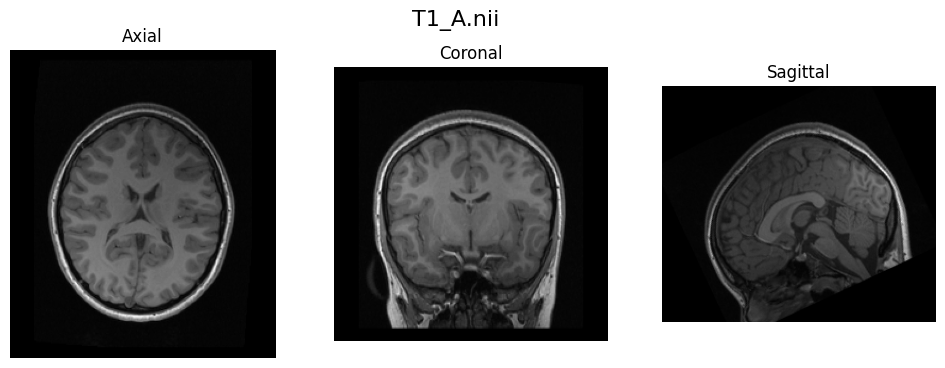

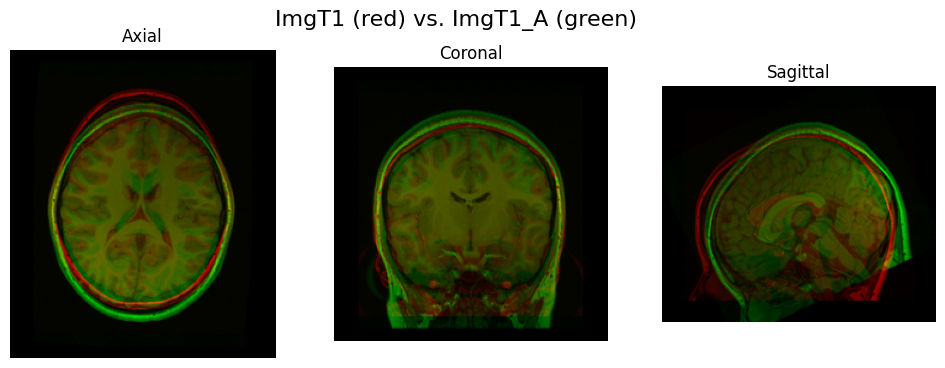

In [8]:
imshow_orthogonal_view(ImgT1_A, title='T1_A.nii')
overlay_slices(vol_sitk, ImgT1_A, title = 'ImgT1 (red) vs. ImgT1_A (green)')

## Registration of a moving image to a fixed image

**Exercise 5**: Find the geometrical transformation of the moving image to the fixed image. The moving image is ImgT1_A.nii and the fixed image is ImgT1.nii. The new rotated image is named ImgT1_B.nii and the optimal affine transformation matrix text file is named A1.txt. You can try to modify the metric and optimizer step length.

In [9]:
# Callback invoked when the StartEvent happens, sets up our new data.
def start_plot():
    global metric_values, multires_iterations
    
    metric_values = []
    multires_iterations = []

# Callback invoked when the EndEvent happens, do cleanup of data and figure.
def end_plot():
    global metric_values, multires_iterations
    
    del metric_values
    del multires_iterations
    # Close figure, we don't want to get a duplicate of the plot latter on.
    plt.close()

# Callback invoked when the IterationEvent happens, update our data and display new figure.
def plot_values(registration_method):
    global metric_values, multires_iterations
    
    metric_values.append(registration_method.GetMetricValue())                                       
    # Clear the output area (wait=True, to reduce flickering), and plot current data
    clear_output(wait=True)
    # Plot the similarity metric values
    plt.plot(metric_values, 'r')
    plt.plot(multires_iterations, [metric_values[index] for index in multires_iterations], 'b*')
    plt.xlabel('Iteration Number',fontsize=12)
    plt.ylabel('Metric Value',fontsize=12)
    plt.show()
    
# Callback invoked when the sitkMultiResolutionIterationEvent happens, update the index into the 
# metric_values list. 
def update_multires_iterations():
    global metric_values, multires_iterations
    multires_iterations.append(len(metric_values))

def command_iteration(method):
    print(
        f"{method.GetOptimizerIteration():3} "
        + f"= {method.GetMetricValue():10.5f} "
        + f": {method.GetOptimizerPosition()}"
    )

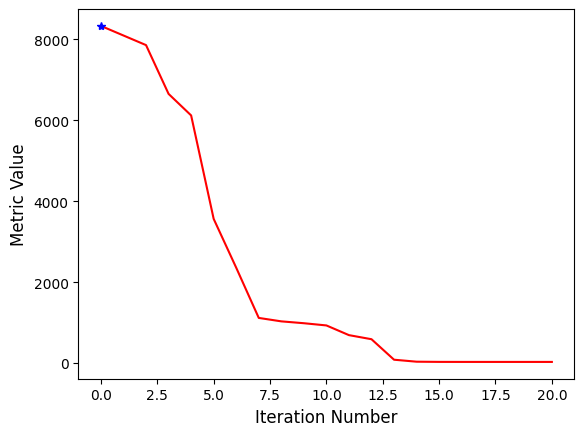

In [10]:
fixed_image = sitk.ReadImage(dir_in + 'ImgT1.nii')
moving_image = sitk.ReadImage(dir_in + 'ImgT1_A.nii')

# Set the registration method
R = sitk.ImageRegistrationMethod()
# Set the metric
R.SetMetricAsMeanSquares()

# Set the optimizer
R.SetOptimizerAsPowell(stepLength=0.1, numberOfIterations=25)

# Set the sampling strategy
R.SetMetricSamplingStrategy(R.RANDOM)
R.SetMetricSamplingPercentage(0.20)

# Set the pyramid scheule
R.SetShrinkFactorsPerLevel(shrinkFactors = [2])
R.SetSmoothingSigmasPerLevel(smoothingSigmas=[0])
R.SmoothingSigmasAreSpecifiedInPhysicalUnitsOn()

# Set the initial transform
R.SetInterpolator(sitk.sitkLinear)

# Set the initial transform 
initTransform = sitk.Euler3DTransform()
R.SetInitialTransform(initTransform, inPlace=False)

# Some extra functions to help with the iteration
# R.AddCommand(sitk.sitkIterationEvent, lambda: command_iteration(R))
R.AddCommand(sitk.sitkStartEvent, start_plot)
R.AddCommand(sitk.sitkEndEvent, end_plot)
R.AddCommand(sitk.sitkMultiResolutionIterationEvent, update_multires_iterations) 
R.AddCommand(sitk.sitkIterationEvent, lambda: plot_values(R))

tform_reg = R.Execute(fixed_image, moving_image)
ImgT1_B = sitk.Resample(moving_image, tform_reg)

# Save 
sitk.WriteImage(ImgT1_B, dir_in + 'ImgT1_B.nii')

**Exercise 6**: Show the ortho-view of the ImgT1_B.nii. Write the optimal affine matrix found. Does it agree with the expected and what is expected?

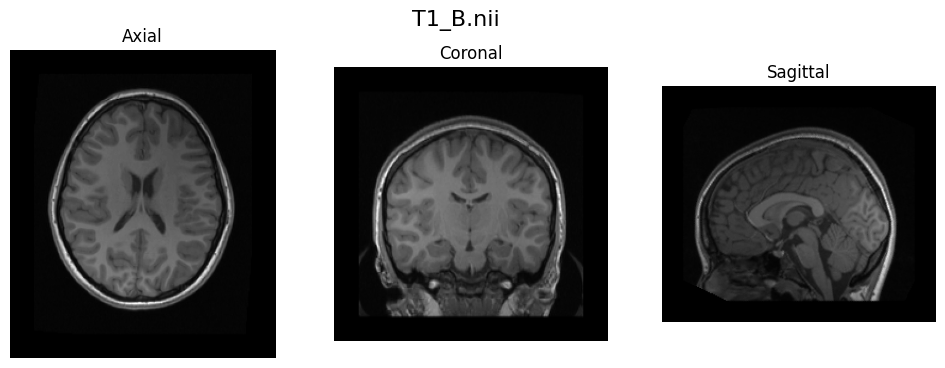

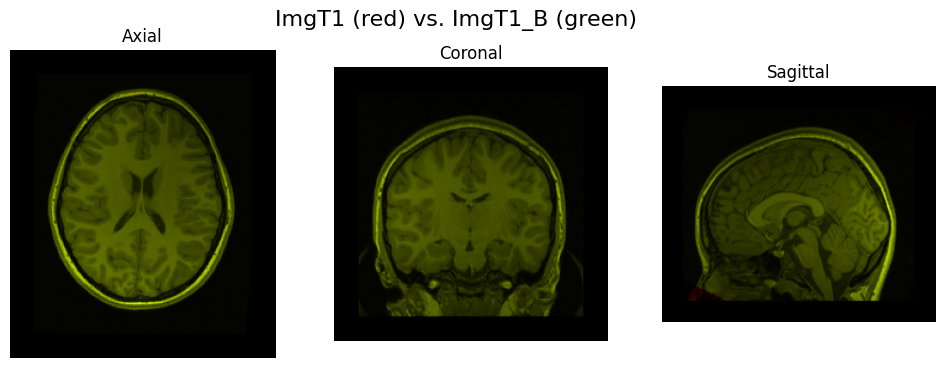

In [11]:
imshow_orthogonal_view(ImgT1_B, title='T1_B.nii')
overlay_slices(fixed_image, ImgT1_B, title = 'ImgT1 (red) vs. ImgT1_B (green)')
tform_reg.WriteTransform(dir_in + 'A1.tfm')

In [12]:
def homogeneous_matrix_from_transform(transform):
    """Convert a SimpleITK transform to a homogeneous matrix."""
    matrix = np.zeros((4, 4))
    matrix[:3, :3] = np.reshape(np.array(transform.GetMatrix()), (3, 3))
    matrix[:3, 3] = transform.GetTranslation()
    matrix[3, 3] = 1
    return matrix

In [13]:
matrix_estimated = homogeneous_matrix_from_transform(tform_reg.GetNthTransform(0))
matrix_applied = homogeneous_matrix_from_transform(transform)

print('Applied transformation matrix: ')
print(np.round(matrix_applied, 2))
print('Estimated registration matrix: ')
print(np.round(matrix_estimated, 2))

# We expect the estimated matrix to be close to the inverse of the actual matrix
print('Estimated @ Actual: ')
print(np.round(matrix_applied @ matrix_estimated, 3))
# But we dont get the identity because the centre of rotations were different!
# All the difference is in the translation component

# We can also check the individual components of the estimated matrix
print(' ')
params = tform_reg.GetParameters()
angles = params[:3]
trans = params[3:6]
print('Estimated translation: ')
print(np.round(trans, 3))
print('Estimated rotation (deg): ')
print(np.round(np.rad2deg(angles), 3))

Applied transformation matrix: 
[[ 1.    0.    0.    0.  ]
 [ 0.    0.91  0.42  0.  ]
 [ 0.   -0.42  0.91  0.  ]
 [ 0.    0.    0.    1.  ]]
Estimated registration matrix: 
[[ 1.    0.    0.    0.  ]
 [-0.    0.91 -0.42 11.16]
 [-0.    0.42  0.91 30.63]
 [ 0.    0.    0.    1.  ]]
Estimated @ Actual: 
[[ 1.0000e+00  0.0000e+00  0.0000e+00  2.0000e-03]
 [-0.0000e+00  1.0000e+00 -0.0000e+00  2.3064e+01]
 [-0.0000e+00  0.0000e+00  1.0000e+00  2.3044e+01]
 [ 0.0000e+00  0.0000e+00  0.0000e+00  1.0000e+00]]
 
Estimated translation: 
[2.0000e-03 1.1164e+01 3.0632e+01]
Estimated rotation (deg): 
[ 2.5002e+01  2.0000e-03 -2.0000e-03]


**Exercise 7**: By default, sitk.Euler3DTransform() uses the fixed image’s origin as the rotation center. Change the rotation center to the center of the image and repeat the registration. Compare the optimization and the results.

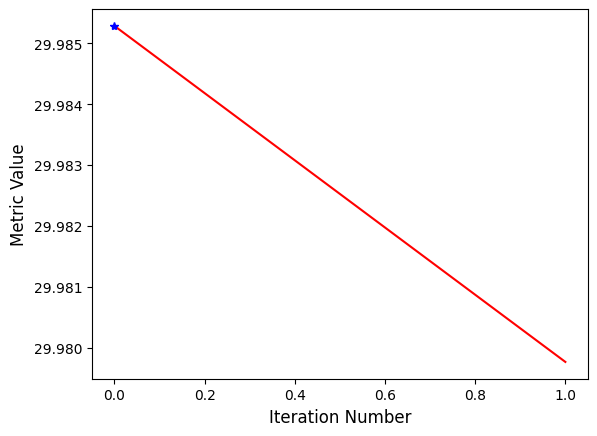

In [14]:
fixed_image = sitk.ReadImage(dir_in + 'ImgT1.nii')
moving_image = sitk.ReadImage(dir_in + 'ImgT1_A.nii')

# Set the registration method
R = sitk.ImageRegistrationMethod()
# Set the metric
R.SetMetricAsMeanSquares()

# Set the optimizer
R.SetOptimizerAsPowell(stepLength=0.1, numberOfIterations=25)

# Set the sampling strategy
R.SetMetricSamplingStrategy(R.RANDOM)
R.SetMetricSamplingPercentage(0.10)

# Set the pyramid scheule
R.SetShrinkFactorsPerLevel(shrinkFactors = [2])
R.SetSmoothingSigmasPerLevel(smoothingSigmas=[0])
R.SmoothingSigmasAreSpecifiedInPhysicalUnitsOn()

# Set the initial transform
R.SetInterpolator(sitk.sitkLinear)

# Set the initial transform 
initTransform =sitk.CenteredTransformInitializer(fixed_image, moving_image, sitk.Euler3DTransform(), sitk.CenteredTransformInitializerFilter.GEOMETRY)
R.SetInitialTransform(initTransform, inPlace=False)

# Some extra functions to help with the iteration
R.AddCommand(sitk.sitkIterationEvent, lambda: command_iteration(R))
R.AddCommand(sitk.sitkStartEvent, start_plot)
R.AddCommand(sitk.sitkEndEvent, end_plot)
R.AddCommand(sitk.sitkMultiResolutionIterationEvent, update_multires_iterations) 
R.AddCommand(sitk.sitkIterationEvent, lambda: plot_values(R))

tform_reg = R.Execute(fixed_image, moving_image)
ImgT1_B = sitk.Resample(moving_image, tform_reg)

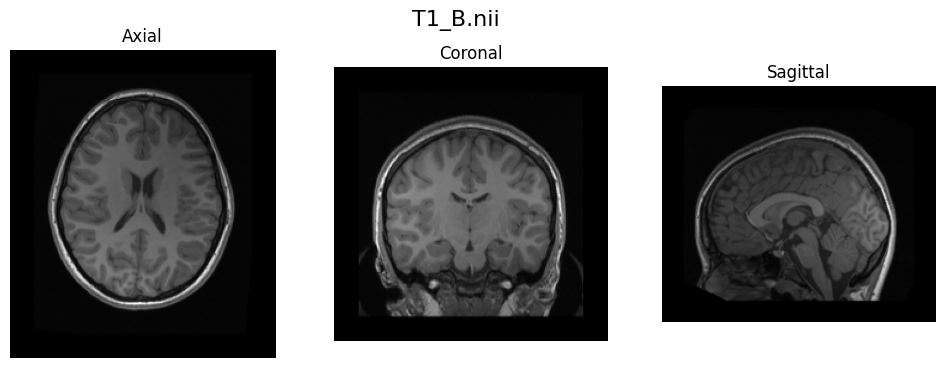

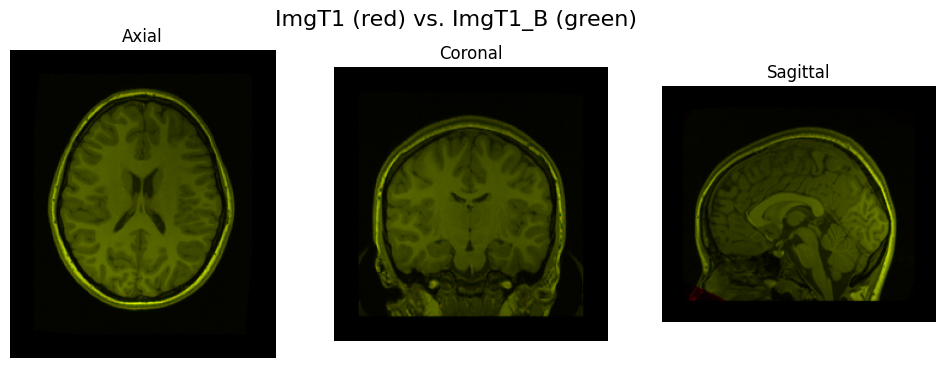

In [15]:
imshow_orthogonal_view(ImgT1_B, title='T1_B.nii')
overlay_slices(fixed_image, ImgT1_B, title = 'ImgT1 (red) vs. ImgT1_B (green)')

In [16]:
matrix_estimated = homogeneous_matrix_from_transform(tform_reg.GetNthTransform(0))
matrix_applied = homogeneous_matrix_from_transform(transform)

print('Applied transformation matrix: ')
print(np.round(matrix_applied, 2))
print('Estimated registration matrix: ')
print(np.round(matrix_estimated, 2))

# We expect the estimated matrix to be close to the inverse of the actual matrix
print('Estimated @ Actual: ')
print(np.round(matrix_applied @ matrix_estimated, 3)) # Should be identity matrix

# We can also check the individual components of the estimated matrix
print(' ')
params = tform_reg.GetParameters()
angles = params[:3]
trans = params[3:6]
print('Estimated translation: ')
print(np.round(trans, 2))
print('Estimated rotation (deg): ')
print(np.round(np.rad2deg(angles), 2))

Applied transformation matrix: 
[[ 1.    0.    0.    0.  ]
 [ 0.    0.91  0.42  0.  ]
 [ 0.   -0.42  0.91  0.  ]
 [ 0.    0.    0.    1.  ]]
Estimated registration matrix: 
[[ 1.    0.   -0.   -0.  ]
 [-0.    0.91 -0.42  0.  ]
 [ 0.    0.42  0.91  0.  ]
 [ 0.    0.    0.    1.  ]]
Estimated @ Actual: 
[[ 1.     0.    -0.    -0.002]
 [-0.     1.     0.     0.004]
 [ 0.    -0.     1.    -0.001]
 [ 0.     0.     0.     1.   ]]
 
Estimated translation: 
[-0.  0.  0.]
Estimated rotation (deg): 
[25. -0. -0.]


In [17]:
# The optimization is faster if we set the centre of rotation to the centre of the image (We are closer to the optimal solution)
# The translation component of the estimated matrix is now zero

## Generate a series of rotated 3D images 

**Exercise 8**: Make four rotation matrices that rotate the ImgT1nii in steps of 60 degrees starting from 60 degrees. Apply the rotation to ImgT1.nii, reslice and store the resulting images as ImgT1_60.nii, ImgT1_120.nii etc.  Show in ortho-view that the rotations are applied as expected for each new image.

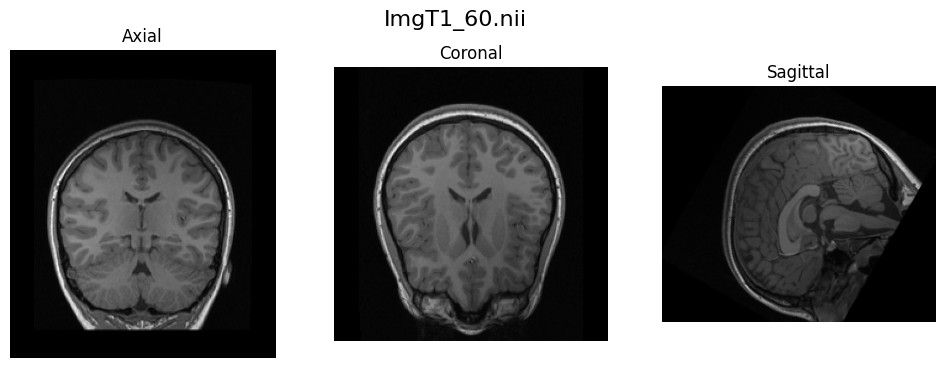

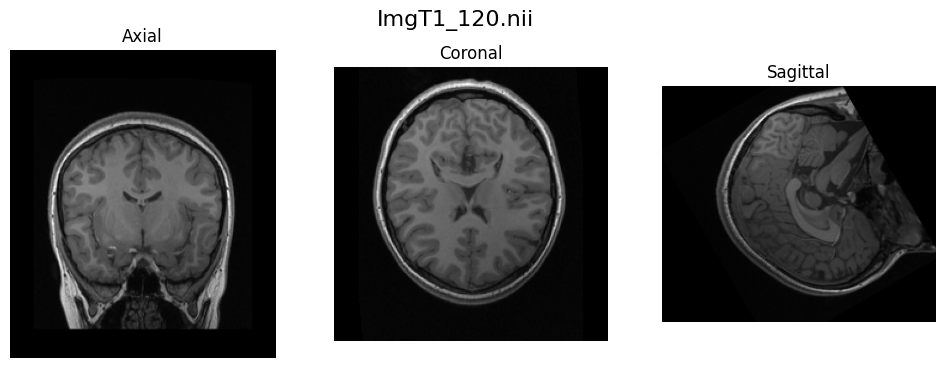

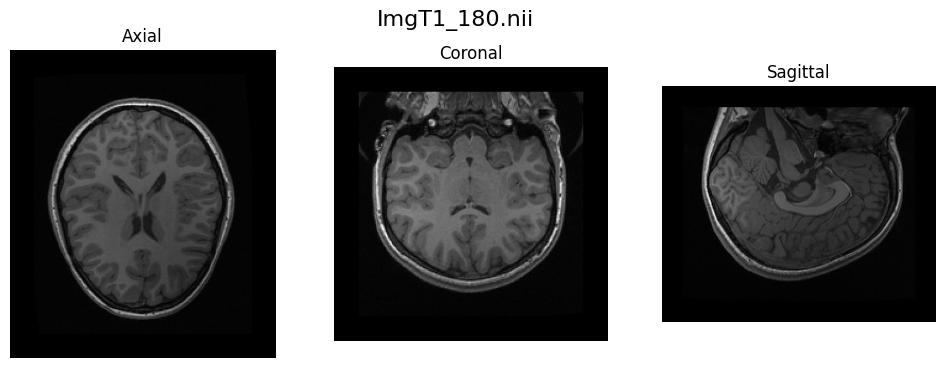

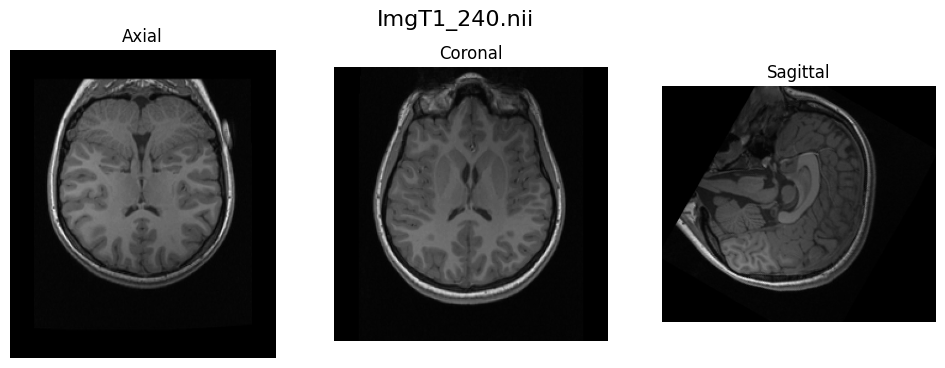

In [18]:
pitch_buffer = np.arange(1, 5)*60

for i, angle in enumerate(pitch_buffer):
    # Define the roll rotation in radians
    pitch_radians = np.deg2rad(angle)

    # Create the Affine transform and set the rotation
    transform = sitk.AffineTransform(3)

    centre_image = np.array(vol_sitk.GetSize()) / 2 - 0.5 # Image Coordinate System
    centre_world = vol_sitk.TransformContinuousIndexToPhysicalPoint(centre_image) # World Coordinate System
    rot_matrix = rotation_matrix(pitch_radians, 0, 0)[:3, :3] # SimpleITK inputs the rotation and the translation separately

    transform.SetCenter(centre_world) # Set the rotation centre
    transform.SetMatrix(rot_matrix.T.flatten())

    # Apply the transformation to the image
    output = sitk.Resample(vol_sitk, transform)

    # Visualize the rotated image
    imshow_orthogonal_view(output, title=f'ImgT1_{angle}.nii')
    
    # Save the rotated image
    sitk.WriteImage(output, f'{dir_in}ImgT1_{angle}.nii')

**Exercise 9**: Use ImgT1_120.nii as the fixed image, and the other three rotated images from Exercise 8 as the moving images. Run the registration to find the affine matrix and include the reslicing procedure for each of the moving images. Show in ortho-view the resliced images and describe what the rotation angles are. Save the transforms with the name "Ex10_60.tfm, Ex10_120.tfm, Ex10_240.tfm" Do the rotations agree with those in Exercise 8?

  0 =   12.19794 : (-2.0944291192730367, -2.6416345308304566e-05, -1.9903050792007416e-05, 0.0005625923875230115, 0.00010096938618691411, -0.003737074855100401)
  1 =   12.19686 : (-1.0471723240134043, -3.594740480433183e-05, -1.3344203689835875e-05, 0.0005304899575623965, 0.0003992320398357478, -0.00305100057442521)
  2 =   12.19678 : (-1.0471819581644068, -2.797917666147302e-05, -1.0256097505185444e-05, 0.0005011890383917446, 0.0002248583664646024, -0.0027119861317896005)
  3 =   12.19672 : (-1.0471800992031954, -2.7234847728941515e-05, -1.0951981024052618e-05, 0.00044706588076120026, 9.744230340074842e-05, -0.002734141114033087)
Estimated rotation (deg) for ImgT1_60.nii: 
[-5.9999e+01 -2.0000e-03 -1.0000e-03]
  0 =   29.78763 : (39.793470635505685, -1.0860301544988734e-05, 1.9576134513212418e-05, -0.0011140843233718326, -0.003977213400820082, 0.003917148454147579)
  1 =   29.78478 : (19.89669402280578, -2.084541411886678e-05, 1.1450746439560842e-05, -0.00039504017731975544, -0.00312

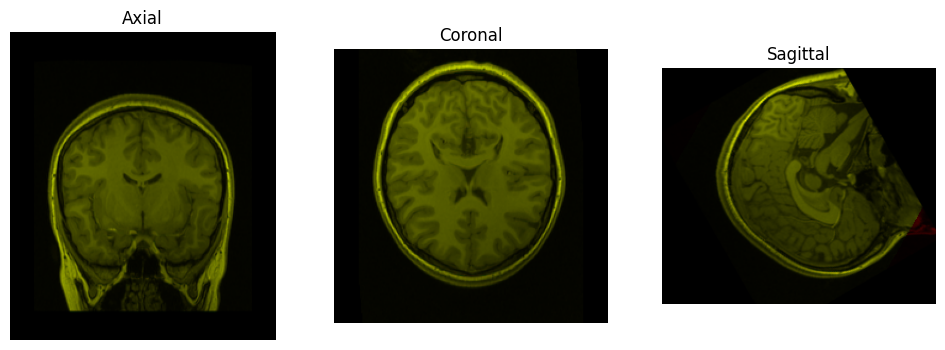

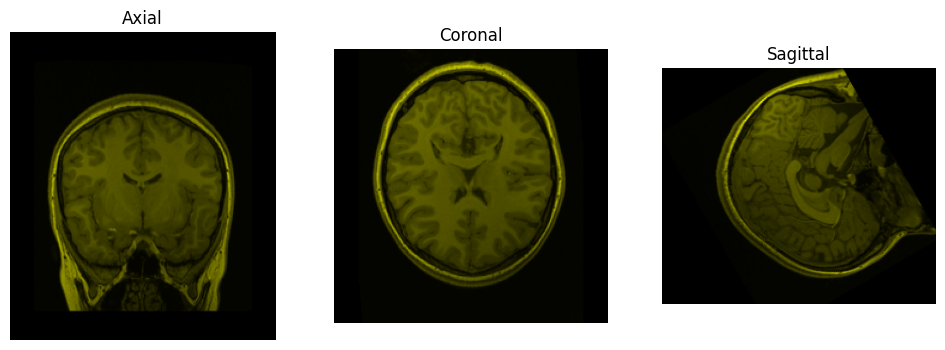

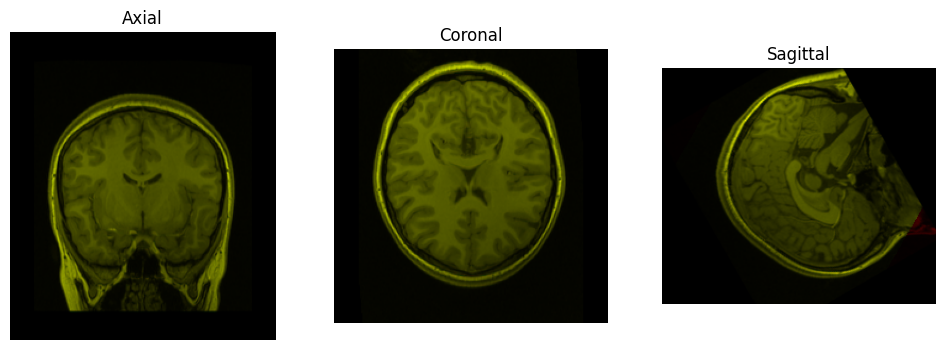

In [19]:
# Set the registration method
R = sitk.ImageRegistrationMethod()
# Set the metric
R.SetMetricAsMeanSquares()

# Set the optimizer
R.SetOptimizerAsPowell(stepLength=20, numberOfIterations=25)

# Set the sampling strategy
R.SetMetricSamplingStrategy(R.RANDOM)
R.SetMetricSamplingPercentage(0.20)

# Set the pyramid scheule
R.SetShrinkFactorsPerLevel(shrinkFactors = [2])
R.SetSmoothingSigmasPerLevel(smoothingSigmas=[0])
R.SmoothingSigmasAreSpecifiedInPhysicalUnitsOn()

# Set the initial transform
R.SetInterpolator(sitk.sitkLinear)

# Some extra functions to help with the iteration - Instead of a plot, we print
#  iter = metric value : (Rx, Ry, Rz, Tx, Ty, Tz)
R.AddCommand(sitk.sitkIterationEvent, lambda: command_iteration(R))

fixed_image = sitk.ReadImage(dir_in + 'ImgT1_120.nii')
pitch_buffer = np.array([60, 180, 240])
for i, angle in enumerate(pitch_buffer):
    
    moving_image = sitk.ReadImage(dir_in + f'ImgT1_{angle}.nii')

    # Set the initial transform 
    initTransform =sitk.CenteredTransformInitializer(fixed_image, moving_image, sitk.Euler3DTransform(), sitk.CenteredTransformInitializerFilter.GEOMETRY)
    R.SetInitialTransform(initTransform, inPlace=False)

    # Execute the registration
    tform_reg = R.Execute(fixed_image, moving_image)
    tform_reg.WriteTransform(dir_in + f'Ex9_{angle}.tfm')

    params = tform_reg.GetParameters()
    angles = params[:3]
    print(f'Estimated rotation (deg) for ImgT1_{angle}.nii: ')
    print(np.round(np.rad2deg(angles), 3))

    img_tmp = sitk.Resample(moving_image, tform_reg)
    # imshow_orthogonal_view(img_tmp, title=f'Registered ImgT1_{angle}.nii to ImgT1_120.nii')
    overlay_slices(fixed_image, img_tmp)

In [20]:
tform_60 = sitk.ReadTransform(dir_in + 'Ex9_60.tfm')
tform_180 = sitk.ReadTransform(dir_in + 'Ex9_180.tfm')
tform_240 = sitk.ReadTransform(dir_in + 'Ex9_240.tfm')

params = tform_60.GetParameters()
angles = params[:3]
print(f'Estimated rotation (deg): ')
print(np.round(np.rad2deg(angles), 2))

params = tform_180.GetParameters()
angles = params[:3]
print(f'Estimated rotation (deg): ')
print(np.round(np.rad2deg(angles), 2))

params = tform_240.GetParameters()
angles = params[:3]
print(f'Estimated rotation (deg): ')
print(np.round(np.rad2deg(angles), 2))

Estimated rotation (deg): 
[-60.  -0.  -0.]
Estimated rotation (deg): 
[1140.   -0.    0.]
Estimated rotation (deg): 
[480.  -0.  -0.]


## Registration of a series of 3D images

Often, we wish to combine affine matrixes from a series of images with different registration but apply reslicing only once. The reason is that every time applying reslicing it introduces blurring, and if the image is registered and resliced at each step in a series of rotations, the final image will become very affected by blurring. This we can avoid by first finding the transformation matrix per registration step, then combining them into one matrix, and then applying the reslicing as the final step to the combined affine transformation.

**Exercise 10**: Use the ImgT1_240.nii as the fixed image and use the ImgT1.nii as the moving image. Make an affine matrix clockwise by combining the estimated transformation and the affine matrix obtained at each rotation step in exercise 10 and apply reslicing. Show in ortho views that the ImgT1.nii after applying the combined affine matrix is registered as expected. Show the combined affine matrix and explains if it applies the expected rotation angle.

  0 = 13704.01147 : (4.1699526740241155e-05, -0.0014449908634249235, 0.0, 0.4363907732337872, 36.279541555174696, -34.3693415469098)
  1 = 11276.99974 : (-10.102574543138438, 0.02181589891014774, -0.0015495840478805482, 0.21922954916512857, 13.759753556317573, 1.161371244450347)
  2 = 9008.40082 : (-17.304574470419446, 0.016549165399645457, -0.003203605158568301, -0.6608419857845715, 12.41114083877613, -5.776402581128148)
  3 = 3315.77057 : (-35.7016619696924, 0.02859859032849918, -0.009882334173336838, -0.4008514563675517, 3.6126293072607725, -0.7385506452255188)
  4 = 2616.59428 : (-47.95096813361286, 0.011029922184518471, -0.02352621703974563, -0.1426927105882309, -3.961159039054694, 2.9104117999784305)
  5 =  116.12249 : (-35.60591785093846, 0.00938392768470074, -0.013356909844906903, -0.12963300684235307, 0.13869179842544632, 0.1655582691536126)
  6 =   76.11253 : (-35.549883215331725, 0.009631210744009145, -0.0065944520294000455, -0.10637189306694919, -1.2848045672075994, 0.19116

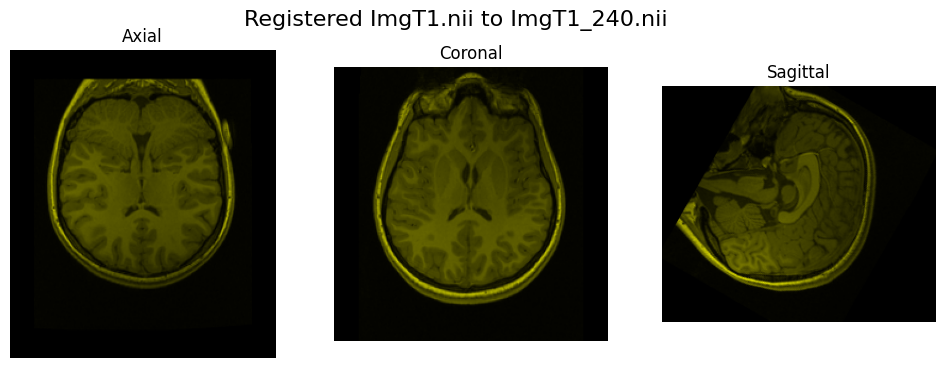

In [21]:
fixed_image = sitk.ReadImage(dir_in + 'ImgT1_240.nii')
moving_image = sitk.ReadImage(dir_in + 'ImgT1.nii')

# Set the registration method
R = sitk.ImageRegistrationMethod()
# Set the metric
R.SetMetricAsMeanSquares()

# Set the optimizer
R.SetOptimizerAsPowell(stepLength=10, numberOfIterations=25)

# Set the pyramid scheule
R.SetShrinkFactorsPerLevel(shrinkFactors = [2])
R.SetSmoothingSigmasPerLevel(smoothingSigmas=[0])
R.SmoothingSigmasAreSpecifiedInPhysicalUnitsOn()

# Set the sampling strategy
R.SetMetricSamplingStrategy(R.RANDOM)
R.SetMetricSamplingPercentage(0.20)

# Set the initial transform
R.SetInterpolator(sitk.sitkLinear)

# Some extra functions to help with the iteration
R.AddCommand(sitk.sitkIterationEvent, lambda: command_iteration(R))

# Set the initial transform 
initTransform =sitk.CenteredTransformInitializer(fixed_image, moving_image, sitk.Euler3DTransform(), sitk.CenteredTransformInitializerFilter.GEOMETRY)
R.SetInitialTransform(initTransform, inPlace=False)

# Execute the registration
tform_reg = R.Execute(fixed_image, moving_image)
tform_reg.WriteTransform(dir_in + 'Ex10_0.tfm')

params = tform_reg.GetParameters()
angles = params[:3]
print('Estimated rotation (deg) for ImgT1.nii: ')
print(np.round(np.rad2deg(angles), 3))

img_tmp = sitk.Resample(moving_image, tform_reg)
# imshow_orthogonal_view(img_tmp, title='Registered ImgT1.nii to ImgT1_240.nii')
overlay_slices(fixed_image, img_tmp, title='Registered ImgT1.nii to ImgT1_240.nii')

In [23]:
params = tform_reg.GetParameters()
angles = params[:3]
print(f'Estimated rotation (deg): ')
print(np.round(np.rad2deg(angles), 2))

Estimated rotation (deg): 
[-2040.    -0.     0.]


In [24]:
# Load the transforms from file
moving_image = sitk.ReadImage(dir_in + 'ImgT1.nii')

tform_60 = sitk.ReadTransform(dir_in + 'Ex9_60.tfm')
tform_180 = sitk.ReadTransform(dir_in + 'Ex9_180.tfm')
tform_240 = sitk.ReadTransform(dir_in + 'Ex9_240.tfm')
tform_0 = sitk.ReadTransform(dir_in + 'Ex10_0.tfm')

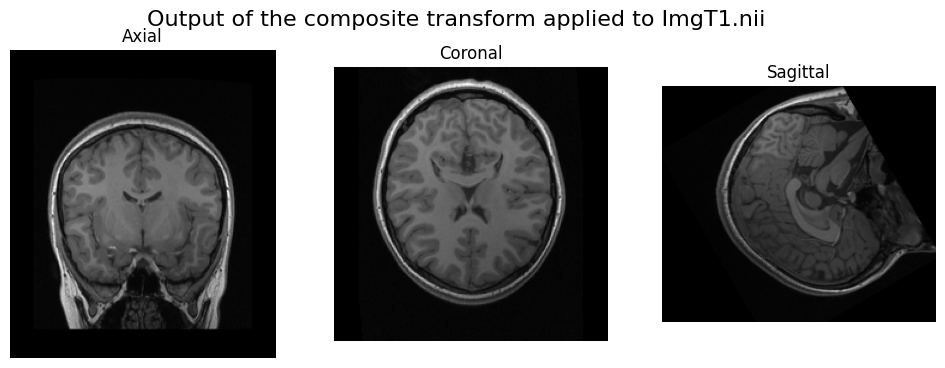

In [25]:
# Concatenate in an ITK way - The last added transform is applied first
tform_composite = sitk.CompositeTransform(3)

tform_composite.AddTransform(tform_240.GetNthTransform(0)) 
tform_composite.AddTransform(tform_180.GetNthTransform(0))
tform_composite.AddTransform(tform_60.GetNthTransform(0))
tform_composite.AddTransform(tform_0.GetNthTransform(0))

img_tmp = sitk.Resample(moving_image, tform_composite)
imshow_orthogonal_view(img_tmp, title='Output of the composite transform applied to ImgT1.nii')

In [26]:
def composite2affine(composite_transform, result_center=None):
    """
    Combine all of the composite transformation's contents to form an equivalent affine transformation.
    Args:
        composite_transform (SimpleITK.CompositeTransform): Input composite transform which contains only
                                                            global transformations, possibly nested.
        result_center (tuple,list): The desired center parameter for the resulting affine transformation.
                                    If None, then set to [0,...]. This can be any arbitrary value, as it is
                                    possible to change the transform center without changing the transformation
                                    effect.
    Returns:
        SimpleITK.AffineTransform: Affine transformation that has the same effect as the input composite_transform.
    
    Source:
        https://github.com/InsightSoftwareConsortium/SimpleITK-Notebooks/blob/master/Python/22_Transforms.ipynb
    """
    # Flatten the copy of the composite transform, so no nested composites.
    flattened_composite_transform = sitk.CompositeTransform(composite_transform)
    flattened_composite_transform.FlattenTransform()
    tx_dim = flattened_composite_transform.GetDimension()
    A = np.eye(tx_dim)
    c = np.zeros(tx_dim) if result_center is None else result_center
    t = np.zeros(tx_dim)
    for i in range(flattened_composite_transform.GetNumberOfTransforms() - 1, -1, -1):
        curr_tx = flattened_composite_transform.GetNthTransform(i).Downcast()
        # The TranslationTransform interface is different from other
        # global transformations.
        if curr_tx.GetTransformEnum() == sitk.sitkTranslation:
            A_curr = np.eye(tx_dim)
            t_curr = np.asarray(curr_tx.GetOffset())
            c_curr = np.zeros(tx_dim)
        else:
            A_curr = np.asarray(curr_tx.GetMatrix()).reshape(tx_dim, tx_dim)
            c_curr = np.asarray(curr_tx.GetCenter())
            # Some global transformations do not have a translation
            # (e.g. ScaleTransform, VersorTransform)
            get_translation = getattr(curr_tx, "GetTranslation", None)
            if get_translation is not None:
                t_curr = np.asarray(get_translation())
            else:
                t_curr = np.zeros(tx_dim)
        A = np.dot(A_curr, A)
        t = np.dot(A_curr, t + c - c_curr) + t_curr + c_curr - c

    return sitk.AffineTransform(A.flatten(), t, c)

In [27]:
affine_composite = composite2affine(tform_composite, centre_world)

# Since we are using just Euler transformations, we can map it to a rigid transform
euler_composite = sitk.Euler3DTransform()
euler_composite.SetMatrix(affine_composite.GetMatrix())
euler_composite.SetTranslation(affine_composite.GetTranslation())
euler_composite.SetCenter(affine_composite.GetCenter())

params = euler_composite.GetParameters()
angles = params[:3]

print(f'Estimated rotation (deg) for the composite transformation: ')
print(np.round(np.rad2deg(angles), 2))

print(f'Estimated homogeneous matrix: ')
print(np.round(homogeneous_matrix_from_transform(euler_composite),2))

Estimated rotation (deg) for the composite transformation: 
[-59.99 180.   180.  ]
Estimated homogeneous matrix: 
[[ 1.   -0.    0.   -0.  ]
 [-0.   -0.5   0.87  0.01]
 [-0.   -0.87 -0.5   0.  ]
 [ 0.    0.    0.    1.  ]]


Estimated rotation (deg) for the composite transformation: 
[-59.99 180.   180.  ]
Estimated homogeneous matrix: 
[[ 1.   -0.    0.   -0.  ]
 [-0.   -0.5   0.87  0.01]
 [-0.   -0.87 -0.5   0.  ]
 [ 0.    0.    0.    1.  ]]


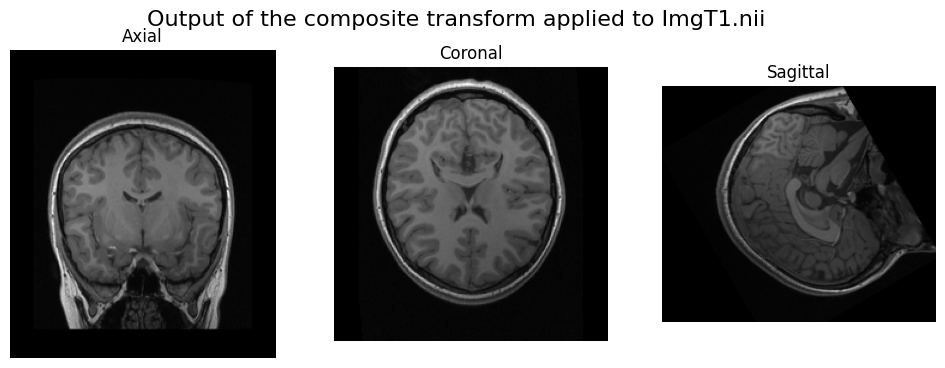

In [30]:
# Option B
A = np.eye(4)
for i in range(tform_composite.GetNumberOfTransforms()-1, -1, -1):
    tform = tform_composite.GetNthTransform(i)
    A_curr = homogeneous_matrix_from_transform(tform)
    A = np.dot(A_curr, A)

tform = sitk.Euler3DTransform()
tform.SetMatrix(A[:3,:3].flatten())
tform.SetTranslation(A[:3,3])
tform.SetCenter(centre_world)

out = sitk.Resample(moving_image, tform)
imshow_orthogonal_view(out, title='Output of the composite transform applied to ImgT1.nii')
params = tform.GetParameters()
angles = params[:3]
print(f'Estimated rotation (deg) for the composite transformation: ')
print(np.round(np.rad2deg(angles), 2))
print(f'Estimated homogeneous matrix: ')
print(np.round(homogeneous_matrix_from_transform(euler_composite),2))

In [ ]:
# The composite result is a rotation of -240 deg  or 120 deg
# But you may get a different values of rotation such as [-60, +-180, +-180], which is equivalent to [-240, 0, 0] deg.

## Robustness in the registration and number of iterations

If the moving image becomes too noisy the registration becomes unstable due to the appealingly many local minima in the cost function - in other words, there exist many sub-optimal solutions to the “optimal” affine matrix. In this case, the registration will be very sensitive to the selection of the hyperparameters such as the step length and the number of iterations. Moreover, depending on the optimizer the estimated affine matrix may be very unstable and will change significantly if we repeat the registration at the same noise level (This is not a critical issue for the Powell optimizer in this problem).

We can increase the noise level in an image by setting the noise standard deviation say to sigma = 200. We use a normal distributed random generator to generate the noise which is added to the image.

**Exercise 11**: Use the ImgT1.nii as the fixed image and ImgT1_240.nii as the moving image. Increase the noise level of the moving image and register it to the fixed image and repeat the registration at the same noise-level five times for different step length. At what sigma level does the affine matrix start becoming unstable? Show the ortho-views of the noisy moving image.

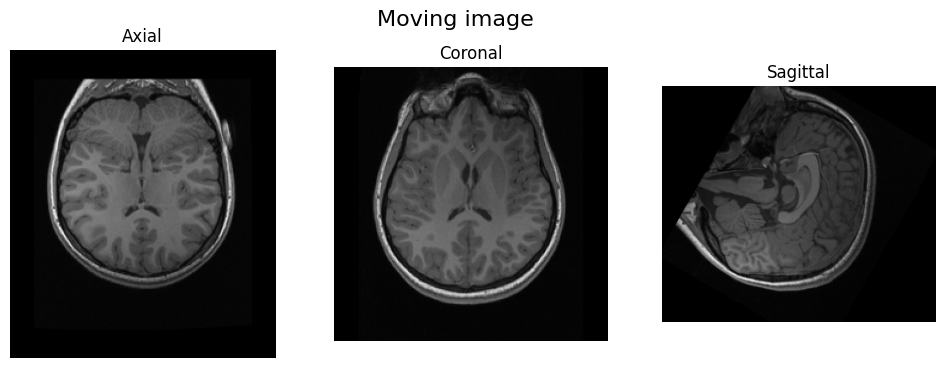

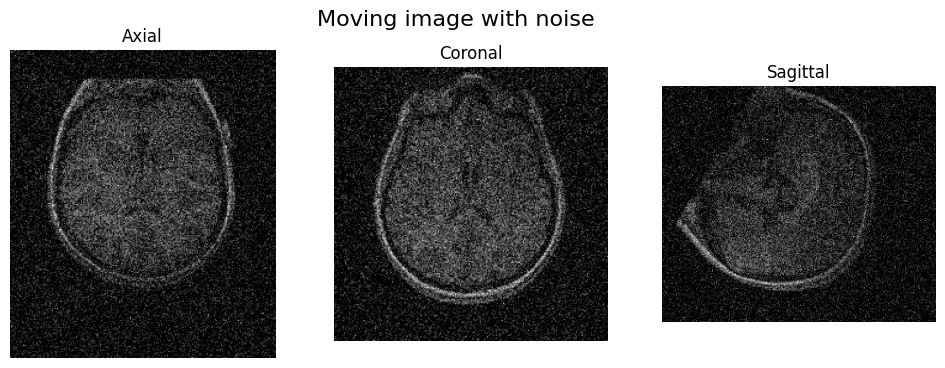

In [31]:
# Load the image
fixed_image = sitk.ReadImage(dir_in + 'ImgT1.nii')
moving_image = sitk.ReadImage(dir_in + 'ImgT1_240.nii')

# Add some noise to the moving image
moving_image_noisy = sitk.AdditiveGaussianNoise(moving_image, mean=0, standardDeviation=200)
imshow_orthogonal_view(moving_image, title='Moving image')
imshow_orthogonal_view(moving_image_noisy, title='Moving image with noise')

sitk.WriteImage(moving_image_noisy, 'ImgT1_240_noisy.nii')

  0 = 11804.91659 : (-117.29078169143335, 0.0021288028727918886, -0.000601511992412619, -0.041512904180104324, -0.2545542393881791, -0.18597111150210838)
  1 = 11801.09578 : (-58.64475973610212, 0.0006816321606143651, -0.0005545293575089673, -0.009604322629421715, -0.11052957602189972, -0.08954480279360905)
  2 = 11800.52606 : (-58.645075290909396, 0.0007771366708949068, -0.000566968288462706, -0.0092102323526893, -0.11889736192378875, -0.0896179073293313)
  3 = 11799.62668 : (-58.645075290909396, 0.0006446708945775532, -0.0006526474723720854, -0.014680093811183173, -0.11888326280064924, -0.07436267898214798)
  4 = 11798.77968 : (-58.64486045962338, 0.0005434558647277833, -0.0007398006605113363, -0.011933226151662679, -0.11884327130696949, -0.07783962039514888)
  5 = 11798.63228 : (-58.64502947479791, 0.0006440985650636831, -0.0006436500007390352, -0.012799734650106906, -0.11665108258145249, -0.08144165317009008)
  6 = 11798.47926 : (-58.64499867503215, 0.000641544273730053, -0.0006845

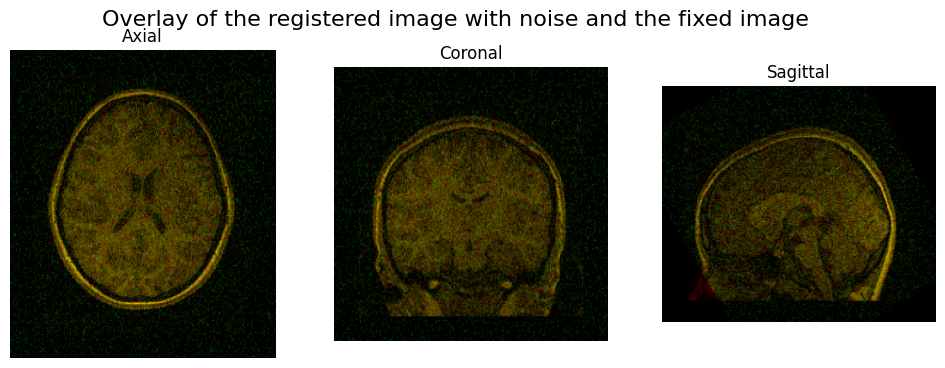

In [32]:
fixed_image = sitk.ReadImage(dir_in + 'ImgT1.nii')
moving_image = sitk.ReadImage(dir_in + 'ImgT1_240.nii')

noise_sigma = 200
moving_image_noisy = sitk.AdditiveGaussianNoise(moving_image, mean=0, standardDeviation=noise_sigma)

# Set the registration method
R = sitk.ImageRegistrationMethod()
# Set the metric
R.SetMetricAsMeanSquares()

# Set the optimizer
R.SetOptimizerAsPowell(stepLength=200, numberOfIterations=10)

# Set the sampling strategy
R.SetMetricSamplingStrategy(R.RANDOM)
R.SetMetricSamplingPercentage(0.10)

# Set the pyramid scheule
R.SetShrinkFactorsPerLevel(shrinkFactors = [2])
R.SetSmoothingSigmasPerLevel(smoothingSigmas=[0])
R.SmoothingSigmasAreSpecifiedInPhysicalUnitsOn()

# Set the initial transform
R.SetInterpolator(sitk.sitkLinear)

# Some extra functions to help with the iteration
R.AddCommand(sitk.sitkIterationEvent, lambda: command_iteration(R))

# Set the initial transform 
initTransform =sitk.CenteredTransformInitializer(fixed_image, moving_image_noisy, sitk.Euler3DTransform(), sitk.CenteredTransformInitializerFilter.GEOMETRY)
R.SetInitialTransform(initTransform, inPlace=False)

# Execute the registration
tform_reg = R.Execute(fixed_image, moving_image_noisy)

params = tform_reg.GetParameters()
angles = params[:3]
print('Estimated rotation (deg) for ImgT1.nii: ')
print(np.round(np.rad2deg(angles), 3))

img_tmp = sitk.Resample(moving_image_noisy, tform_reg)
overlay_slices(fixed_image, img_tmp, title='Overlay of the registered image with noise and the fixed image')

By using the pyramidal multi-resolution registration strategy, we can make the registration of the noisy moving image to the fixed image more robust. Here we use the Gaussian pyramid procedure where we keep the image resolution (i.e., the shrink factor) in the different steps of the pyramid but introduce blurring by using a Gaussian filter at different levels. At the highest level most blurring is added, and we only see the coarse details in the image to be registered. Then, we go to finer and finer levels of details by reducing the blurring factor. The pyramidal procedure is implemented in the registration function and typically three levels are used and we just set the sigma = [3.0, 1.0, 0.0].

**Exercise 12:** Register the noisy moving image using the pyramidal procedure. Try three levels of setting sigma=[3.0, 1.0, 0.0]. Repeat the registration procedure with different step lengths. Does the image registration become more insensitive to the step length? If not try increasing sigma=[5.0, 1.0, 0.0]. Can one use only 2 levels of the pyramid? What do you suggest of sigma values? Show the optimal affine matrices for each of the repeats to check robustness.

  0 =   36.21088 : (800.0590935266213, 0.00030774459555324175, 0.0, 0.007378628095686863, 0.027897056180509684, 0.004969285279086711)
  1 =   36.20417 : (400.0295564612077, 0.00015749315211088748, -0.00011470838542120725, 0.003912918027657623, 0.013395729144530284, 0.0024846426395433554)
  0 =  743.29974 : (400.0301249119927, 0.0004815275170473327, -0.00047279561472197507, 0.023070163241222765, -0.02209530129933205, 0.044133591216378276)
  1 =  743.26974 : (400.0298409399176, 0.0003195103345791101, -0.0006591567831457828, 0.01361730348311306, -0.012342836974657507, 0.023311052057504847)
  2 =  743.25708 : (400.02986810778697, 0.0003195103345791101, -0.0005182533332884255, 0.013635444957379688, -0.00847029411035312, 0.022021528915487053)
  0 = 11890.72139 : (400.0279711006158, 0.0003162341008671212, -0.00020383758838239975, 0.11853483204111523, -0.03791928730091603, -0.057668013343802164)
  1 = 11879.97350 : (400.02701903175677, 0.0002591689226481613, 0.0008135172380082541, 0.1711699923

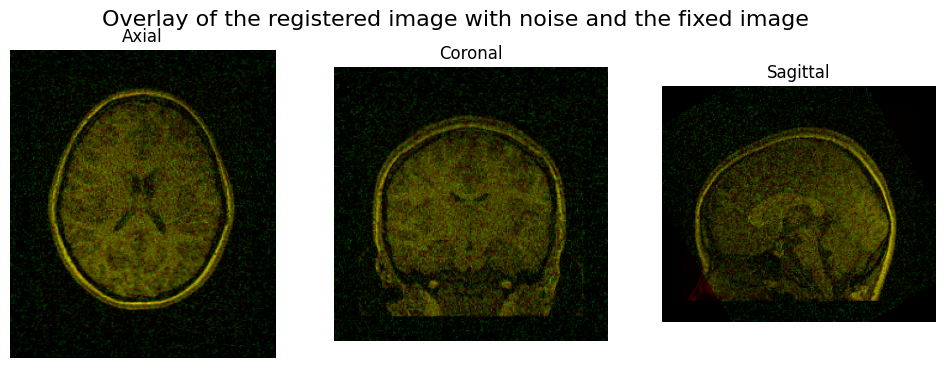

In [33]:
noise_sigma = 200
moving_image_noisy = sitk.AdditiveGaussianNoise(moving_image, mean=0, standardDeviation=noise_sigma)

# Set the registration method
R = sitk.ImageRegistrationMethod()
# Set the metric
R.SetMetricAsMeanSquares()

# Set the optimizer
R.SetOptimizerAsPowell(stepLength=200, numberOfIterations=10) # stepLength= 10, 50, 150, 200

# Set the sampling strategy
R.SetMetricSamplingStrategy(R.RANDOM)
R.SetMetricSamplingPercentage(0.10)

# Set the pyramid scheule
R.SetShrinkFactorsPerLevel(shrinkFactors = [2,2,2])
R.SetSmoothingSigmasPerLevel(smoothingSigmas=[3,1,0])
R.SmoothingSigmasAreSpecifiedInPhysicalUnitsOn()

# Set the initial transform
R.SetInterpolator(sitk.sitkLinear)

# Set the sampling strategy
R.SetMetricSamplingStrategy(R.RANDOM)
R.SetMetricSamplingPercentage(0.10)

# Some extra functions to help with the iteration
R.AddCommand(sitk.sitkIterationEvent, lambda: command_iteration(R))

# Set the initial transform
initTransform =sitk.CenteredTransformInitializer(fixed_image, moving_image_noisy, sitk.Euler3DTransform(), sitk.CenteredTransformInitializerFilter.GEOMETRY)
# initTransform = sitk.Euler3DTransform()
R.SetInitialTransform(initTransform, inPlace=False)

# Execute the registration
tform_reg = R.Execute(fixed_image, moving_image_noisy)

params = tform_reg.GetParameters()
angles = params[:3]
print('Estimated rotation (deg) for ImgT1.nii: ')
print(np.round(np.rad2deg(angles), 3))

img_tmp = sitk.Resample(moving_image_noisy, tform_reg)
overlay_slices(fixed_image, img_tmp, title='Overlay of the registered image with noise and the fixed image')